# Feature-Level UniFORM Normalization

In [41]:
import sys
sys.path.insert(0, '/home/workspace/UniFORM')  # or wherever you cloned it

# Now your imports should work
from UniFORM.preprocessing import (
    log_transform_intensities, 
    fit_two_component_gmm, 
    process_sample_distributions
)

## AnnData Version

In [42]:
# — Core preprocessing routines
from UniFORM.preprocessing import (
    log_transform_intensities, 
    fit_two_component_gmm, 
    process_sample_distributions
)

# — Registration / alignment
from UniFORM.registration import (
    correct_shifted_histograms, 
    plot_histogram_distributions, 
    compute_landmark_shifts, 
    compute_correlation_shifts, 
    automatic_registration
)

# — Landmark picking UI & finetuning
from UniFORM.landmark import (
    plot_distributions_plotly, 
    landmark_refinement
)

# — Core normalization step
from UniFORM.normalization import (
    plot_line_histogram, 
    plot_correlations_and_fit_line,
    plot_gmm, 
    calculate_shift_in_log_pixels, 
    generate_normalized_feature
)

# 1. Load Raw Data

In [43]:
import anndata as ad

# Specify the path to the saved AnnData file
dat_file = '/home/workspace/private/adata_02022026_postfilter.h5ad'

# Load the AnnData object
adata = ad.read_h5ad(dat_file)
adata

AnnData object with n_obs × n_vars = 3205576 × 53
    obs: 'cell_id', 'sample_id', 'Timeframe', 'batch_id', 'x', 'y', 'Outline Area (µm²)', 'Perimeter (µm)', 'Circularity'
    var: 'marker_name'
    layers: 'intensity_mean', 'intensity_median', 'intensity_std'

## Remove all cells that have NaN in any marker

In [44]:
import numpy as np

# Check how many cells have NaN before filtering
print(f"Cells before filtering: {adata.n_obs}")
print(f"Cells with any NaN: {np.sum(np.any(np.isnan(adata.X), axis=1))}")

# Filter out cells that have NaN in any marker
# Keep only cells where all markers are non-NaN
mask = ~np.any(np.isnan(adata.X), axis=1)
adata_filtered = adata[mask, :].copy()

print(f"Cells after filtering: {adata_filtered.n_obs}")
print(f"Cells removed: {adata.n_obs - adata_filtered.n_obs}")

Cells before filtering: 3205576
Cells with any NaN: 1058298
Cells after filtering: 2147278
Cells removed: 1058298


In [45]:
adata = adata_filtered

In [46]:
#change adata object to match UniFORM expectations
adata.obs = adata.obs.rename(columns={"sample": "sample_id"})
# LHn6_adata.var.index.name = "marker_name"
adata.var["marker_name"] = [
    f.replace("Mean Intensity - ", "mean_").replace("Median Intensity - ", "median_")
    for f in adata.var_names
]

adata.obs.head()

,cell_id,sample_id,Timeframe,batch_id,x,y,Outline Area (µm²),Perimeter (µm),Circularity
cell_id,,,,,,,,,
9347688.0_MS00000919_R0,9347688.0_MS00000919_R0,MS00000919_R0,0.0,MS00000919,3785.783594,490.238366,168.210336,74.075817,0.385221
9347689.0_MS00000919_R0,9347689.0_MS00000919_R0,MS00000919_R0,0.0,MS00000919,3783.180083,497.839384,197.627339,69.066160,0.520626
9347690.0_MS00000919_R0,9347690.0_MS00000919_R0,MS00000919_R0,0.0,MS00000919,3753.956841,533.547401,213.154447,59.250758,0.762986
9347691.0_MS00000919_R0,9347691.0_MS00000919_R0,MS00000919_R0,0.0,MS00000919,3747.007058,571.247088,142.173383,50.058301,0.712978
9347692.0_MS00000919_R0,9347692.0_MS00000919_R0,MS00000919_R0,0.0,MS00000919,3719.147620,600.285175,195.620434,59.250758,0.700223


### Remove redundant markers

In [48]:
# See current markers
print(adata.var['marker_name'].values)

# Remove a single marker
adata = adata[:, adata.var['marker_name'] != 'DAPI_R14'].copy()

['PanCytokAE1AE3AF488' 'p-c-Jun-D47G9AF555' 'CD207-7430AF647'
 'CD1c-OTI2F4AF750' 'PDPN-LpMab-12AF488' 'pmTORS2448-49F9AF555'
 'FoxP3-D2W8EAF647' 'EphB2-D2X2IAF750' 'Periostin-E5F2SAF488'
 'p-NF-kB-178F3AF555' 'Ki67-D2H10AF647' 'CD209-1781AF750'
 'CD90-E3V8AAF488' 'IRF-8-E6J8QAF555' 'IL-1beta-3A6AF647'
 'CD103-3904RAF750' 'SOD2-D3X8FAF488' 'p-p38MAPK-D3F9AF647'
 'PU1-2146AF750' 'S100A12-OTI1D1AF488' 'MMP-9-D6O3HAF555'
 'CD11c-D3V1EAF647' 'PD-1-D4W2JAF750' 'IDO-D5J4EAF488' 'YKL-40-E2L1MAF555'
 'IRF-1-D5E4AF647' 'IFITM3-D8E8GAF750' 'CD7-E4G1QAF488' 'GITR-D5V7PAF555'
 'pSTAT1Ty70158D6AF647' 'IRF-4-E8H3SAF750' 'CD14-D7A2TAF488'
 'T-bet-E4I2KAF555' 'pSTAT1s727-D3B7AF647' 'ClvCasp-3-58A1EAF750'
 'SMA-1A4AF488' 'NAkATPaseEP1845Y555' 'HLADR-LN3AF647'
 'CD452B11PD726AF750' 'CD4EPR6855AF555' 'CD20-E7B7TAF647'
 'CD16-DJ130cAF750' 'CD27-EPR8569AF555' 'CD3d-EP4426AF647'
 'CD8a-c8144BAF750' 'CD68-KP1AF555' 'TCR-delta-E2E9TAF647'
 'CD15-MC480AF750' 'ECadherin-24E10AF488' 'TIM-3-D5D5RAF555'
 'MUC2-CCP

# 2. Perform histogram calculation

Markers:   0%|          | 0/52 [00:00<?, ?it/s]

✅ Processing MS00000919_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000919_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000921_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000921_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000923_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000923_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000925_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000925_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000931_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000931_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000933_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000933_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000935_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000935_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000937_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000937_R1 for marker Pa

Markers:   2%|▏         | 1/52 [00:05<04:27,  5.25s/it]

✅ Processing MS00000919_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000919_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000921_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000921_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000923_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000923_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000925_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000925_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000931_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000931_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000933_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000933_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000935_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000935_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000937_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000937_R1 for marker p-c-Jun-D47G9AF55

Markers:   4%|▍         | 2/52 [00:17<07:40,  9.20s/it]

✅ Processing MS00000919_R0 for marker CD207-7430AF647......
✅ Processing MS00000919_R1 for marker CD207-7430AF647......
✅ Processing MS00000921_R0 for marker CD207-7430AF647......
✅ Processing MS00000921_R1 for marker CD207-7430AF647......
✅ Processing MS00000923_R0 for marker CD207-7430AF647......
✅ Processing MS00000923_R1 for marker CD207-7430AF647......
✅ Processing MS00000925_R0 for marker CD207-7430AF647......
✅ Processing MS00000925_R1 for marker CD207-7430AF647......
✅ Processing MS00000931_R0 for marker CD207-7430AF647......
✅ Processing MS00000931_R1 for marker CD207-7430AF647......
✅ Processing MS00000933_R0 for marker CD207-7430AF647......
✅ Processing MS00000933_R1 for marker CD207-7430AF647......
✅ Processing MS00000935_R0 for marker CD207-7430AF647......
✅ Processing MS00000935_R1 for marker CD207-7430AF647......
✅ Processing MS00000937_R0 for marker CD207-7430AF647......
✅ Processing MS00000937_R1 for marker CD207-7430AF647......
✅ Processing MS00000939_R0 for marker CD

Markers:   6%|▌         | 3/52 [00:30<09:13, 11.29s/it]

✅ Processing MS00000919_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000919_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000921_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000921_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000923_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000923_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000925_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000925_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000931_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000931_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000933_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000933_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000935_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000935_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000937_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000937_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000939_

Markers:   8%|▊         | 4/52 [00:45<09:58, 12.48s/it]

✅ Processing MS00000919_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000919_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000921_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000921_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000923_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000923_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000925_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000925_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000931_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000931_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000933_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000933_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000935_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000935_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000937_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000937_R1 for marker PDPN-LpMab-12AF48

Markers:  10%|▉         | 5/52 [00:54<08:55, 11.39s/it]

✅ Processing MS00000919_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000919_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000921_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000921_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000923_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000923_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000925_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000925_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000931_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000931_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000933_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000933_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000935_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000935_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000937_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000937_R

Markers:  12%|█▏        | 6/52 [01:10<09:55, 12.94s/it]

✅ Processing MS00000919_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000919_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000921_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000921_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000923_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000923_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000925_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000925_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000931_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000931_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000933_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000933_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000935_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000935_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000937_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000937_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000939_

Markers:  13%|█▎        | 7/52 [01:21<09:09, 12.21s/it]

✅ Processing MS00000919_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000919_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000921_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000921_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000923_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000923_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000925_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000925_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000931_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000931_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000933_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000933_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000935_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000935_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000937_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000937_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000939_

Markers:  15%|█▌        | 8/52 [01:33<08:54, 12.14s/it]

✅ Processing MS00000919_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000919_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000921_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000921_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000923_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000923_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000925_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000925_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000931_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000931_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000933_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000933_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000935_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000935_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000937_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000937_R

Markers:  17%|█▋        | 9/52 [01:39<07:19, 10.21s/it]

✅ Processing MS00000919_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000919_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000921_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000921_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000923_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000923_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000925_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000925_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000931_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000931_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000933_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000933_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000935_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000935_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000937_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000937_R1 for marker p-NF-kB-178F3AF55

Markers:  19%|█▉        | 10/52 [01:48<06:49,  9.74s/it]

✅ Processing MS00000919_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000919_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000921_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000921_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000923_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000923_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000925_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000925_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000931_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000931_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000933_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000933_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000935_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000935_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000937_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000937_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000939_R0 for marker Ki

Markers:  21%|██        | 11/52 [01:55<06:04,  8.89s/it]

✅ Processing MS00000919_R0 for marker CD209-1781AF750......
✅ Processing MS00000919_R1 for marker CD209-1781AF750......
✅ Processing MS00000921_R0 for marker CD209-1781AF750......
✅ Processing MS00000921_R1 for marker CD209-1781AF750......
✅ Processing MS00000923_R0 for marker CD209-1781AF750......
✅ Processing MS00000923_R1 for marker CD209-1781AF750......
✅ Processing MS00000925_R0 for marker CD209-1781AF750......
✅ Processing MS00000925_R1 for marker CD209-1781AF750......
✅ Processing MS00000931_R0 for marker CD209-1781AF750......
✅ Processing MS00000931_R1 for marker CD209-1781AF750......
✅ Processing MS00000933_R0 for marker CD209-1781AF750......
✅ Processing MS00000933_R1 for marker CD209-1781AF750......
✅ Processing MS00000935_R0 for marker CD209-1781AF750......
✅ Processing MS00000935_R1 for marker CD209-1781AF750......
✅ Processing MS00000937_R0 for marker CD209-1781AF750......
✅ Processing MS00000937_R1 for marker CD209-1781AF750......
✅ Processing MS00000939_R0 for marker CD

Markers:  23%|██▎       | 12/52 [02:05<06:10,  9.27s/it]

✅ Processing MS00000919_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000919_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000921_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000921_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000923_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000923_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000925_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000925_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000931_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000931_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000933_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000933_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000935_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000935_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000937_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000937_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000939_R0 for marker CD

Markers:  25%|██▌       | 13/52 [02:13<05:46,  8.88s/it]

✅ Processing MS00000919_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000919_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000921_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000921_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000923_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000923_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000925_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000925_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000931_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000931_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000933_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000933_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000935_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000935_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000937_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000937_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000939_

Markers:  27%|██▋       | 14/52 [02:23<05:59,  9.46s/it]

✅ Processing MS00000919_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000919_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000921_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000921_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000923_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000923_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000925_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000925_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000931_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000931_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000933_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000933_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000935_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000935_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000937_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000937_R1 for marker IL-1beta-3A6AF647......
✅ Proces

Markers:  29%|██▉       | 15/52 [02:34<06:01,  9.78s/it]

✅ Processing MS00000919_R0 for marker CD103-3904RAF750......
✅ Processing MS00000919_R1 for marker CD103-3904RAF750......
✅ Processing MS00000921_R0 for marker CD103-3904RAF750......
✅ Processing MS00000921_R1 for marker CD103-3904RAF750......
✅ Processing MS00000923_R0 for marker CD103-3904RAF750......
✅ Processing MS00000923_R1 for marker CD103-3904RAF750......
✅ Processing MS00000925_R0 for marker CD103-3904RAF750......
✅ Processing MS00000925_R1 for marker CD103-3904RAF750......
✅ Processing MS00000931_R0 for marker CD103-3904RAF750......
✅ Processing MS00000931_R1 for marker CD103-3904RAF750......
✅ Processing MS00000933_R0 for marker CD103-3904RAF750......
✅ Processing MS00000933_R1 for marker CD103-3904RAF750......
✅ Processing MS00000935_R0 for marker CD103-3904RAF750......
✅ Processing MS00000935_R1 for marker CD103-3904RAF750......
✅ Processing MS00000937_R0 for marker CD103-3904RAF750......
✅ Processing MS00000937_R1 for marker CD103-3904RAF750......
✅ Processing MS00000939_

Markers:  31%|███       | 16/52 [02:45<06:01, 10.03s/it]

✅ Processing MS00000919_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000919_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000921_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000921_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000923_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000923_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000925_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000925_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000931_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000931_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000933_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000933_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000935_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000935_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000937_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000937_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000939_R0 for marker SO

Markers:  33%|███▎      | 17/52 [02:55<05:59, 10.27s/it]

✅ Processing MS00000919_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000919_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000921_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000921_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000923_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000923_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000925_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000925_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000931_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000931_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000933_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000933_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000935_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000935_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000937_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000937_R1 for marker p-

Markers:  35%|███▍      | 18/52 [03:07<06:04, 10.72s/it]

✅ Processing MS00000919_R0 for marker PU1-2146AF750......
✅ Processing MS00000919_R1 for marker PU1-2146AF750......
✅ Processing MS00000921_R0 for marker PU1-2146AF750......
✅ Processing MS00000921_R1 for marker PU1-2146AF750......
✅ Processing MS00000923_R0 for marker PU1-2146AF750......
✅ Processing MS00000923_R1 for marker PU1-2146AF750......
✅ Processing MS00000925_R0 for marker PU1-2146AF750......
✅ Processing MS00000925_R1 for marker PU1-2146AF750......
✅ Processing MS00000931_R0 for marker PU1-2146AF750......
✅ Processing MS00000931_R1 for marker PU1-2146AF750......
✅ Processing MS00000933_R0 for marker PU1-2146AF750......
✅ Processing MS00000933_R1 for marker PU1-2146AF750......
✅ Processing MS00000935_R0 for marker PU1-2146AF750......
✅ Processing MS00000935_R1 for marker PU1-2146AF750......
✅ Processing MS00000937_R0 for marker PU1-2146AF750......
✅ Processing MS00000937_R1 for marker PU1-2146AF750......
✅ Processing MS00000939_R0 for marker PU1-2146AF750......
✅ Processing M

Markers:  37%|███▋      | 19/52 [03:22<06:36, 12.01s/it]

✅ Processing MS00000919_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000919_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000921_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000921_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000923_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000923_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000925_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000925_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000931_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000931_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000933_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000933_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000935_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000935_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000937_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000937_R1 for marker S1

Markers:  38%|███▊      | 20/52 [03:28<05:24, 10.13s/it]

✅ Processing MS00000919_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000919_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000921_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000921_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000923_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000923_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000925_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000925_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000931_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000931_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000933_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000933_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000935_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000935_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000937_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000937_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000939_

Markers:  40%|████      | 21/52 [03:36<04:59,  9.65s/it]

✅ Processing MS00000919_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000919_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000921_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000921_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000923_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000923_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000925_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000925_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000931_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000931_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000933_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000933_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000935_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000935_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000937_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000937_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000939_

Markers:  42%|████▏     | 22/52 [03:47<04:59,  9.97s/it]

✅ Processing MS00000919_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000919_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000921_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000921_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000923_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000923_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000925_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000925_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000931_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000931_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000933_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000933_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000935_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000935_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000937_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000937_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000939_R0 for marker PD

Markers:  44%|████▍     | 23/52 [03:59<05:09, 10.68s/it]

✅ Processing MS00000919_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000919_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000921_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000921_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000923_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000923_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000925_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000925_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000931_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000931_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000933_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000933_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000935_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000935_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000937_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000937_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000939_R0 for marker IDO-D5J4EAF488....

Markers:  46%|████▌     | 24/52 [04:06<04:25,  9.48s/it]

✅ Processing MS00000919_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000919_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000921_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000921_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000923_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000923_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000925_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000925_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000931_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000931_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000933_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000933_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000935_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000935_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000937_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000937_R1 for marker YKL-40-E2L1MAF555......
✅ Proces

Markers:  48%|████▊     | 25/52 [04:14<04:02,  8.98s/it]

✅ Processing MS00000919_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000919_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000921_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000921_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000923_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000923_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000925_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000925_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000931_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000931_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000933_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000933_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000935_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000935_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000937_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000937_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000939_R0 for marker IR

Markers:  50%|█████     | 26/52 [04:25<04:09,  9.61s/it]

✅ Processing MS00000919_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000919_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000921_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000921_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000923_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000923_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000925_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000925_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000931_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000931_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000933_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000933_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000935_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000935_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000937_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000937_R1 for marker IFITM3-D8E8GAF750......
✅ Proces

Markers:  52%|█████▏    | 27/52 [04:38<04:23, 10.53s/it]

✅ Processing MS00000919_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000919_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000921_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000921_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000923_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000923_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000925_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000925_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000931_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000931_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000933_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000933_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000935_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000935_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000937_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000937_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000939_R0 for marker CD7-E4G1QAF488....

Markers:  54%|█████▍    | 28/52 [04:44<03:38,  9.12s/it]

✅ Processing MS00000919_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000919_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000921_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000921_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000923_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000923_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000925_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000925_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000931_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000931_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000933_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000933_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000935_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000935_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000937_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000937_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000939_R0 for marker GI

Markers:  56%|█████▌    | 29/52 [04:54<03:37,  9.46s/it]

✅ Processing MS00000919_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000919_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000921_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000921_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000923_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000923_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000925_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000925_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000931_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000931_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000933_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000933_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000935_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000935_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000937_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000937_R

Markers:  58%|█████▊    | 30/52 [05:08<04:00, 10.91s/it]

✅ Processing MS00000919_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000919_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000921_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000921_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000923_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000923_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000925_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000925_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000931_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000931_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000933_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000933_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000935_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000935_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000937_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000937_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000939_

Markers:  60%|█████▉    | 31/52 [05:20<03:52, 11.06s/it]

✅ Processing MS00000919_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000919_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000921_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000921_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000923_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000923_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000925_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000925_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000931_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000931_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000933_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000933_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000935_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000935_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000937_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000937_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000939_R0 for marker CD

Markers:  62%|██████▏   | 32/52 [05:27<03:20, 10.01s/it]

✅ Processing MS00000919_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000919_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000921_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000921_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000923_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000923_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000925_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000925_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000931_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000931_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000933_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000933_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000935_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000935_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000937_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000937_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000939_

Markers:  63%|██████▎   | 33/52 [05:38<03:12, 10.16s/it]

✅ Processing MS00000919_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000919_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000921_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000921_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000923_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000923_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000925_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000925_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000931_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000931_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000933_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000933_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000935_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000935_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000937_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000937_R

Markers:  65%|██████▌   | 34/52 [05:49<03:12, 10.68s/it]

✅ Processing MS00000919_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000919_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000921_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000921_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000923_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000923_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000925_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000925_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000931_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000931_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000933_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000933_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000935_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000935_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000937_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000937_R

Markers:  67%|██████▋   | 35/52 [06:03<03:14, 11.46s/it]

✅ Processing MS00000919_R0 for marker SMA-1A4AF488......
✅ Processing MS00000919_R1 for marker SMA-1A4AF488......
✅ Processing MS00000921_R0 for marker SMA-1A4AF488......
✅ Processing MS00000921_R1 for marker SMA-1A4AF488......
✅ Processing MS00000923_R0 for marker SMA-1A4AF488......
✅ Processing MS00000923_R1 for marker SMA-1A4AF488......
✅ Processing MS00000925_R0 for marker SMA-1A4AF488......
✅ Processing MS00000925_R1 for marker SMA-1A4AF488......
✅ Processing MS00000931_R0 for marker SMA-1A4AF488......
✅ Processing MS00000931_R1 for marker SMA-1A4AF488......
✅ Processing MS00000933_R0 for marker SMA-1A4AF488......
✅ Processing MS00000933_R1 for marker SMA-1A4AF488......
✅ Processing MS00000935_R0 for marker SMA-1A4AF488......
✅ Processing MS00000935_R1 for marker SMA-1A4AF488......
✅ Processing MS00000937_R0 for marker SMA-1A4AF488......
✅ Processing MS00000937_R1 for marker SMA-1A4AF488......
✅ Processing MS00000939_R0 for marker SMA-1A4AF488......
✅ Processing MS00000939_R1 for 

Markers:  69%|██████▉   | 36/52 [06:14<03:03, 11.48s/it]

✅ Processing MS00000919_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000919_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000921_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000921_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000923_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000923_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000925_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000925_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000931_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000931_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000933_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000933_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000935_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000935_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000937_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000937_R1 for marker NA

Markers:  71%|███████   | 37/52 [06:21<02:31, 10.11s/it]

✅ Processing MS00000919_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000919_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000921_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000921_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000923_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000923_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000925_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000925_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000931_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000931_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000933_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000933_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000935_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000935_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000937_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000937_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000939_R0 for marker HLADR-LN3AF647....

Markers:  73%|███████▎  | 38/52 [06:32<02:24, 10.32s/it]

✅ Processing MS00000919_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000919_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000921_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000921_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000923_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000923_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000925_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000925_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000931_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000931_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000933_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000933_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000935_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000935_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000937_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000937_R1 for marker CD452B11PD726AF75

Markers:  75%|███████▌  | 39/52 [06:42<02:14, 10.32s/it]

✅ Processing MS00000919_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000919_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000921_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000921_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000923_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000923_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000925_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000925_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000931_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000931_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000933_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000933_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000935_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000935_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000937_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000937_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000939_R0 for marker CD

Markers:  77%|███████▋  | 40/52 [06:52<02:00, 10.02s/it]

✅ Processing MS00000919_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000919_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000921_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000921_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000923_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000923_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000925_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000925_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000931_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000931_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000933_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000933_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000935_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000935_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000937_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000937_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000939_R0 for marker CD

Markers:  79%|███████▉  | 41/52 [07:01<01:47,  9.78s/it]

✅ Processing MS00000919_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000919_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000921_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000921_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000923_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000923_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000925_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000925_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000931_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000931_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000933_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000933_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000935_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000935_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000937_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000937_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000939_

Markers:  81%|████████  | 42/52 [07:12<01:41, 10.14s/it]

✅ Processing MS00000919_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000919_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000921_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000921_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000923_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000923_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000925_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000925_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000931_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000931_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000933_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000933_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000935_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000935_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000937_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000937_R1 for marker CD27-EPR8569AF555......
✅ Proces

Markers:  83%|████████▎ | 43/52 [07:22<01:32, 10.29s/it]

✅ Processing MS00000919_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000919_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000921_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000921_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000923_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000923_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000925_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000925_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000931_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000931_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000933_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000933_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000935_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000935_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000937_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000937_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000939_

Markers:  85%|████████▍ | 44/52 [07:32<01:21, 10.14s/it]

✅ Processing MS00000919_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000919_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000921_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000921_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000923_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000923_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000925_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000925_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000931_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000931_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000933_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000933_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000935_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000935_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000937_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000937_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000939_

Markers:  87%|████████▋ | 45/52 [07:42<01:09,  9.98s/it]

✅ Processing MS00000919_R0 for marker CD68-KP1AF555......
✅ Processing MS00000919_R1 for marker CD68-KP1AF555......
✅ Processing MS00000921_R0 for marker CD68-KP1AF555......
✅ Processing MS00000921_R1 for marker CD68-KP1AF555......
✅ Processing MS00000923_R0 for marker CD68-KP1AF555......
✅ Processing MS00000923_R1 for marker CD68-KP1AF555......
✅ Processing MS00000925_R0 for marker CD68-KP1AF555......
✅ Processing MS00000925_R1 for marker CD68-KP1AF555......
✅ Processing MS00000931_R0 for marker CD68-KP1AF555......
✅ Processing MS00000931_R1 for marker CD68-KP1AF555......
✅ Processing MS00000933_R0 for marker CD68-KP1AF555......
✅ Processing MS00000933_R1 for marker CD68-KP1AF555......
✅ Processing MS00000935_R0 for marker CD68-KP1AF555......
✅ Processing MS00000935_R1 for marker CD68-KP1AF555......
✅ Processing MS00000937_R0 for marker CD68-KP1AF555......
✅ Processing MS00000937_R1 for marker CD68-KP1AF555......
✅ Processing MS00000939_R0 for marker CD68-KP1AF555......
✅ Processing M

Markers:  88%|████████▊ | 46/52 [07:51<00:58,  9.82s/it]

✅ Processing MS00000919_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000919_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000921_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000921_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000923_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000923_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000925_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000925_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000931_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000931_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000933_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000933_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000935_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000935_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000937_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000937_R

Markers:  90%|█████████ | 47/52 [08:00<00:47,  9.55s/it]

✅ Processing MS00000919_R0 for marker CD15-MC480AF750......
✅ Processing MS00000919_R1 for marker CD15-MC480AF750......
✅ Processing MS00000921_R0 for marker CD15-MC480AF750......
✅ Processing MS00000921_R1 for marker CD15-MC480AF750......
✅ Processing MS00000923_R0 for marker CD15-MC480AF750......
✅ Processing MS00000923_R1 for marker CD15-MC480AF750......
✅ Processing MS00000925_R0 for marker CD15-MC480AF750......
✅ Processing MS00000925_R1 for marker CD15-MC480AF750......
✅ Processing MS00000931_R0 for marker CD15-MC480AF750......
✅ Processing MS00000931_R1 for marker CD15-MC480AF750......
✅ Processing MS00000933_R0 for marker CD15-MC480AF750......
✅ Processing MS00000933_R1 for marker CD15-MC480AF750......
✅ Processing MS00000935_R0 for marker CD15-MC480AF750......
✅ Processing MS00000935_R1 for marker CD15-MC480AF750......
✅ Processing MS00000937_R0 for marker CD15-MC480AF750......
✅ Processing MS00000937_R1 for marker CD15-MC480AF750......
✅ Processing MS00000939_R0 for marker CD

Markers:  92%|█████████▏| 48/52 [08:10<00:37,  9.48s/it]

✅ Processing MS00000919_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000919_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000921_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000921_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000923_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000923_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000925_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000925_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000931_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000931_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000933_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000933_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000935_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000935_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000937_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000937_R

Markers:  94%|█████████▍| 49/52 [08:21<00:29,  9.93s/it]

✅ Processing MS00000919_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000919_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000921_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000921_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000923_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000923_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000925_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000925_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000931_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000931_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000933_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000933_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000935_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000935_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000937_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000937_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000939_

Markers:  96%|█████████▌| 50/52 [08:30<00:19,  9.77s/it]

✅ Processing MS00000919_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000919_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000921_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000921_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000923_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000923_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000925_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000925_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000931_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000931_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000933_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000933_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000935_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000935_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000937_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000937_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000939_R0 for marker MU

Markers:  98%|█████████▊| 51/52 [08:43<00:10, 10.89s/it]

✅ Processing MS00000919_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000919_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000921_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000921_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000923_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000923_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000925_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000925_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000931_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000931_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000933_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000933_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000935_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000935_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000937_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000937_R

Markers: 100%|██████████| 52/52 [08:54<00:00, 10.29s/it]


✅ Saved summary figure to: LHn6_feature_histogram_distributions.png


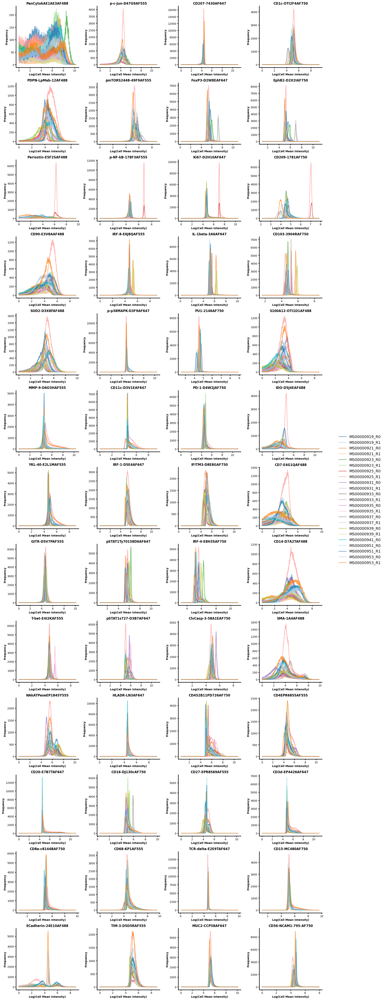

In [49]:
intensity_ranges, histograms, gmm_models = process_sample_distributions(
    feature_input       = adata,
    num_bins            = 1024,
    plots_per_row       = 4,
    dpi                 = 100,
    xlims               = None,
    ylims               = None,
    output_figure_path  = "LHn6_feature_histogram_distributions.png",
    verbose=True
)

# 3. Perform automatic rigid landmark data registration to align marker distribution


-------------------- Processing marker 'PanCytokAE1AE3AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [-54, -79, -26, -24, 79, 40, 0, -30, -11, 46, 1, -2, -5, 65, -50, 0, -44, -10, 1, -84, -2, -3, 26]
✨ Auto-computed reference landmark for 'PanCytokAE1AE3AF488' on 'MS00000925_R0': 603
✨ Implied landmark positions for 'PanCytokAE1AE3AF488': [549, 524, 577, 579, 682, 643, 603, 573, 592, 649, 604, 601, 598, 668, 553, 603, 559, 593, 604, 519, 601, 600, 629]


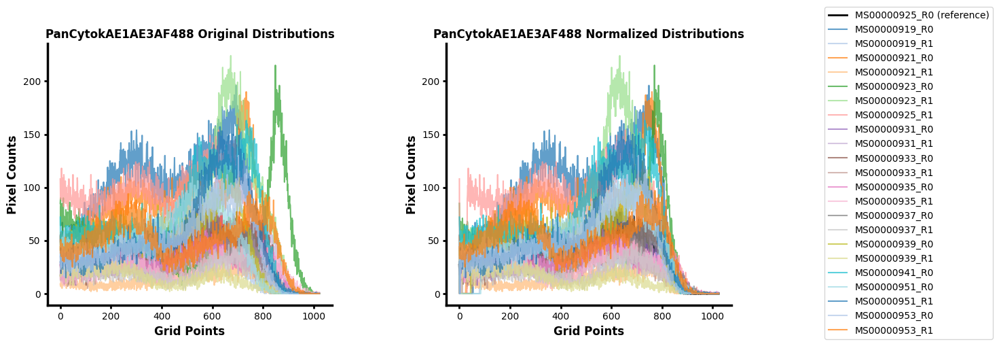


-------------------- Processing marker 'p-c-Jun-D47G9AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [3, -28, 17, 1, 30, 0, -59, 11, 21, -4, 5, 33, -54, -14, -29, -7, -20, -16, 9, -4, -18, -11, -9]
✨ Auto-computed reference landmark for 'p-c-Jun-D47G9AF555' on 'MS00000923_R1': 404
✨ Implied landmark positions for 'p-c-Jun-D47G9AF555': [407, 376, 421, 405, 434, 404, 345, 415, 425, 400, 409, 437, 350, 390, 375, 397, 384, 388, 413, 400, 386, 393, 395]


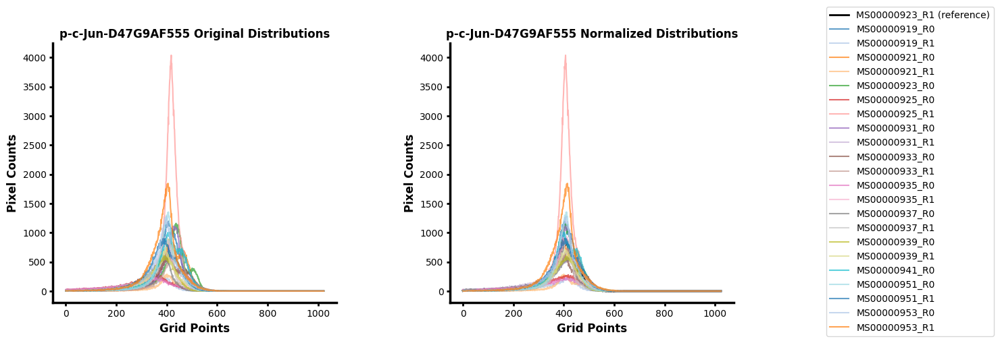


-------------------- Processing marker 'CD207-7430AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [-11, -18, -3, -3, 2, -3, -23, -6, 5, 0, 0, 5, -15, -4, -8, 1, -24, -18, -3, -20, -21, 1, 1]
✨ Auto-computed reference landmark for 'CD207-7430AF647' on 'MS00000931_R1': 417
✨ Implied landmark positions for 'CD207-7430AF647': [406, 399, 414, 414, 419, 414, 394, 411, 422, 417, 417, 422, 402, 413, 409, 418, 393, 399, 414, 397, 396, 418, 418]


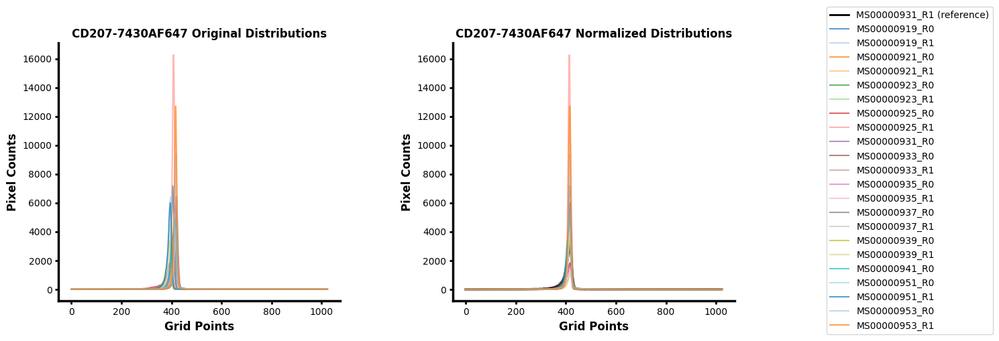


-------------------- Processing marker 'CD1c-OTI2F4AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R1' by histogram proximity 

✨ Computed shifts: [0, -7, -37, -49, 9, -19, -14, 4, 11, 0, 14, 21, -8, 0, -96, -82, -25, -21, -15, -37, -30, 0, 8]
✨ Auto-computed reference landmark for 'CD1c-OTI2F4AF750' on 'MS00000935_R1': 561
✨ Implied landmark positions for 'CD1c-OTI2F4AF750': [561, 554, 524, 512, 570, 542, 547, 565, 572, 561, 575, 582, 553, 561, 465, 479, 536, 540, 546, 524, 531, 561, 569]


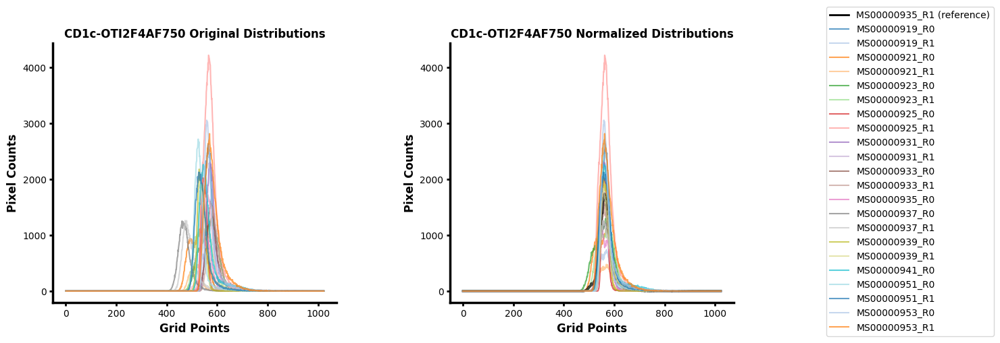


-------------------- Processing marker 'PDPN-LpMab-12AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-22, -31, -42, 0, 52, -56, -74, 68, 67, -11, -17, 21, -50, 39, 40, 81, -97, 0, 12, 28, 34, -7, 34]
✨ Auto-computed reference landmark for 'PDPN-LpMab-12AF488' on 'MS00000939_R1': 508
✨ Implied landmark positions for 'PDPN-LpMab-12AF488': [486, 477, 466, 508, 560, 452, 434, 576, 575, 497, 491, 529, 458, 547, 548, 589, 411, 508, 520, 536, 542, 501, 542]


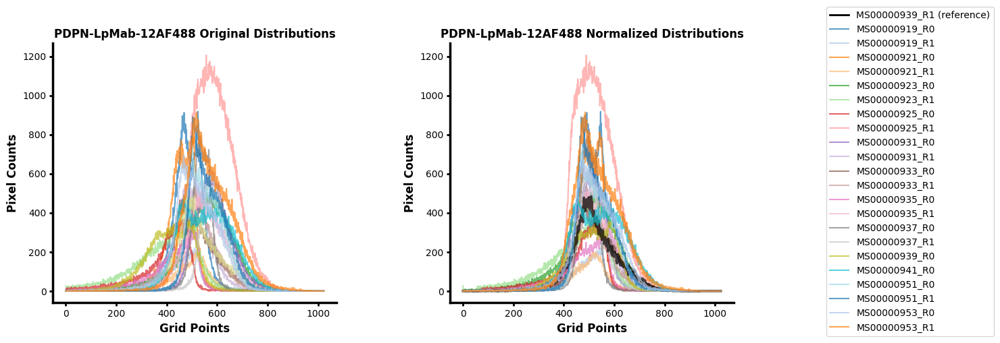


-------------------- Processing marker 'pmTORS2448-49F9AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [26, 3, -16, -12, 37, 30, -18, 11, 65, 27, 0, 11, -23, -13, 70, 61, -25, -18, 14, 3, 9, -15, -10]
✨ Auto-computed reference landmark for 'pmTORS2448-49F9AF555' on 'MS00000933_R0': 603
✨ Implied landmark positions for 'pmTORS2448-49F9AF555': [629, 606, 587, 591, 640, 633, 585, 614, 668, 630, 603, 614, 580, 590, 673, 664, 578, 585, 617, 606, 612, 588, 593]


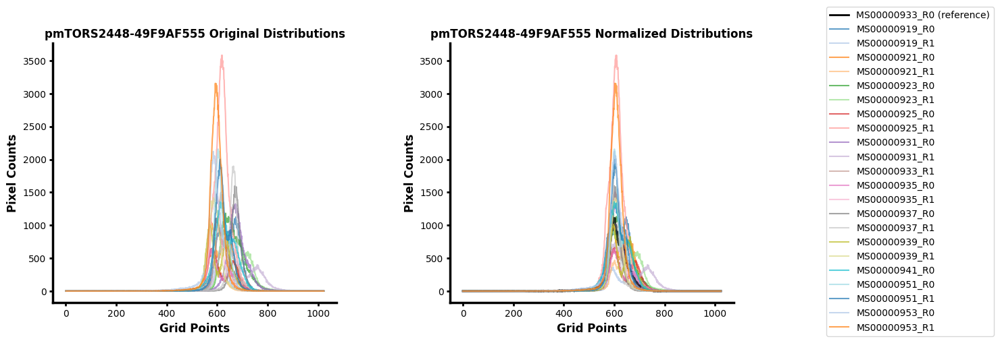


-------------------- Processing marker 'FoxP3-D2W8EAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [41, 35, -17, -21, 61, 55, -1, 8, 24, 0, 17, 27, -25, -23, 182, 180, -14, 3, -17, 22, 22, -18, -10]
✨ Auto-computed reference landmark for 'FoxP3-D2W8EAF647' on 'MS00000931_R1': 484
✨ Implied landmark positions for 'FoxP3-D2W8EAF647': [525, 519, 467, 463, 545, 539, 483, 492, 508, 484, 501, 511, 459, 461, 666, 664, 470, 487, 467, 506, 506, 466, 474]


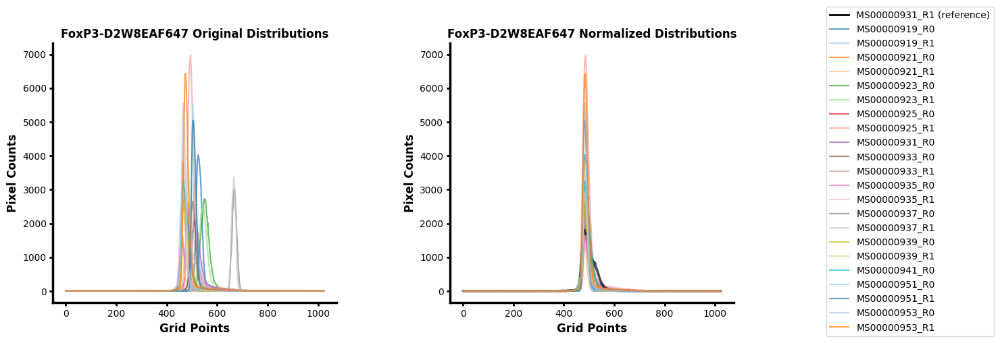


-------------------- Processing marker 'EphB2-D2X2IAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [51, 46, -9, -19, 67, 62, 11, 12, 24, 23, 21, 27, 2, -10, 189, 186, 0, 4, -11, 16, 17, -4, -6]
✨ Auto-computed reference landmark for 'EphB2-D2X2IAF750' on 'MS00000939_R0': 409
✨ Implied landmark positions for 'EphB2-D2X2IAF750': [460, 455, 400, 390, 476, 471, 420, 421, 433, 432, 430, 436, 411, 399, 598, 595, 409, 413, 398, 425, 426, 405, 403]


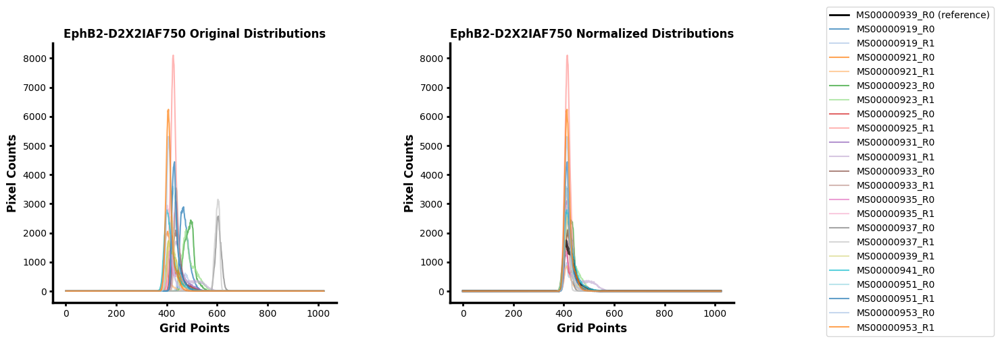


-------------------- Processing marker 'Periostin-E5F2SAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [-6, 1, 0, -110, -174, 0, 103, 69, -195, -112, -120, -144, 48, -152, -11, -184, -4, -80, -94, -135, -167, -158, -233]
✨ Auto-computed reference landmark for 'Periostin-E5F2SAF488' on 'MS00000923_R1': 615
✨ Implied landmark positions for 'Periostin-E5F2SAF488': [609, 616, 615, 505, 441, 615, 718, 684, 420, 503, 495, 471, 663, 463, 604, 431, 611, 535, 521, 480, 448, 457, 382]


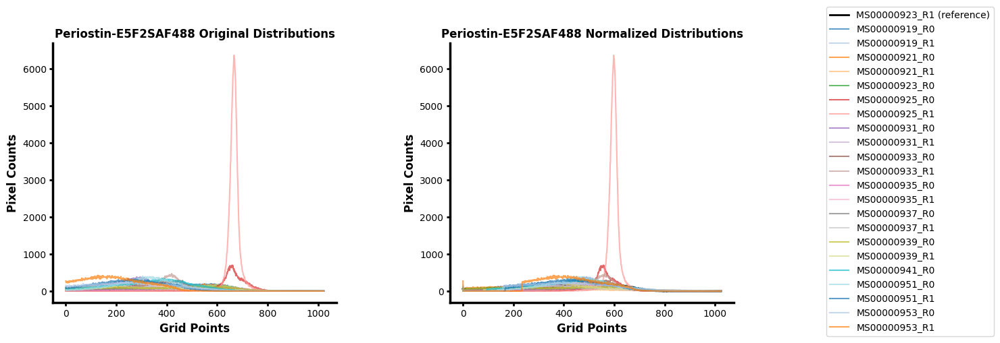


-------------------- Processing marker 'p-NF-kB-178F3AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [23, 14, 10, 4, 12, 10, 261, 258, 6, 0, 14, 16, 18, 8, -21, -27, 0, -7, 11, -1, -10, 0, -3]
✨ Auto-computed reference landmark for 'p-NF-kB-178F3AF555' on 'MS00000939_R0': 533
✨ Implied landmark positions for 'p-NF-kB-178F3AF555': [556, 547, 543, 537, 545, 543, 794, 791, 539, 533, 547, 549, 551, 541, 512, 506, 533, 526, 544, 532, 523, 533, 530]


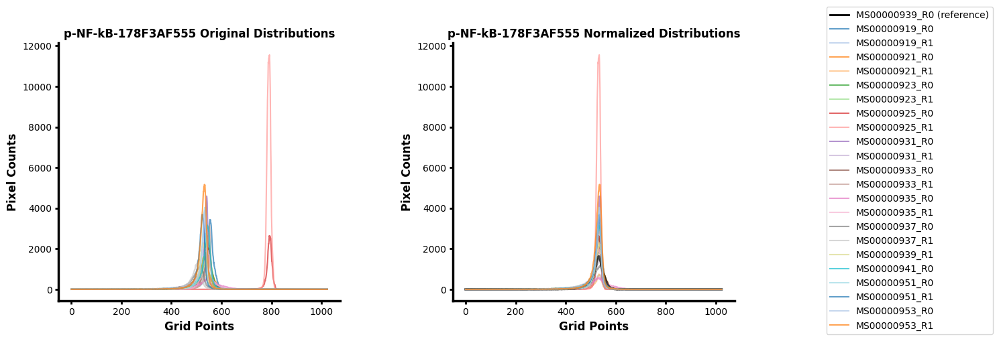


-------------------- Processing marker 'Ki67-D2H10AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [9, 12, -1, 0, 3, -2, 227, 225, 0, -4, 0, 2, 1, 3, -20, -20, -9, -9, 6, -7, -3, -7, -12]
✨ Auto-computed reference landmark for 'Ki67-D2H10AF647' on 'MS00000933_R0': 458
✨ Implied landmark positions for 'Ki67-D2H10AF647': [467, 470, 457, 458, 461, 456, 685, 683, 458, 454, 458, 460, 459, 461, 438, 438, 449, 449, 464, 451, 455, 451, 446]


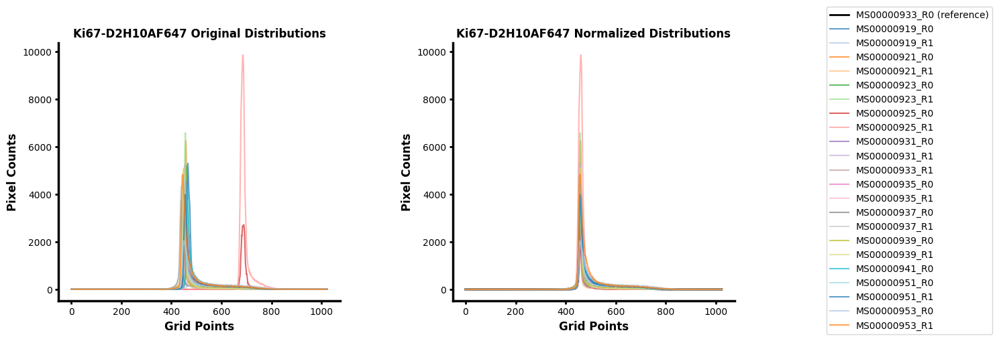


-------------------- Processing marker 'CD209-1781AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R0' by histogram proximity 

✨ Computed shifts: [39, 43, 21, 16, 6, 0, 461, 448, -4, -15, 50, 51, 0, -15, -97, -128, -17, -22, 24, 2, -11, -72, -97]
✨ Auto-computed reference landmark for 'CD209-1781AF750' on 'MS00000935_R0': 427
✨ Implied landmark positions for 'CD209-1781AF750': [466, 470, 448, 443, 433, 427, 888, 875, 423, 412, 477, 478, 427, 412, 330, 299, 410, 405, 451, 429, 416, 355, 330]


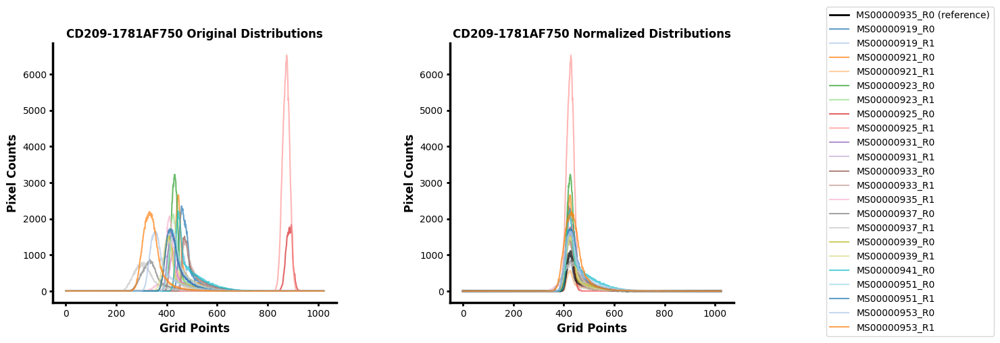


-------------------- Processing marker 'CD90-E3V8AAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [17, -23, -55, 49, 81, -47, -35, 87, 81, 0, -31, 13, -30, 33, -34, 44, -89, 70, 7, 24, 22, -58, 19]
✨ Auto-computed reference landmark for 'CD90-E3V8AAF488' on 'MS00000931_R1': 532
✨ Implied landmark positions for 'CD90-E3V8AAF488': [549, 509, 477, 581, 613, 485, 497, 619, 613, 532, 501, 545, 502, 565, 498, 576, 443, 602, 539, 556, 554, 474, 551]


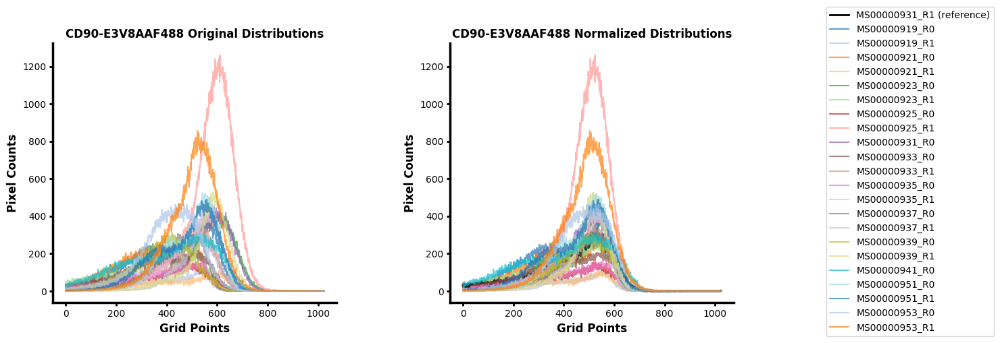


-------------------- Processing marker 'IRF-8-E6J8QAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [-5, -13, 65, 59, -7, -16, -21, 1, 0, -9, 11, 17, 9, 14, 6, 8, 80, 74, -14, 10, 6, 3, 4]
✨ Auto-computed reference landmark for 'IRF-8-E6J8QAF555' on 'MS00000931_R0': 526
✨ Implied landmark positions for 'IRF-8-E6J8QAF555': [521, 513, 591, 585, 519, 510, 505, 527, 526, 517, 537, 543, 535, 540, 532, 534, 606, 600, 512, 536, 532, 529, 530]


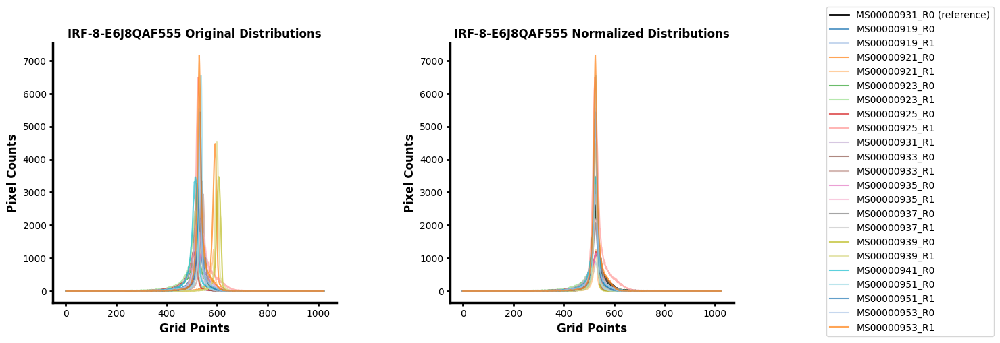


-------------------- Processing marker 'IL-1beta-3A6AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [-7, -15, 113, 102, -5, -5, -11, -1, -14, 0, 39, 38, 29, 23, 10, 11, 124, 112, -12, 19, 15, 2, 8]
✨ Auto-computed reference landmark for 'IL-1beta-3A6AF647' on 'MS00000931_R1': 516
✨ Implied landmark positions for 'IL-1beta-3A6AF647': [509, 501, 629, 618, 511, 511, 505, 515, 502, 516, 555, 554, 545, 539, 526, 527, 640, 628, 504, 535, 531, 518, 524]


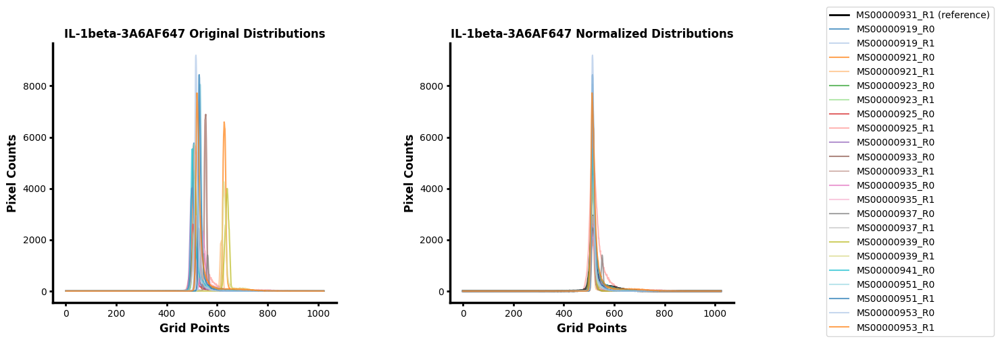


-------------------- Processing marker 'CD103-3904RAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000937_R0' by histogram proximity 

✨ Computed shifts: [-16, -24, 159, 143, 21, 19, -31, -32, -13, -19, 79, 76, 90, 83, 0, -7, 184, 166, -8, 32, 21, 8, -3]
✨ Auto-computed reference landmark for 'CD103-3904RAF750' on 'MS00000937_R0': 443
✨ Implied landmark positions for 'CD103-3904RAF750': [427, 419, 602, 586, 464, 462, 412, 411, 430, 424, 522, 519, 533, 526, 443, 436, 627, 609, 435, 475, 464, 451, 440]


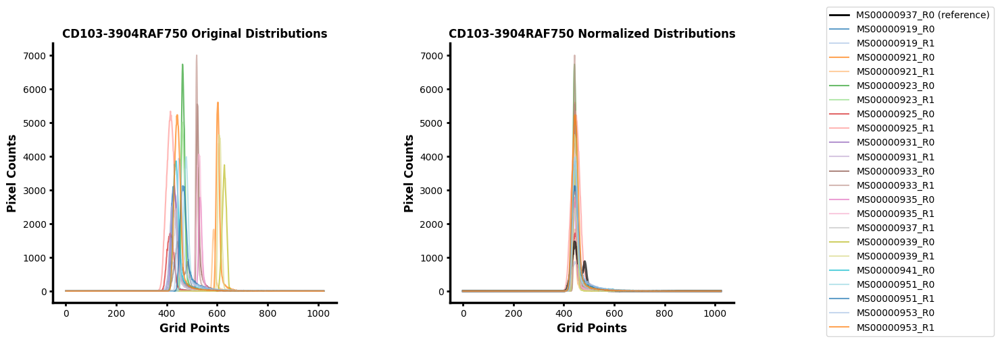


-------------------- Processing marker 'SOD2-D3X8FAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-71, -99, -52, -19, 60, -32, -78, 34, 37, -61, 0, -1, -29, 32, -133, -54, -77, 74, 58, -23, -21, -11, 17]
✨ Auto-computed reference landmark for 'SOD2-D3X8FAF488' on 'MS00000933_R0': 513
✨ Implied landmark positions for 'SOD2-D3X8FAF488': [442, 414, 461, 494, 573, 481, 435, 547, 550, 452, 513, 512, 484, 545, 380, 459, 436, 587, 571, 490, 492, 502, 530]


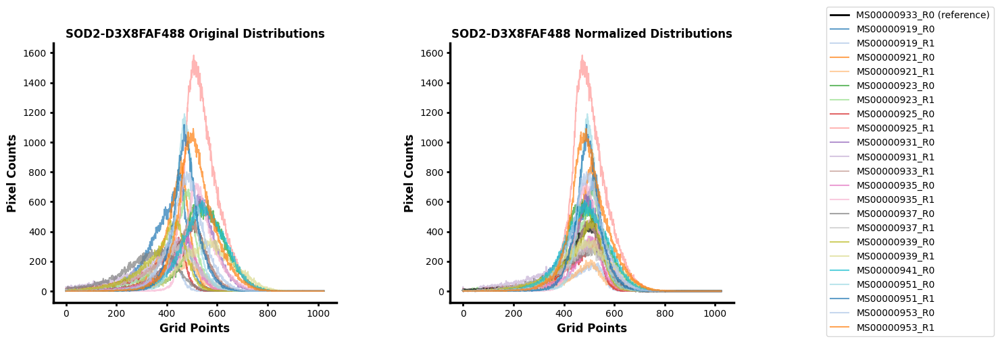


-------------------- Processing marker 'p-p38MAPK-D3F9AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [7, 0, 1, -2, -1, 0, -3, -5, -1, 3, 2, 2, 11, 7, -8, -6, -1, -4, 7, -3, -2, 0, -2]
✨ Auto-computed reference landmark for 'p-p38MAPK-D3F9AF647' on 'MS00000923_R1': 477
✨ Implied landmark positions for 'p-p38MAPK-D3F9AF647': [484, 477, 478, 475, 476, 477, 474, 472, 476, 480, 479, 479, 488, 484, 469, 471, 476, 473, 484, 474, 475, 477, 475]


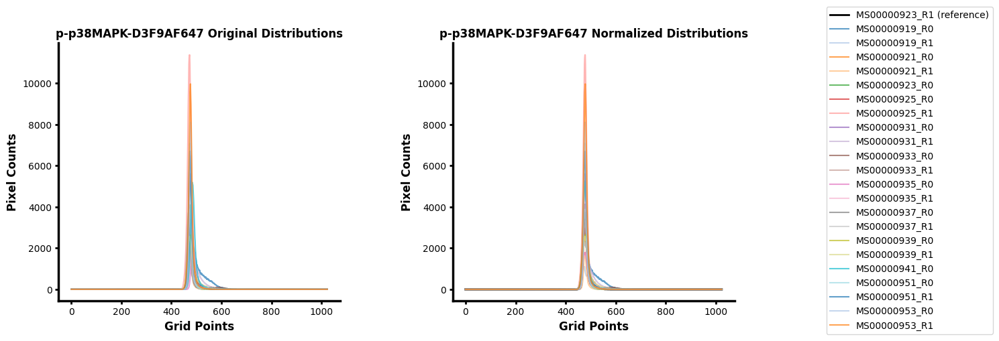


-------------------- Processing marker 'PU1-2146AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [18, 17, 3, -3, 9, 5, 0, -8, 38, 35, -30, -28, 10, -1, -20, -29, 0, -8, 22, -39, -49, 7, 1]
✨ Auto-computed reference landmark for 'PU1-2146AF750' on 'MS00000925_R0': 327
✨ Implied landmark positions for 'PU1-2146AF750': [345, 344, 330, 324, 336, 332, 327, 319, 365, 362, 297, 299, 337, 326, 307, 298, 327, 319, 349, 288, 278, 334, 328]


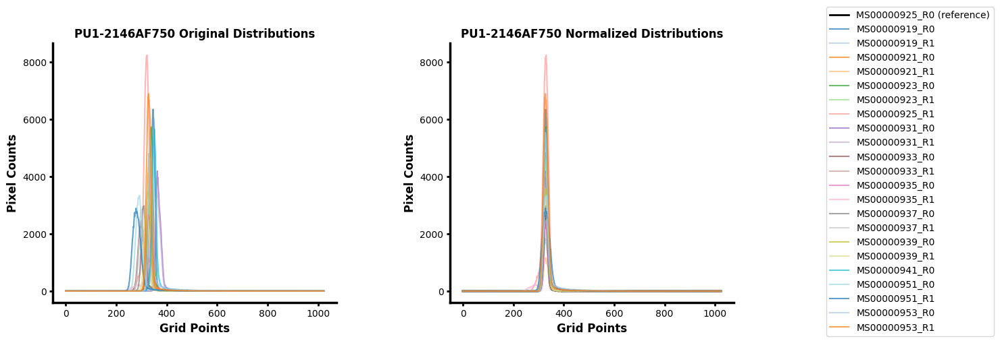


-------------------- Processing marker 'S100A12-OTI1D1AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [23, 11, 17, 35, -69, -105, -63, 16, 43, 0, -85, -31, 15, 63, -128, -151, -154, -144, -89, 4, -27, -27, 25]
✨ Auto-computed reference landmark for 'S100A12-OTI1D1AF488' on 'MS00000931_R1': 399
✨ Implied landmark positions for 'S100A12-OTI1D1AF488': [422, 410, 416, 434, 330, 294, 336, 415, 442, 399, 314, 368, 414, 462, 271, 248, 245, 255, 310, 403, 372, 372, 424]


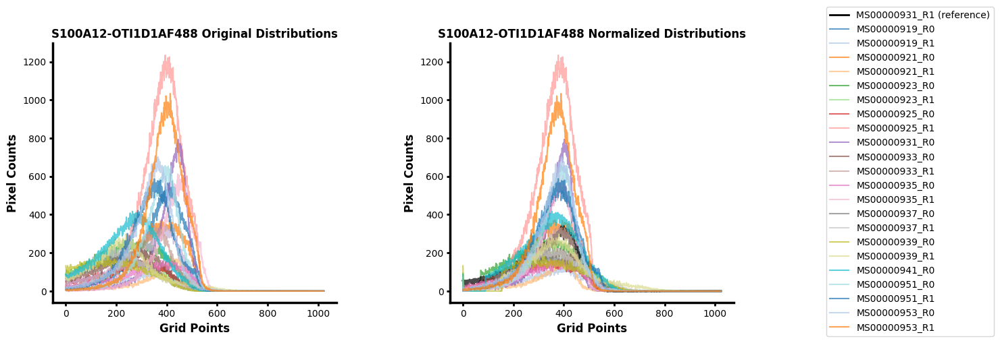


-------------------- Processing marker 'MMP-9-D6O3HAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-1, -4, -2, 2, -6, -19, -11, 25, 12, -11, 0, 16, 2, 24, -15, -3, -16, 1, -13, 1, 2, 1, 18]
✨ Auto-computed reference landmark for 'MMP-9-D6O3HAF555' on 'MS00000933_R0': 455
✨ Implied landmark positions for 'MMP-9-D6O3HAF555': [454, 451, 453, 457, 449, 436, 444, 480, 467, 444, 455, 471, 457, 479, 440, 452, 439, 456, 442, 456, 457, 456, 473]


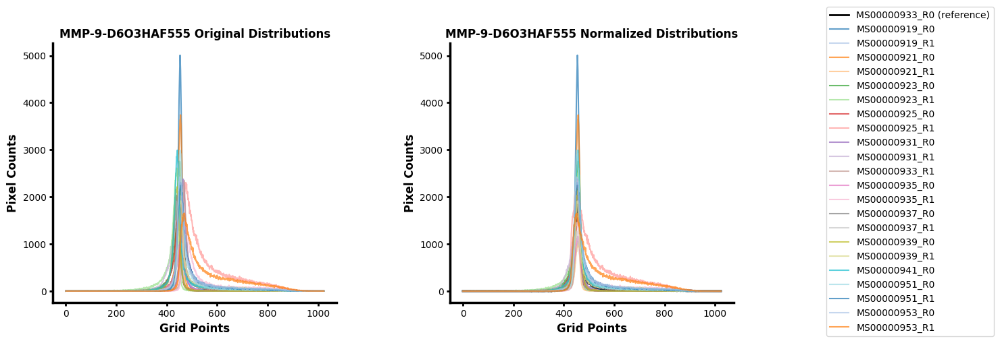


-------------------- Processing marker 'CD11c-D3V1EAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-2, -2, -8, -6, -5, -7, 6, 9, -6, -10, -2, 0, 2, 3, -1, 1, -4, 0, -9, 7, 6, -46, -30]
✨ Auto-computed reference landmark for 'CD11c-D3V1EAF647' on 'MS00000939_R1': 496
✨ Implied landmark positions for 'CD11c-D3V1EAF647': [494, 494, 488, 490, 491, 489, 502, 505, 490, 486, 494, 496, 498, 499, 495, 497, 492, 496, 487, 503, 502, 450, 466]


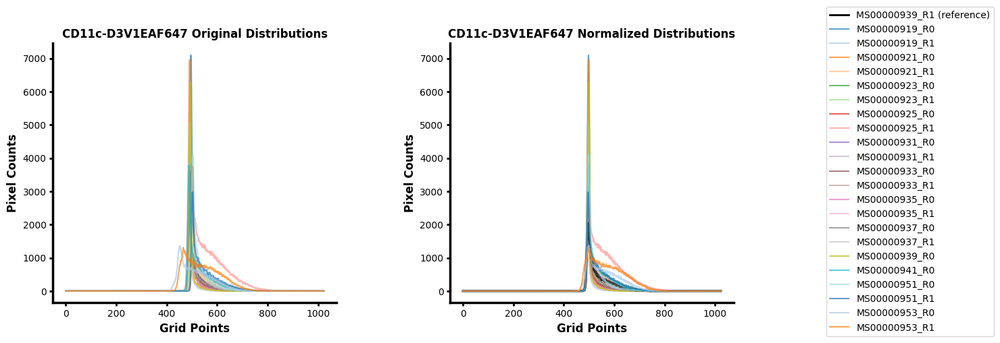


-------------------- Processing marker 'PD-1-D4W2JAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [11, 8, -4, -7, 32, 32, 16, 16, 0, -14, 15, 16, 9, 4, -15, -22, 4, 0, -4, 21, 10, -5, -6]
✨ Auto-computed reference landmark for 'PD-1-D4W2JAF750' on 'MS00000931_R0': 407
✨ Implied landmark positions for 'PD-1-D4W2JAF750': [418, 415, 403, 400, 439, 439, 423, 423, 407, 393, 422, 423, 416, 411, 392, 385, 411, 407, 403, 428, 417, 402, 401]


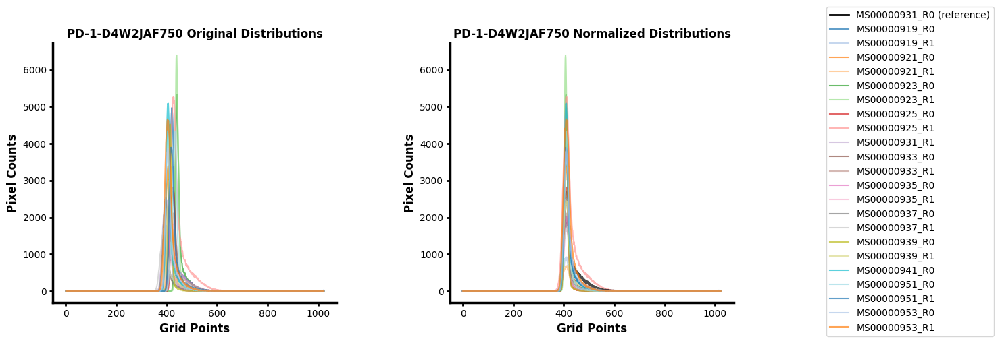


-------------------- Processing marker 'IDO-D5J4EAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [-4, -21, 0, 14, -69, -111, 69, 138, 27, -52, -98, -46, -43, 18, -14, -3, 36, 64, -6, 86, 98, -52, -2]
✨ Auto-computed reference landmark for 'IDO-D5J4EAF488' on 'MS00000921_R0': 337
✨ Implied landmark positions for 'IDO-D5J4EAF488': [333, 316, 337, 351, 268, 226, 406, 475, 364, 285, 239, 291, 294, 355, 323, 334, 373, 401, 331, 423, 435, 285, 335]


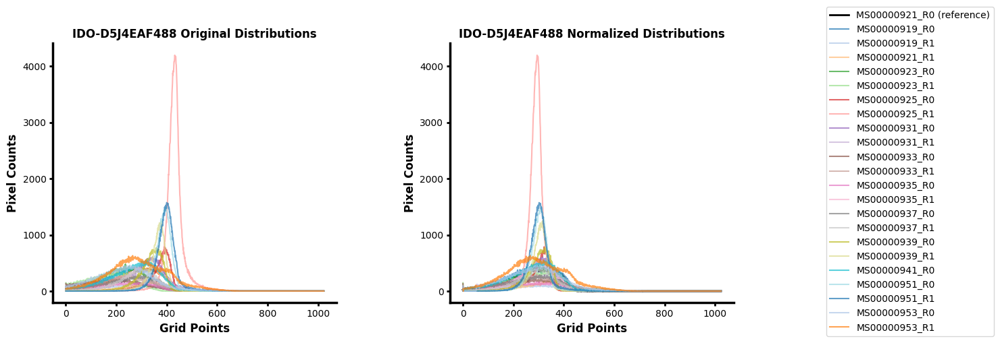


-------------------- Processing marker 'YKL-40-E2L1MAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-5, -9, -3, 3, 3, -6, 7, 34, 10, -5, -5, 0, -16, 36, 40, 62, 3, 18, 10, 29, 27, 18, 29]
✨ Auto-computed reference landmark for 'YKL-40-E2L1MAF555' on 'MS00000933_R1': 527
✨ Implied landmark positions for 'YKL-40-E2L1MAF555': [522, 518, 524, 530, 530, 521, 534, 561, 537, 522, 522, 527, 511, 563, 567, 589, 530, 545, 537, 556, 554, 545, 556]


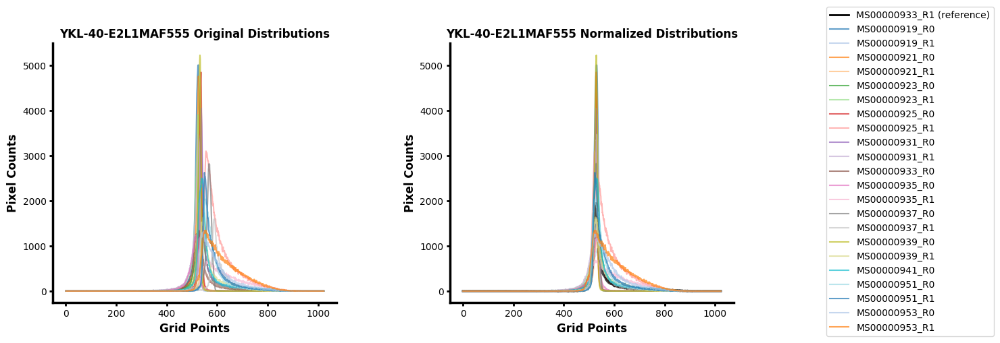


-------------------- Processing marker 'IRF-1-D5E4AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [-13, -20, -22, -17, -5, -7, -17, 3, 0, -9, 9, 14, -11, -8, 28, 38, -21, -21, 7, 5, 8, -4, 1]
✨ Auto-computed reference landmark for 'IRF-1-D5E4AF647' on 'MS00000931_R0': 488
✨ Implied landmark positions for 'IRF-1-D5E4AF647': [475, 468, 466, 471, 483, 481, 471, 491, 488, 479, 497, 502, 477, 480, 516, 526, 467, 467, 495, 493, 496, 484, 489]


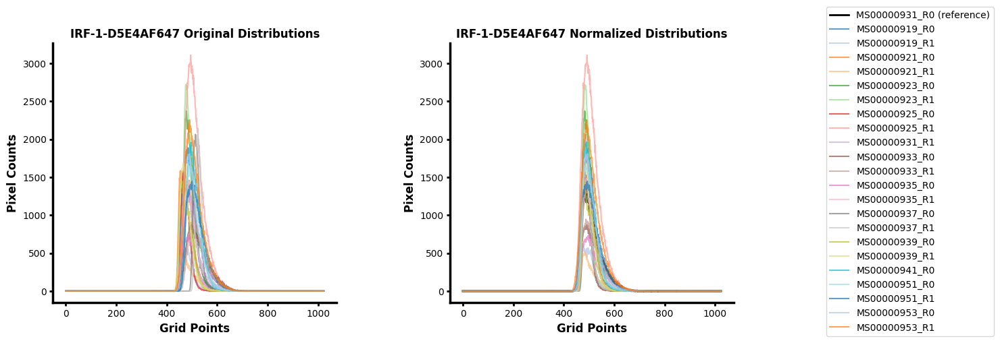


-------------------- Processing marker 'IFITM3-D8E8GAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-23, -24, -3, 4, -27, -53, -51, -23, 17, 22, 9, 0, 1, -24, 9, 26, -33, -17, 24, 9, 12, 7, 7]
✨ Auto-computed reference landmark for 'IFITM3-D8E8GAF750' on 'MS00000933_R1': 463
✨ Implied landmark positions for 'IFITM3-D8E8GAF750': [440, 439, 460, 467, 436, 410, 412, 440, 480, 485, 472, 463, 464, 439, 472, 489, 430, 446, 487, 472, 475, 470, 470]


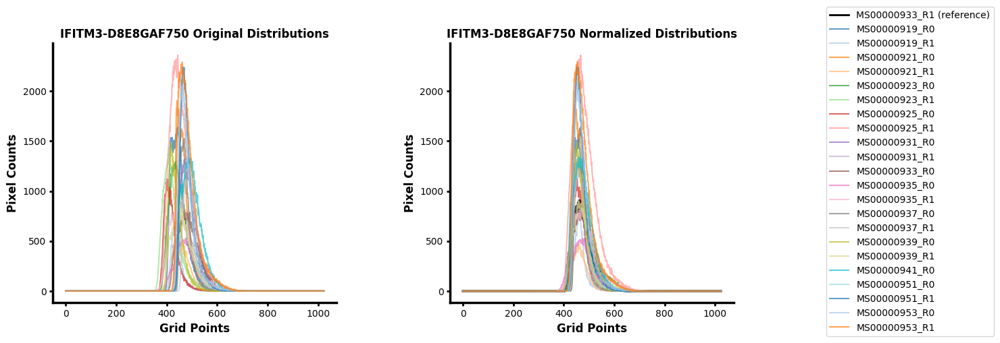


-------------------- Processing marker 'CD7-E4G1QAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [-23, -3, -43, -19, 52, 9, -63, 30, 20, -40, -54, 53, -16, 32, -127, -66, 0, 53, -159, -14, -14, -136, -89]
✨ Auto-computed reference landmark for 'CD7-E4G1QAF488' on 'MS00000939_R0': 429
✨ Implied landmark positions for 'CD7-E4G1QAF488': [406, 426, 386, 410, 481, 438, 366, 459, 449, 389, 375, 482, 413, 461, 302, 363, 429, 482, 270, 415, 415, 293, 340]


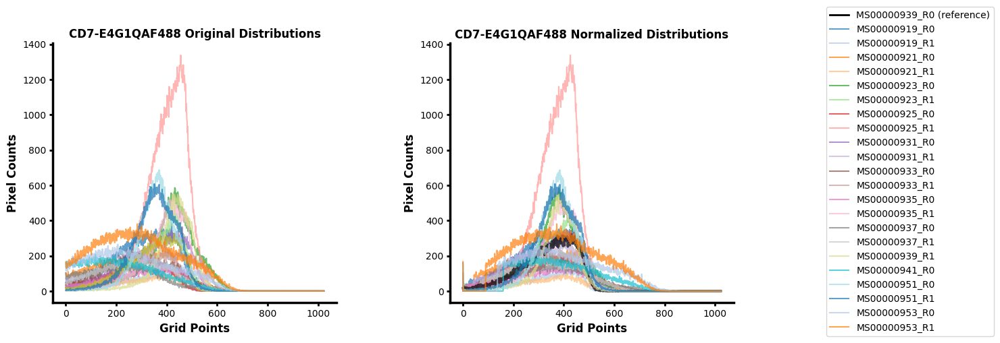


-------------------- Processing marker 'GITR-D5V7PAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-2, 6, -11, -1, 29, 23, 4, 16, 11, 8, -11, 0, -2, 14, -20, -9, 18, 31, -19, 12, 10, -11, -8]
✨ Auto-computed reference landmark for 'GITR-D5V7PAF555' on 'MS00000933_R1': 467
✨ Implied landmark positions for 'GITR-D5V7PAF555': [465, 473, 456, 466, 496, 490, 471, 483, 478, 475, 456, 467, 465, 481, 447, 458, 485, 498, 448, 479, 477, 456, 459]


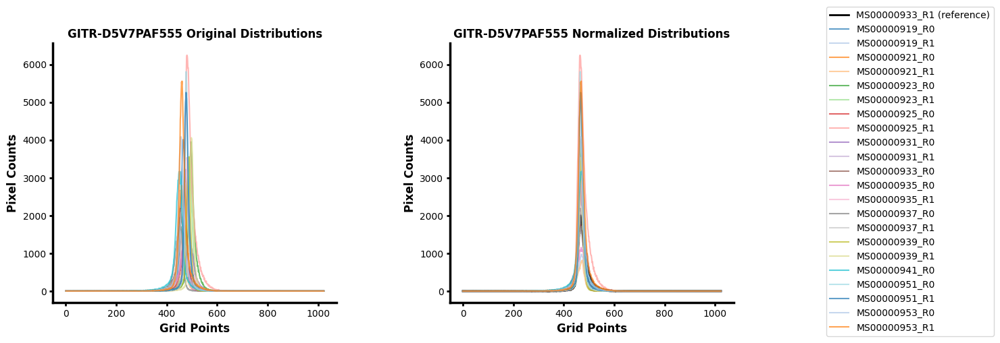


-------------------- Processing marker 'pSTAT1Ty70158D6AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-16, -3, -10, 2, 85, 79, 17, 30, 9, 3, -5, 0, -2, 11, -17, -5, 56, 70, -4, 33, 33, -2, 3]
✨ Auto-computed reference landmark for 'pSTAT1Ty70158D6AF647' on 'MS00000933_R1': 472
✨ Implied landmark positions for 'pSTAT1Ty70158D6AF647': [456, 469, 462, 474, 557, 551, 489, 502, 481, 475, 467, 472, 470, 483, 455, 467, 528, 542, 468, 505, 505, 470, 475]


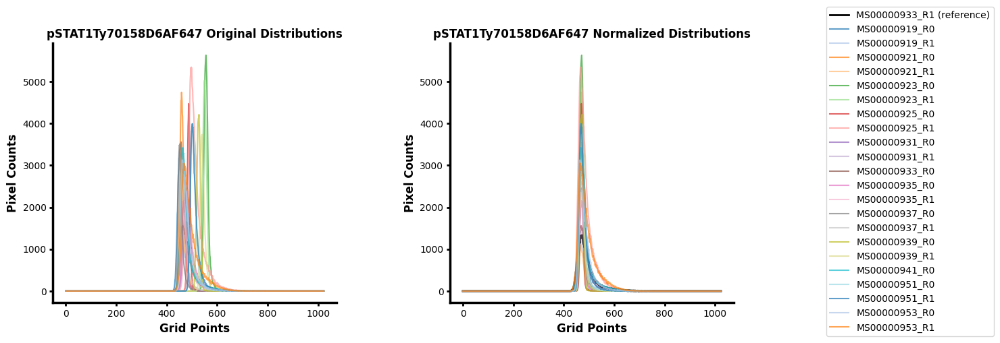


-------------------- Processing marker 'IRF-4-E8H3SAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [18, 42, 25, 35, 160, 157, 64, 69, 43, 57, -8, 0, 37, 48, 13, 27, 117, 135, 31, 82, 78, -2, -2]
✨ Auto-computed reference landmark for 'IRF-4-E8H3SAF750' on 'MS00000933_R1': 239
✨ Implied landmark positions for 'IRF-4-E8H3SAF750': [257, 281, 264, 274, 399, 396, 303, 308, 282, 296, 231, 239, 276, 287, 252, 266, 356, 374, 270, 321, 317, 237, 237]


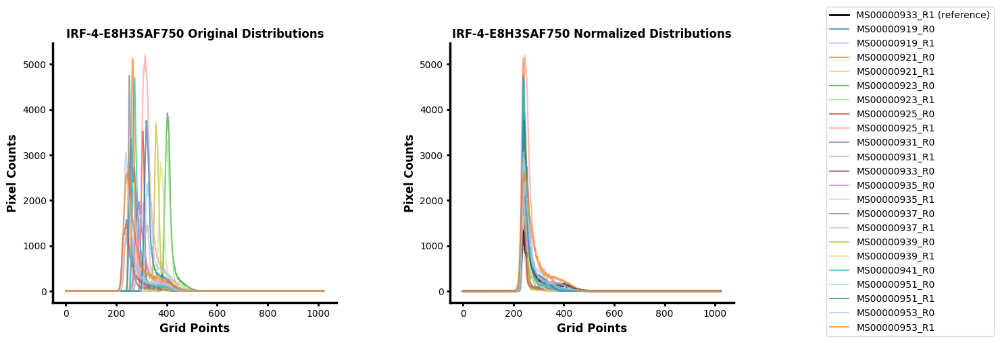


-------------------- Processing marker 'CD14-D7A2TAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [0, 16, -40, 6, 1, -42, -55, 43, 21, 0, -2, -32, 6, 39, -30, 27, -89, -4, 81, 58, 78, 100, 75]
✨ Auto-computed reference landmark for 'CD14-D7A2TAF488' on 'MS00000931_R1': 510
✨ Implied landmark positions for 'CD14-D7A2TAF488': [510, 526, 470, 516, 511, 468, 455, 553, 531, 510, 508, 478, 516, 549, 480, 537, 421, 506, 591, 568, 588, 610, 585]


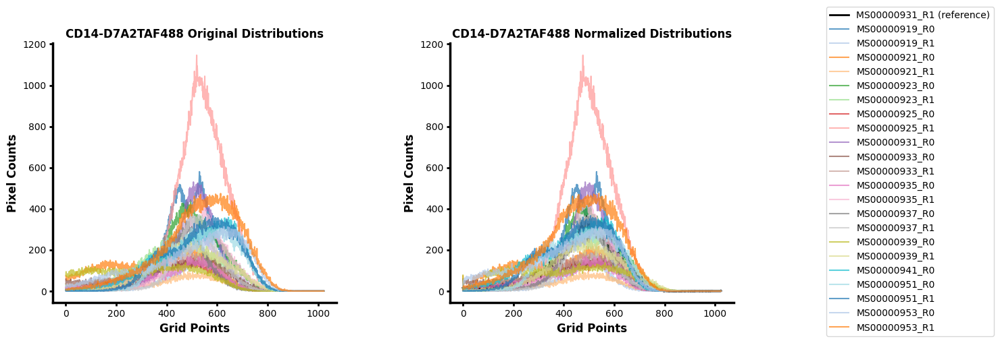


-------------------- Processing marker 'T-bet-E4I2KAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [10, 14, -12, -2, 1, -6, -10, 7, 28, 24, -12, 0, 98, 107, 7, 16, -11, 2, -3, -2, -2, 2, 8]
✨ Auto-computed reference landmark for 'T-bet-E4I2KAF555' on 'MS00000933_R1': 542
✨ Implied landmark positions for 'T-bet-E4I2KAF555': [552, 556, 530, 540, 543, 536, 532, 549, 570, 566, 530, 542, 640, 649, 549, 558, 531, 544, 539, 540, 540, 544, 550]


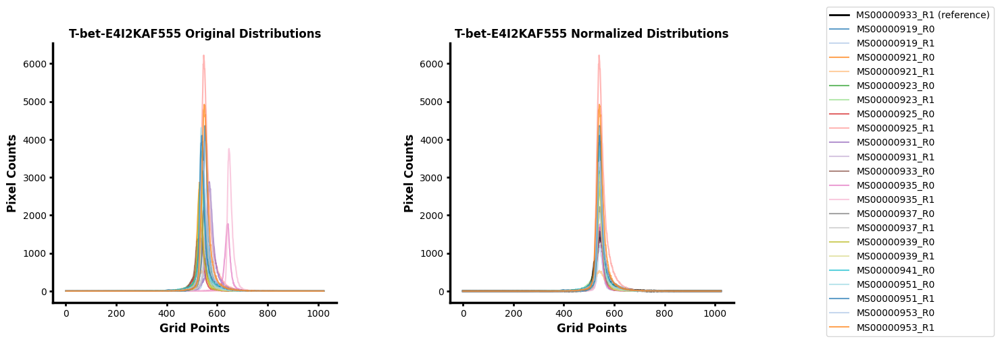


-------------------- Processing marker 'pSTAT1s727-D3B7AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [3, -5, 1, 9, 11, 5, -3, 4, 74, 66, 48, 55, 100, 100, 1, 4, -4, 0, 5, 41, 60, 41, 41]
✨ Auto-computed reference landmark for 'pSTAT1s727-D3B7AF647' on 'MS00000939_R1': 457
✨ Implied landmark positions for 'pSTAT1s727-D3B7AF647': [460, 452, 458, 466, 468, 462, 454, 461, 531, 523, 505, 512, 557, 557, 458, 461, 453, 457, 462, 498, 517, 498, 498]


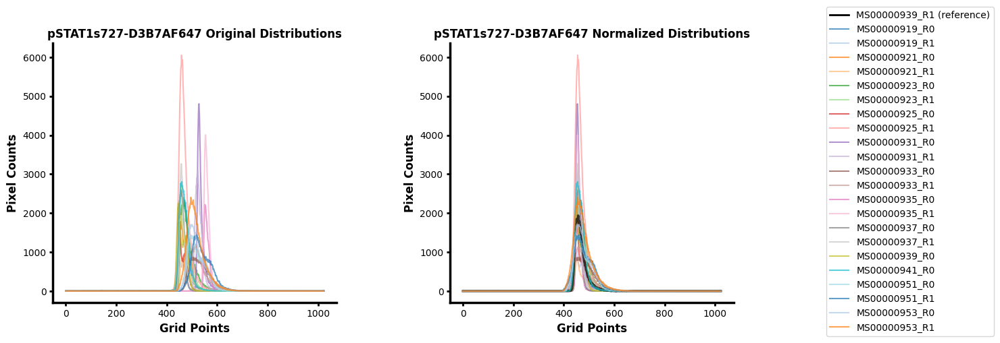


-------------------- Processing marker 'ClvCasp-3-58A1EAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [27, 24, -30, -46, 3, 2, 0, -2, 91, 95, 36, 41, 27, 19, -21, -23, -14, -35, 4, 14, 11, 19, 28]
✨ Auto-computed reference landmark for 'ClvCasp-3-58A1EAF750' on 'MS00000925_R0': 540
✨ Implied landmark positions for 'ClvCasp-3-58A1EAF750': [567, 564, 510, 494, 543, 542, 540, 538, 631, 635, 576, 581, 567, 559, 519, 517, 526, 505, 544, 554, 551, 559, 568]


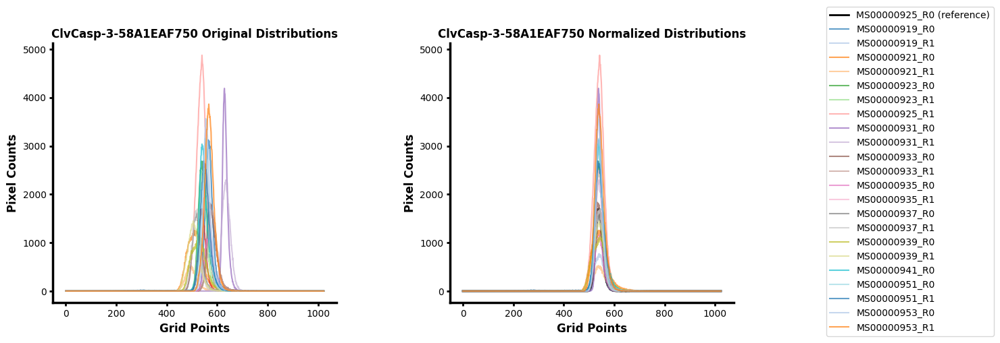


-------------------- Processing marker 'SMA-1A4AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [-1, 4, 0, -10, 10, 51, 40, 57, -131, -18, 80, 132, 63, 41, -22, 8, -2, 4, 3, 44, 37, -49, -11]
✨ Auto-computed reference landmark for 'SMA-1A4AF488' on 'MS00000921_R0': 346
✨ Implied landmark positions for 'SMA-1A4AF488': [345, 350, 346, 336, 356, 397, 386, 403, 215, 328, 426, 478, 409, 387, 324, 354, 344, 350, 349, 390, 383, 297, 335]


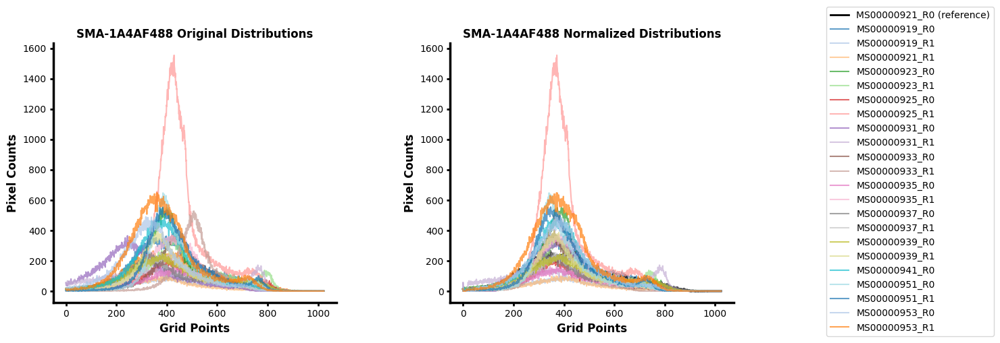


-------------------- Processing marker 'NAkATPaseEP1845Y555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000937_R1' by histogram proximity 

✨ Computed shifts: [-13, -36, -8, -10, -4, -14, -30, 4, -54, -53, 30, 31, -55, -44, -25, 0, -4, 17, -17, 22, 15, -8, 2]
✨ Auto-computed reference landmark for 'NAkATPaseEP1845Y555' on 'MS00000937_R1': 551
✨ Implied landmark positions for 'NAkATPaseEP1845Y555': [538, 515, 543, 541, 547, 537, 521, 555, 497, 498, 581, 582, 496, 507, 526, 551, 547, 568, 534, 573, 566, 543, 553]


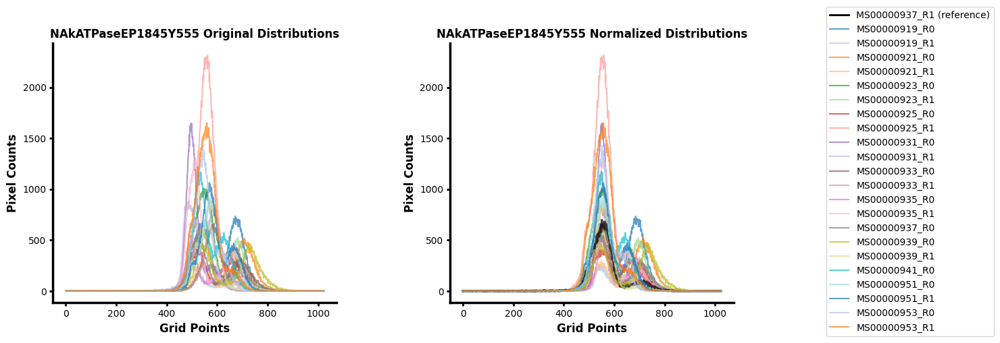


-------------------- Processing marker 'HLADR-LN3AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000951_R0' by histogram proximity 

✨ Computed shifts: [-7, -7, 2, 1, 1, -4, 0, 0, -13, -16, 5, 4, 10, 14, -9, -8, -2, -3, -4, 0, 3, 3, 2]
✨ Auto-computed reference landmark for 'HLADR-LN3AF647' on 'MS00000951_R0': 498
✨ Implied landmark positions for 'HLADR-LN3AF647': [491, 491, 500, 499, 499, 494, 498, 498, 485, 482, 503, 502, 508, 512, 489, 490, 496, 495, 494, 498, 501, 501, 500]


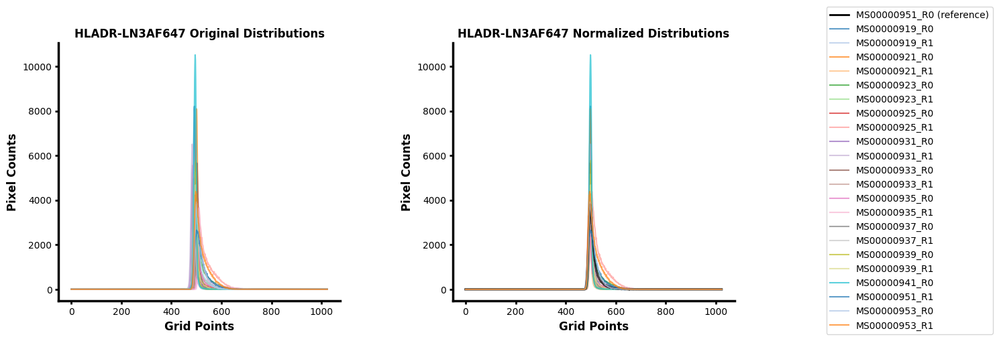


-------------------- Processing marker 'CD452B11PD726AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-23, -25, -6, -2, 3, -2, 26, 26, 17, -1, 55, 63, 130, 129, 0, 0, -9, 0, -1, -14, -8, 10, 16]
✨ Auto-computed reference landmark for 'CD452B11PD726AF750' on 'MS00000939_R1': 460
✨ Implied landmark positions for 'CD452B11PD726AF750': [437, 435, 454, 458, 463, 458, 486, 486, 477, 459, 515, 523, 590, 589, 460, 460, 451, 460, 459, 446, 452, 470, 476]


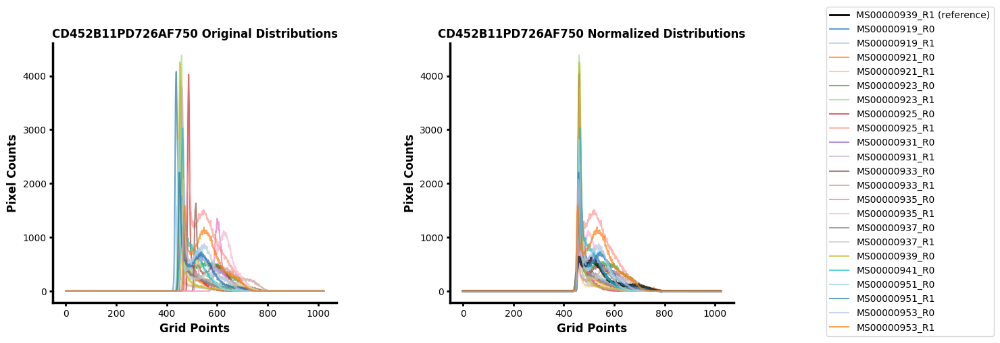


-------------------- Processing marker 'CD4EPR6855AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-3, 10, -48, -30, 6, 3, -28, -9, 4, -10, -21, 9, -11, 1, -14, -6, -16, 0, -16, -16, -17, 11, 16]
✨ Auto-computed reference landmark for 'CD4EPR6855AF555' on 'MS00000939_R1': 442
✨ Implied landmark positions for 'CD4EPR6855AF555': [439, 452, 394, 412, 448, 445, 414, 433, 446, 432, 421, 451, 431, 443, 428, 436, 426, 442, 426, 426, 425, 453, 458]


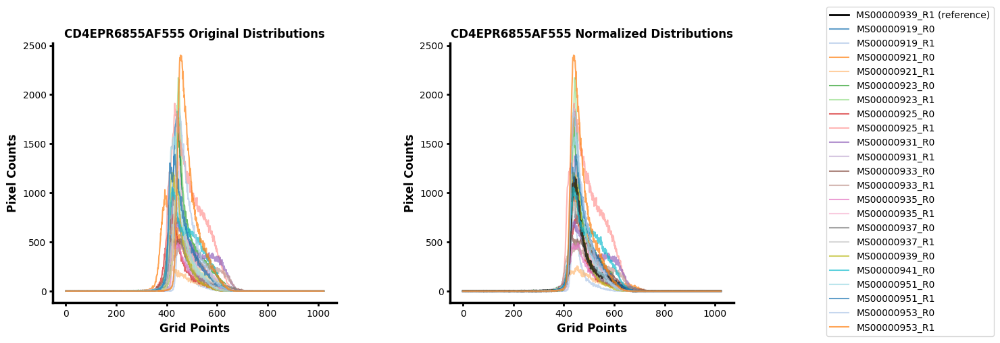


-------------------- Processing marker 'CD20-E7B7TAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-1, -1, -3, -1, 3, -2, 1, 6, 9, 3, 0, 11, 0, 3, 3, 7, 0, 5, -4, -7, -5, 2, 5]
✨ Auto-computed reference landmark for 'CD20-E7B7TAF647' on 'MS00000933_R0': 425
✨ Implied landmark positions for 'CD20-E7B7TAF647': [424, 424, 422, 424, 428, 423, 426, 431, 434, 428, 425, 436, 425, 428, 428, 432, 425, 430, 421, 418, 420, 427, 430]


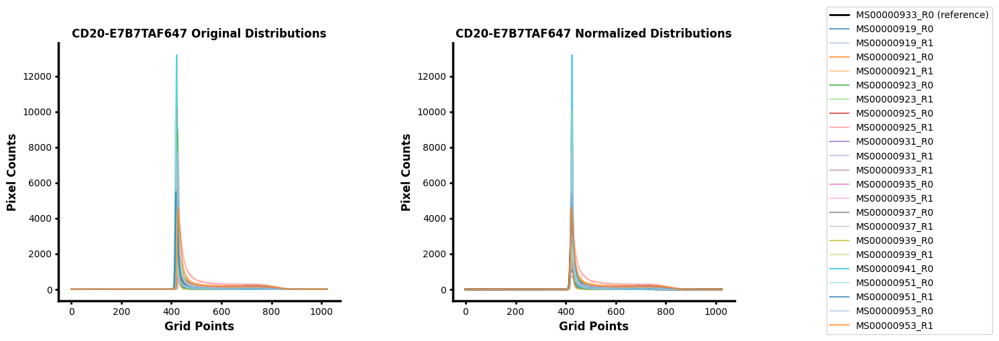


-------------------- Processing marker 'CD16-DJ130cAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-28, -39, -24, -28, 14, 9, -28, -15, 9, -11, 0, -1, -5, -5, 102, 103, 38, 38, 13, -26, -27, -42, -41]
✨ Auto-computed reference landmark for 'CD16-DJ130cAF750' on 'MS00000933_R0': 491
✨ Implied landmark positions for 'CD16-DJ130cAF750': [463, 452, 467, 463, 505, 500, 463, 476, 500, 480, 491, 490, 486, 486, 593, 594, 529, 529, 504, 465, 464, 449, 450]


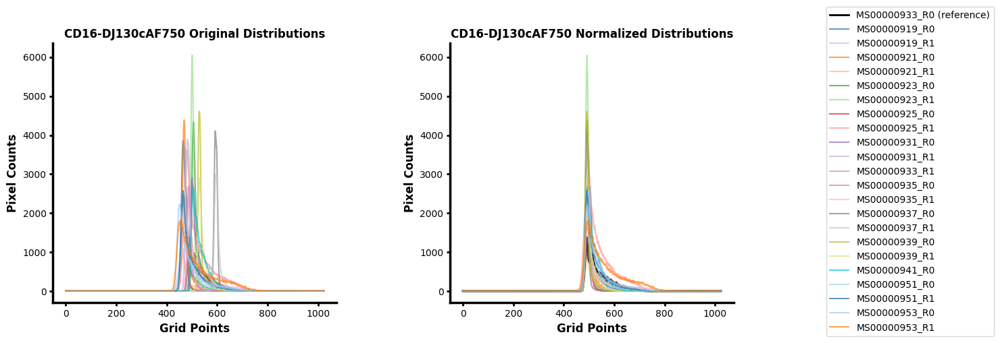


-------------------- Processing marker 'CD27-EPR8569AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-4, -8, -45, -26, -10, -30, 7, 17, 17, 8, 0, 9, -18, 12, 3, 16, 16, 24, 8, 29, 28, -2, 3]
✨ Auto-computed reference landmark for 'CD27-EPR8569AF555' on 'MS00000933_R0': 436
✨ Implied landmark positions for 'CD27-EPR8569AF555': [432, 428, 391, 410, 426, 406, 443, 453, 453, 444, 436, 445, 418, 448, 439, 452, 452, 460, 444, 465, 464, 434, 439]


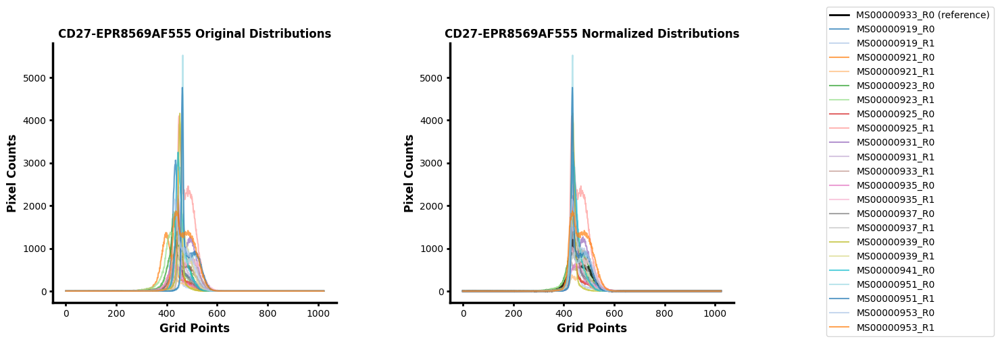


-------------------- Processing marker 'CD3d-EP4426AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [5, -3, 13, 6, 0, 1, -8, -6, -1, -6, 0, 10, 42, 18, -17, -14, -6, -5, -5, -4, -4, 15, 15]
✨ Auto-computed reference landmark for 'CD3d-EP4426AF647' on 'MS00000933_R0': 448
✨ Implied landmark positions for 'CD3d-EP4426AF647': [453, 445, 461, 454, 448, 449, 440, 442, 447, 442, 448, 458, 490, 466, 431, 434, 442, 443, 443, 444, 444, 463, 463]


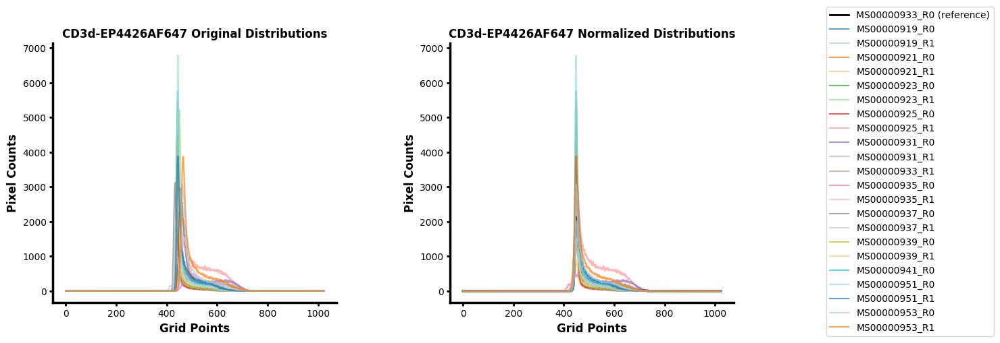


-------------------- Processing marker 'CD8a-c8144BAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-10, -9, -20, -25, 7, 4, 5, 8, 3, 0, -4, 0, 37, 35, -8, -2, 12, 11, -24, 0, 0, 11, 13]
✨ Auto-computed reference landmark for 'CD8a-c8144BAF750' on 'MS00000933_R1': 480
✨ Implied landmark positions for 'CD8a-c8144BAF750': [470, 471, 460, 455, 487, 484, 485, 488, 483, 480, 476, 480, 517, 515, 472, 478, 492, 491, 456, 480, 480, 491, 493]


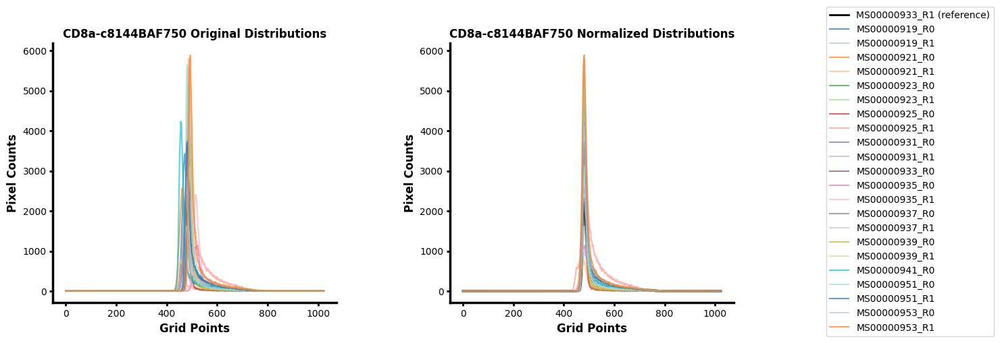


-------------------- Processing marker 'CD68-KP1AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000941_R0' by histogram proximity 

✨ Computed shifts: [-4, -3, 5, 9, 25, 28, 3, 11, 0, -3, -30, -19, 2, 20, -13, -6, -5, 8, 0, 12, 18, -6, -2]
✨ Auto-computed reference landmark for 'CD68-KP1AF555' on 'MS00000941_R0': 475
✨ Implied landmark positions for 'CD68-KP1AF555': [471, 472, 480, 484, 500, 503, 478, 486, 475, 472, 445, 456, 477, 495, 462, 469, 470, 483, 475, 487, 493, 469, 473]


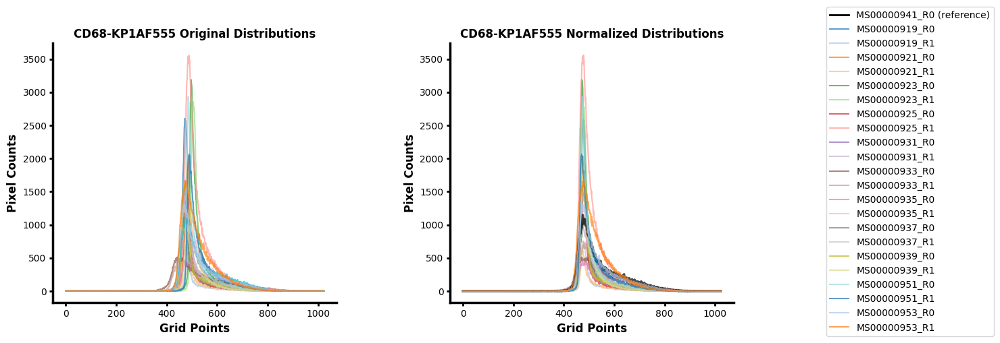


-------------------- Processing marker 'TCR-delta-E2E9TAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [0, -2, 0, -2, 1, 2, -1, -5, -1, 3, -5, -1, -4, -6, 6, 4, 2, -3, -1, -1, 1, 5, 8]
✨ Auto-computed reference landmark for 'TCR-delta-E2E9TAF647' on 'MS00000921_R0': 485
✨ Implied landmark positions for 'TCR-delta-E2E9TAF647': [485, 483, 485, 483, 486, 487, 484, 480, 484, 488, 480, 484, 481, 479, 491, 489, 487, 482, 484, 484, 486, 490, 493]


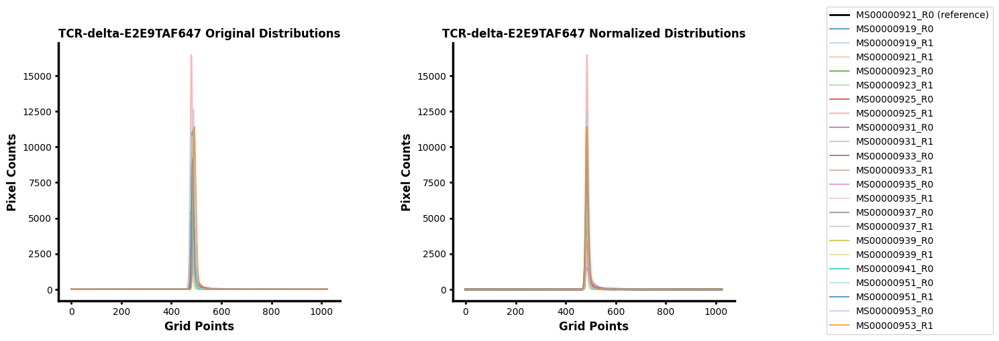


-------------------- Processing marker 'CD15-MC480AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [10, 4, -9, -24, -4, -4, 9, 2, 8, 15, 0, -2, 30, 9, 4, -5, 24, 8, 10, -6, 2, -7, 3]
✨ Auto-computed reference landmark for 'CD15-MC480AF750' on 'MS00000933_R0': 474
✨ Implied landmark positions for 'CD15-MC480AF750': [484, 478, 465, 450, 470, 470, 483, 476, 482, 489, 474, 472, 504, 483, 478, 469, 498, 482, 484, 468, 476, 467, 477]


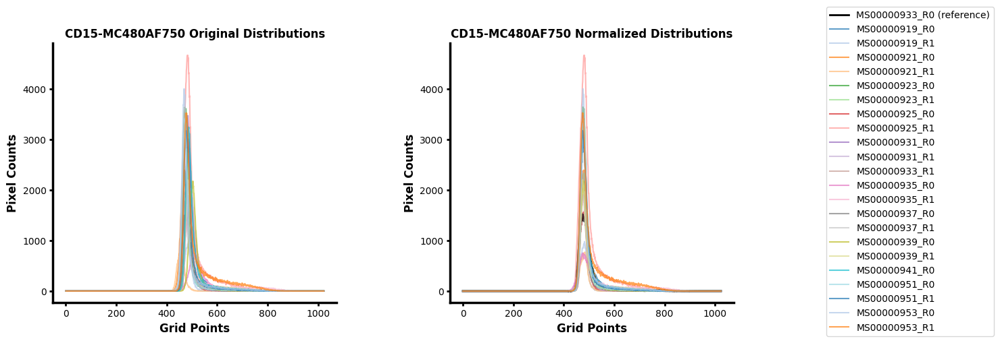


-------------------- Processing marker 'ECadherin-24E10AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [21, 26, 13, 5, -22, 15, 42, 27, -22, 48, 0, 5, 12, -112, 302, -124, 4, -33, 4, 74, 75, -137, -141]
✨ Auto-computed reference landmark for 'ECadherin-24E10AF488' on 'MS00000933_R0': 654
✨ Implied landmark positions for 'ECadherin-24E10AF488': [675, 680, 667, 659, 632, 669, 696, 681, 632, 702, 654, 659, 666, 542, 956, 530, 658, 621, 658, 728, 729, 517, 513]


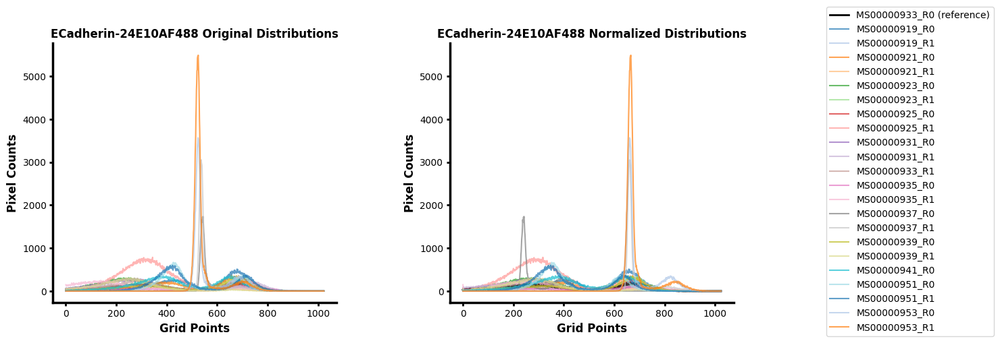


-------------------- Processing marker 'TIM-3-D5D5RAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-14, -22, -14, -2, -10, -22, -13, -4, -9, 20, -4, 0, -10, -23, 8, 13, -32, -23, -2, -15, 3, 12, 11]
✨ Auto-computed reference landmark for 'TIM-3-D5D5RAF555' on 'MS00000933_R1': 594
✨ Implied landmark positions for 'TIM-3-D5D5RAF555': [580, 572, 580, 592, 584, 572, 581, 590, 585, 614, 590, 594, 584, 571, 602, 607, 562, 571, 592, 579, 597, 606, 605]


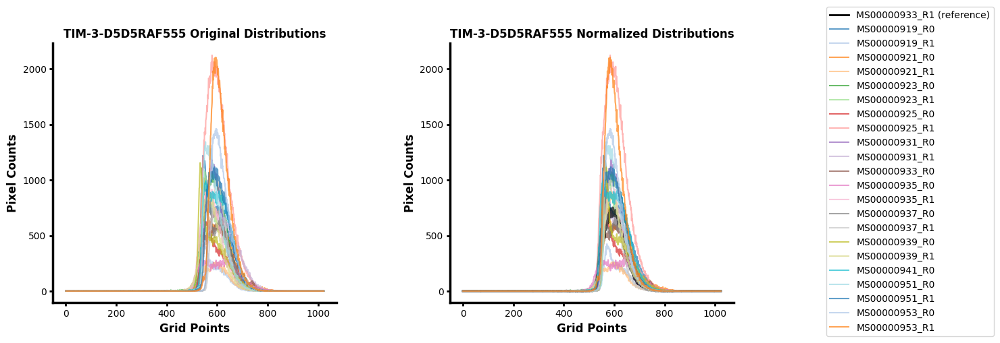


-------------------- Processing marker 'MUC2-CCP58AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R1' by histogram proximity 

✨ Computed shifts: [0, 13, -10, 6, 13, 18, 13, 7, 0, 12, -1, -5, 0, 0, 28, 17, -14, -6, 7, 13, 18, -11, -8]
✨ Auto-computed reference landmark for 'MUC2-CCP58AF647' on 'MS00000935_R1': 518
✨ Implied landmark positions for 'MUC2-CCP58AF647': [518, 531, 508, 524, 531, 536, 531, 525, 518, 530, 517, 513, 518, 518, 546, 535, 504, 512, 525, 531, 536, 507, 510]


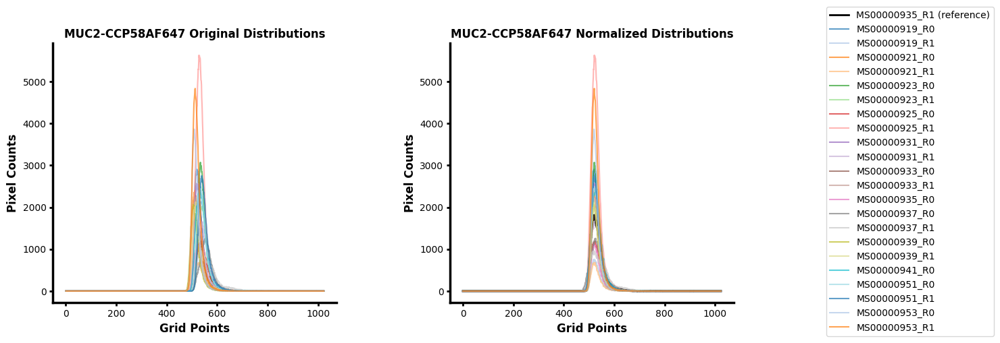


-------------------- Processing marker 'CD56-NCAM1-795-AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [59, 60, -6, -5, 8, 3, 0, -4, 55, 59, 28, 27, 15, 4, 44, 45, -11, -19, 56, 19, 14, 42, 42]
✨ Auto-computed reference landmark for 'CD56-NCAM1-795-AF750' on 'MS00000925_R0': 555
✨ Implied landmark positions for 'CD56-NCAM1-795-AF750': [614, 615, 549, 550, 563, 558, 555, 551, 610, 614, 583, 582, 570, 559, 599, 600, 544, 536, 611, 574, 569, 597, 597]


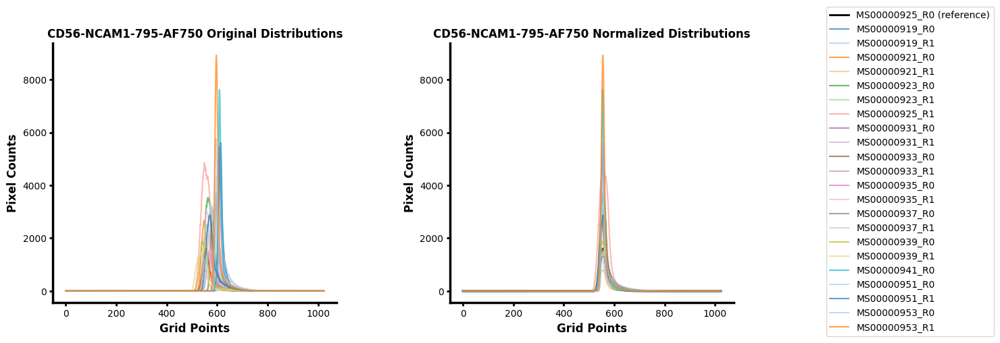

In [50]:
shifts_map, chosen_references, implied_landmarks_map = automatic_registration(
    histogram_data      = histograms,
    all_markers         = adata.var['marker_name'].tolist(),
    selected_markers    = adata.var['marker_name'].tolist(),
    sample_ids          = adata.obs['sample_id'].unique().tolist(),
    reference_samples   = None,
    landmark_map        = None,
    num_bins            = 1024,
    dpi                 = 100,
    x_limits            = None
)

# 4. Perform Landmark Finetuning (optional depending on the alignment results)

In [51]:
landmark_refinement(
    histogram_data        = histograms,
    gmm_models            = gmm_models,
    markers               = None,
    sample_ids            = None,
    data_source           = adata,
    num_bins              = 1024,
    dpi                   = 100,
    x_limits              = None,
    group_size            = 4,
    implied_landmarks_map = implied_landmarks_map,
    verbose               = True,          
    output_directory  = "landmark_picking"
)

HTML files:   0%|          | 0/6 [00:00<?, ?it/s]

Processing samples MS00000919_R0 to MS00000921_R1
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files:  17%|█▋        | 1/6 [00:03<00:18,  3.72s/it]

Processing samples MS00000923_R0 to MS00000925_R1
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files:  33%|███▎      | 2/6 [00:07<00:14,  3.66s/it]

Processing samples MS00000931_R0 to MS00000933_R1
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files:  50%|█████     | 3/6 [00:11<00:11,  3.69s/it]

Processing samples MS00000935_R0 to MS00000937_R1
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files:  67%|██████▋   | 4/6 [00:14<00:07,  3.64s/it]

Processing samples MS00000939_R0 to MS00000951_R0
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files:  83%|████████▎ | 5/6 [00:17<00:03,  3.54s/it]

Processing samples MS00000951_R1 to MS00000953_R1
  Marker: PanCytokAE1AE3AF488
  Marker: p-c-Jun-D47G9AF555
  Marker: CD207-7430AF647
  Marker: CD1c-OTI2F4AF750
  Marker: PDPN-LpMab-12AF488
  Marker: pmTORS2448-49F9AF555
  Marker: FoxP3-D2W8EAF647
  Marker: EphB2-D2X2IAF750
  Marker: Periostin-E5F2SAF488
  Marker: p-NF-kB-178F3AF555
  Marker: Ki67-D2H10AF647
  Marker: CD209-1781AF750
  Marker: CD90-E3V8AAF488
  Marker: IRF-8-E6J8QAF555
  Marker: IL-1beta-3A6AF647
  Marker: CD103-3904RAF750
  Marker: SOD2-D3X8FAF488
  Marker: p-p38MAPK-D3F9AF647
  Marker: PU1-2146AF750
  Marker: S100A12-OTI1D1AF488
  Marker: MMP-9-D6O3HAF555
  Marker: CD11c-D3V1EAF647
  Marker: PD-1-D4W2JAF750
  Marker: IDO-D5J4EAF488
  Marker: YKL-40-E2L1MAF555
  Marker: IRF-1-D5E4AF647
  Marker: IFITM3-D8E8GAF750
  Marker: CD7-E4G1QAF488
  Marker: GITR-D5V7PAF555
  Marker: pSTAT1Ty70158D6AF647
  Marker: IRF-4-E8H3SAF750
  Marker: CD14-D7A2TAF488
  Marker: T-bet-E4I2KAF555
  Marker: pSTAT1s727-D3B7AF647
  Marker: ClvC

HTML files: 100%|██████████| 6/6 [00:20<00:00,  3.47s/it]


✅  All HTML files and landmark_annotations.csv saved to 'landmark_picking' folder


# 5. User's manual adjustment of landmark using the landmark_annotations.csv

In [52]:
import pandas as pd

# Load the CSV
landmark_df = pd.read_csv("/home/workspace/UniFORM/landmark_picking/landmark_annotations_filled.csv", index_col=0)
sample_names = [col.replace("_landmark", "") for col in landmark_df.columns]
landmark = {}

for marker in landmark_df.index:
    row = landmark_df.loc[marker]
    if row.isna().all() or all(v == '' for v in row):
        landmark[marker] = None
    else:
        row_values = []
        for col in landmark_df.columns:
            value = landmark_df.loc[marker, col]
            if pd.isna(value) or value == '':
                row_values.append(None)
            else:
                row_values.append(int(value))  # Ensure integers
        landmark[marker] = row_values

# 6. After user's finetuning, let's check on the refined distribution alignment


-------------------- Processing marker 'PanCytokAE1AE3AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [-54, -79, -26, -24, 79, 40, 0, -30, -11, 46, 1, -2, -5, 65, -50, 0, -44, -10, 1, -84, -2, -3, 26]
✨ Auto-computed reference landmark for 'PanCytokAE1AE3AF488' on 'MS00000925_R0': 603
✨ Implied landmark positions for 'PanCytokAE1AE3AF488': [549, 524, 577, 579, 682, 643, 603, 573, 592, 649, 604, 601, 598, 668, 553, 603, 559, 593, 604, 519, 601, 600, 629]


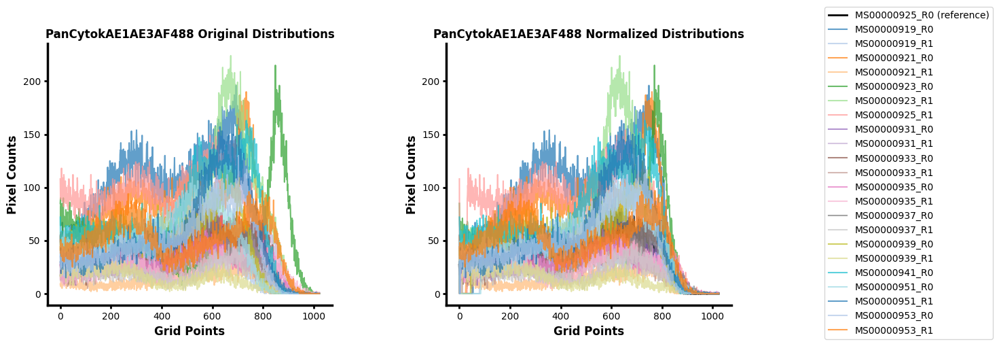


-------------------- Processing marker 'p-c-Jun-D47G9AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [3, -28, 17, 1, 30, 0, -59, 11, 21, -4, 5, 33, -54, -14, -29, -7, -20, -16, 9, -4, -18, -11, -9]
✨ Auto-computed reference landmark for 'p-c-Jun-D47G9AF555' on 'MS00000923_R1': 404
✨ Implied landmark positions for 'p-c-Jun-D47G9AF555': [407, 376, 421, 405, 434, 404, 345, 415, 425, 400, 409, 437, 350, 390, 375, 397, 384, 388, 413, 400, 386, 393, 395]


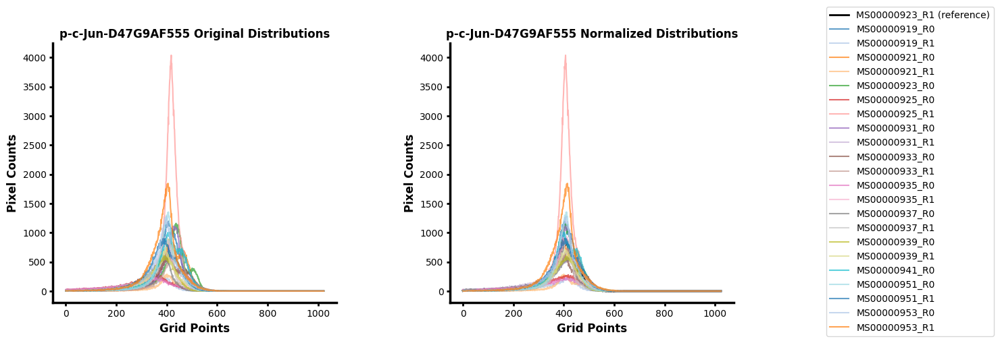


-------------------- Processing marker 'CD207-7430AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [-11, -18, -3, -3, 2, -3, -23, -6, 5, 0, 0, 5, -15, -4, -8, 1, -24, -18, -3, -20, -21, 1, 1]
✨ Auto-computed reference landmark for 'CD207-7430AF647' on 'MS00000931_R1': 417
✨ Implied landmark positions for 'CD207-7430AF647': [406, 399, 414, 414, 419, 414, 394, 411, 422, 417, 417, 422, 402, 413, 409, 418, 393, 399, 414, 397, 396, 418, 418]


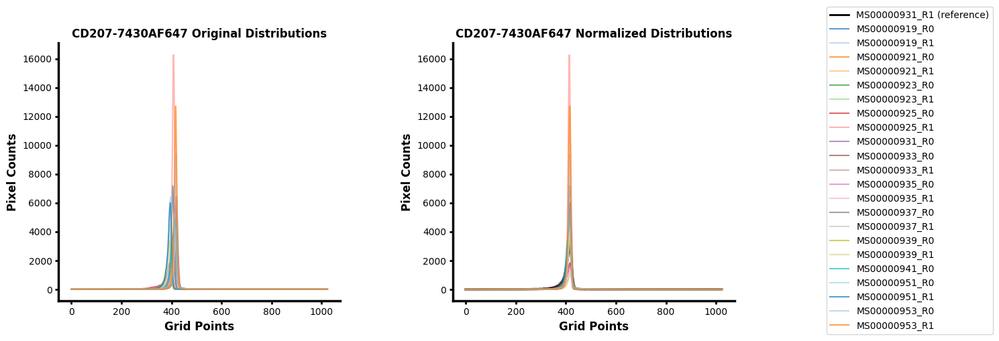


-------------------- Processing marker 'CD1c-OTI2F4AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R1' by histogram proximity 

✨ Computed shifts: [0, -7, -37, -49, 9, -19, -14, 4, 11, 0, 14, 21, -8, 0, -96, -82, -25, -21, -15, -37, -30, 0, 8]
✨ Auto-computed reference landmark for 'CD1c-OTI2F4AF750' on 'MS00000935_R1': 561
✨ Implied landmark positions for 'CD1c-OTI2F4AF750': [561, 554, 524, 512, 570, 542, 547, 565, 572, 561, 575, 582, 553, 561, 465, 479, 536, 540, 546, 524, 531, 561, 569]


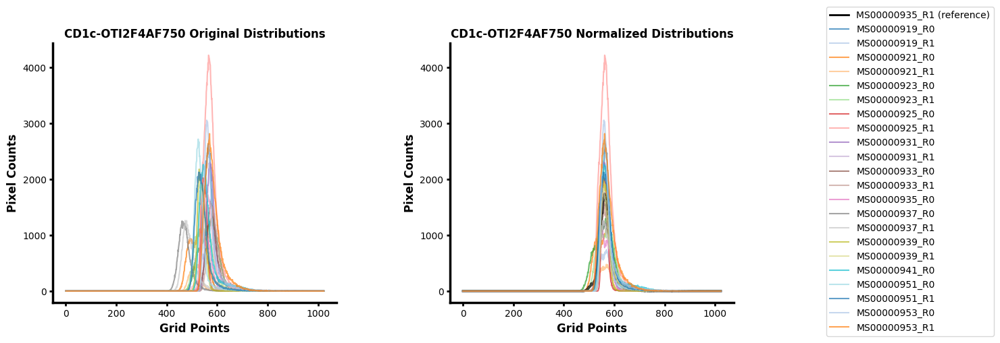


-------------------- Processing marker 'PDPN-LpMab-12AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-22, -31, -42, 0, 52, -56, -74, 68, 67, -11, -17, 21, -50, 39, 40, 81, -97, 0, 12, 28, 34, -7, 34]
✨ Auto-computed reference landmark for 'PDPN-LpMab-12AF488' on 'MS00000939_R1': 508
✨ Implied landmark positions for 'PDPN-LpMab-12AF488': [486, 477, 466, 508, 560, 452, 434, 576, 575, 497, 491, 529, 458, 547, 548, 589, 411, 508, 520, 536, 542, 501, 542]


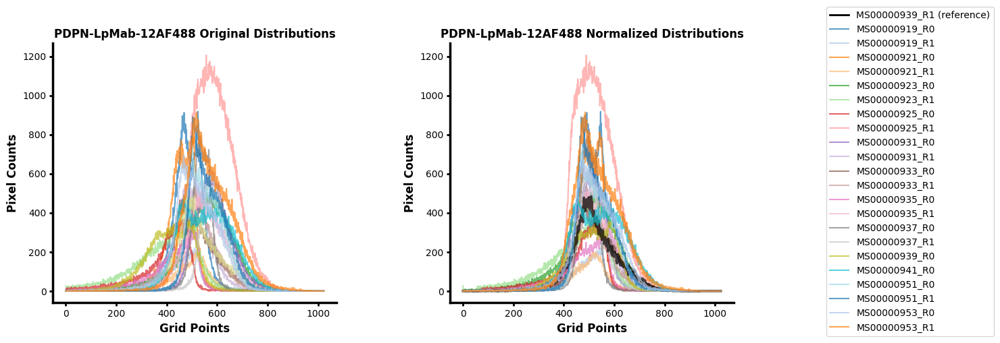


-------------------- Processing marker 'pmTORS2448-49F9AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [26, 3, -16, -12, 37, 30, -18, 11, 65, 27, 0, 11, -23, -13, 70, 61, -25, -18, 14, 3, 9, -15, -10]
✨ Auto-computed reference landmark for 'pmTORS2448-49F9AF555' on 'MS00000933_R0': 603
✨ Implied landmark positions for 'pmTORS2448-49F9AF555': [629, 606, 587, 591, 640, 633, 585, 614, 668, 630, 603, 614, 580, 590, 673, 664, 578, 585, 617, 606, 612, 588, 593]


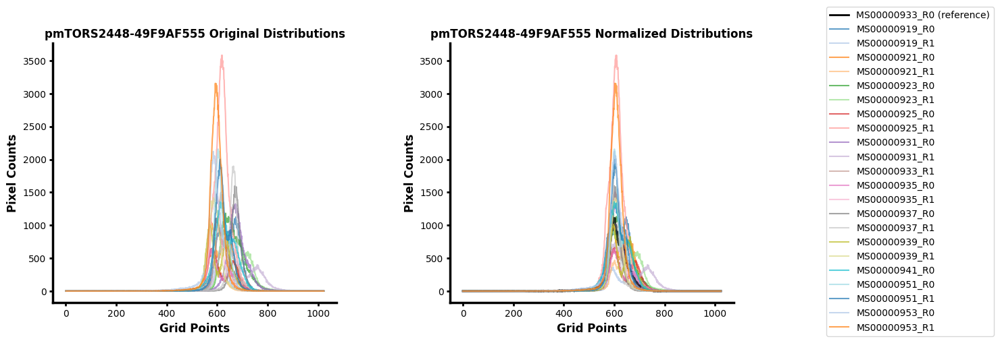


-------------------- Processing marker 'FoxP3-D2W8EAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [41, 35, -17, -21, 61, 55, -1, 8, 24, 0, 17, 27, -25, -23, 182, 180, -14, 3, -17, 22, 22, -18, -10]
✨ Auto-computed reference landmark for 'FoxP3-D2W8EAF647' on 'MS00000931_R1': 484
✨ Implied landmark positions for 'FoxP3-D2W8EAF647': [525, 519, 467, 463, 545, 539, 483, 492, 508, 484, 501, 511, 459, 461, 666, 664, 470, 487, 467, 506, 506, 466, 474]


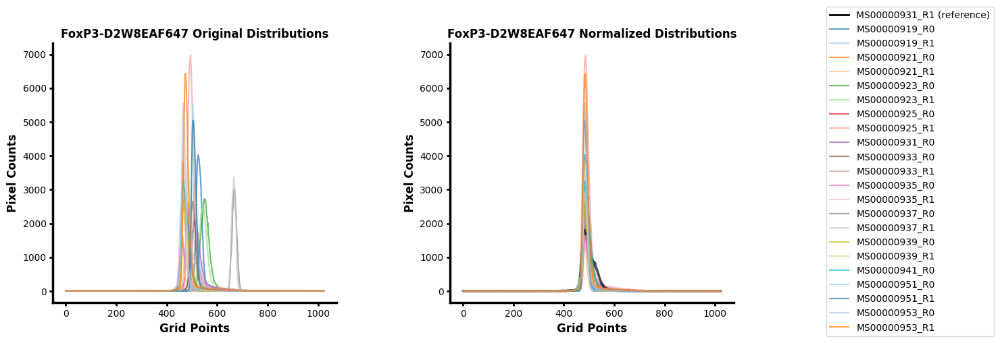


-------------------- Processing marker 'EphB2-D2X2IAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [51, 46, -9, -19, 67, 62, 11, 12, 24, 23, 21, 27, 2, -10, 189, 186, 0, 4, -11, 16, 17, -4, -6]
✨ Auto-computed reference landmark for 'EphB2-D2X2IAF750' on 'MS00000939_R0': 409
✨ Implied landmark positions for 'EphB2-D2X2IAF750': [460, 455, 400, 390, 476, 471, 420, 421, 433, 432, 430, 436, 411, 399, 598, 595, 409, 413, 398, 425, 426, 405, 403]


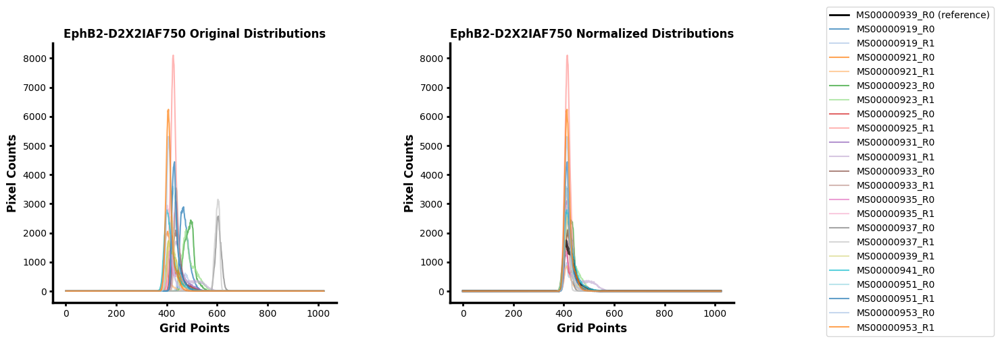


-------------------- Processing marker 'Periostin-E5F2SAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [-6, 1, 0, -110, -174, 0, 103, 69, -195, -112, -120, -144, 48, -152, -11, -184, -4, -80, -94, -135, -167, -158, -233]
✨ Auto-computed reference landmark for 'Periostin-E5F2SAF488' on 'MS00000923_R1': 615
✨ Implied landmark positions for 'Periostin-E5F2SAF488': [609, 616, 615, 505, 441, 615, 718, 684, 420, 503, 495, 471, 663, 463, 604, 431, 611, 535, 521, 480, 448, 457, 382]


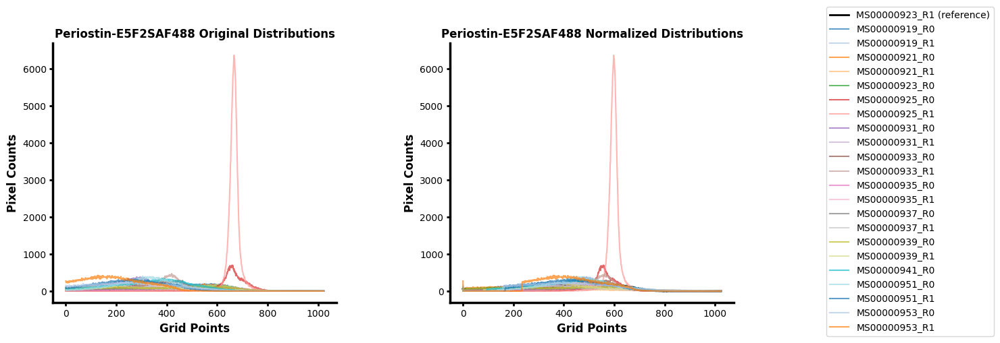


-------------------- Processing marker 'p-NF-kB-178F3AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [23, 14, 10, 4, 12, 10, 261, 258, 6, 0, 14, 16, 18, 8, -21, -27, 0, -7, 11, -1, -10, 0, -3]
✨ Auto-computed reference landmark for 'p-NF-kB-178F3AF555' on 'MS00000939_R0': 533
✨ Implied landmark positions for 'p-NF-kB-178F3AF555': [556, 547, 543, 537, 545, 543, 794, 791, 539, 533, 547, 549, 551, 541, 512, 506, 533, 526, 544, 532, 523, 533, 530]


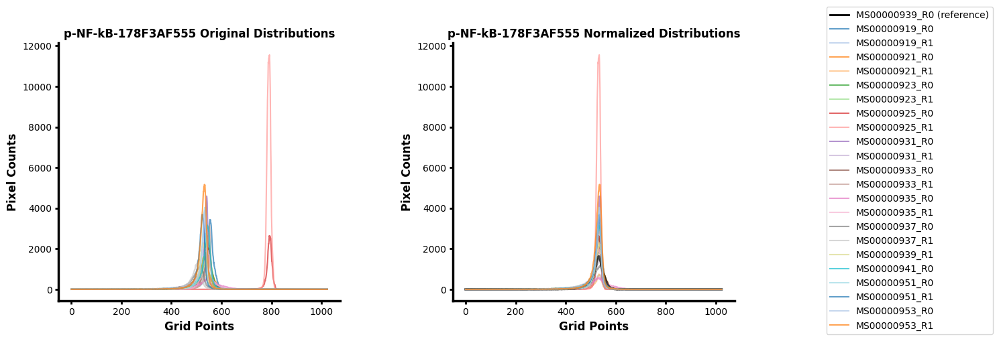


-------------------- Processing marker 'Ki67-D2H10AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [9, 12, -1, 0, 3, -2, 227, 225, 0, -4, 0, 2, 1, 3, -20, -20, -9, -9, 6, -7, -3, -7, -12]
✨ Auto-computed reference landmark for 'Ki67-D2H10AF647' on 'MS00000933_R0': 458
✨ Implied landmark positions for 'Ki67-D2H10AF647': [467, 470, 457, 458, 461, 456, 685, 683, 458, 454, 458, 460, 459, 461, 438, 438, 449, 449, 464, 451, 455, 451, 446]


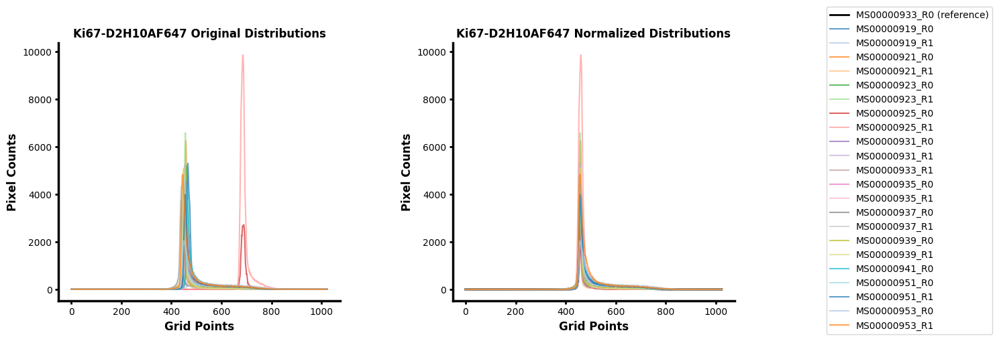


-------------------- Processing marker 'CD209-1781AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R0' by histogram proximity 

✨ Computed shifts: [39, 43, 21, 16, 6, 0, 461, 448, -4, -15, 50, 51, 0, -15, -97, -128, -17, -22, 24, 2, -11, -72, -97]
✨ Auto-computed reference landmark for 'CD209-1781AF750' on 'MS00000935_R0': 427
✨ Implied landmark positions for 'CD209-1781AF750': [466, 470, 448, 443, 433, 427, 888, 875, 423, 412, 477, 478, 427, 412, 330, 299, 410, 405, 451, 429, 416, 355, 330]


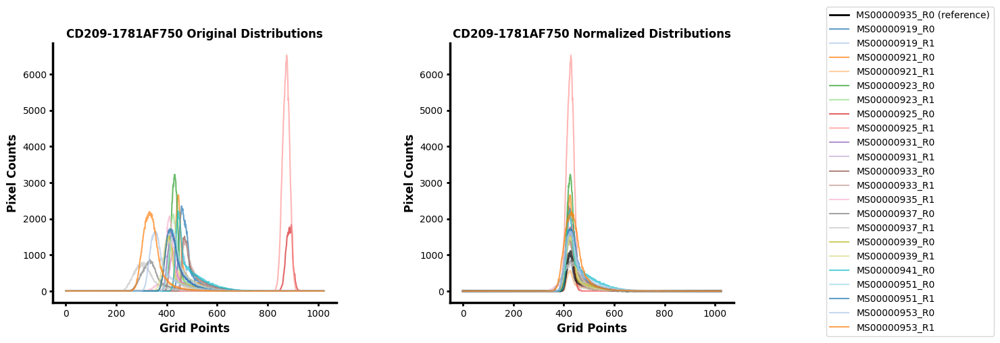


-------------------- Processing marker 'CD90-E3V8AAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [17, -23, -55, 49, 81, -47, -35, 87, 81, 0, -31, 13, -30, 33, -34, 44, -89, 70, 7, 24, 22, -58, 19]
✨ Auto-computed reference landmark for 'CD90-E3V8AAF488' on 'MS00000931_R1': 532
✨ Implied landmark positions for 'CD90-E3V8AAF488': [549, 509, 477, 581, 613, 485, 497, 619, 613, 532, 501, 545, 502, 565, 498, 576, 443, 602, 539, 556, 554, 474, 551]


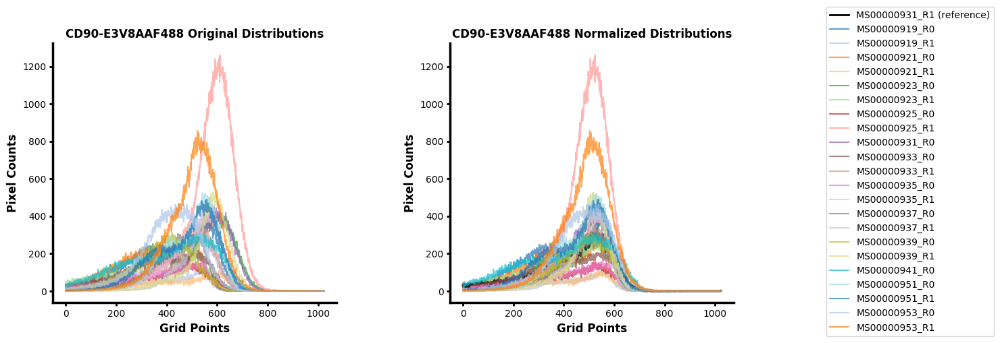


-------------------- Processing marker 'IRF-8-E6J8QAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [-5, -13, 65, 59, -7, -16, -21, 1, 0, -9, 11, 17, 9, 14, 6, 8, 80, 74, -14, 10, 6, 3, 4]
✨ Auto-computed reference landmark for 'IRF-8-E6J8QAF555' on 'MS00000931_R0': 526
✨ Implied landmark positions for 'IRF-8-E6J8QAF555': [521, 513, 591, 585, 519, 510, 505, 527, 526, 517, 537, 543, 535, 540, 532, 534, 606, 600, 512, 536, 532, 529, 530]


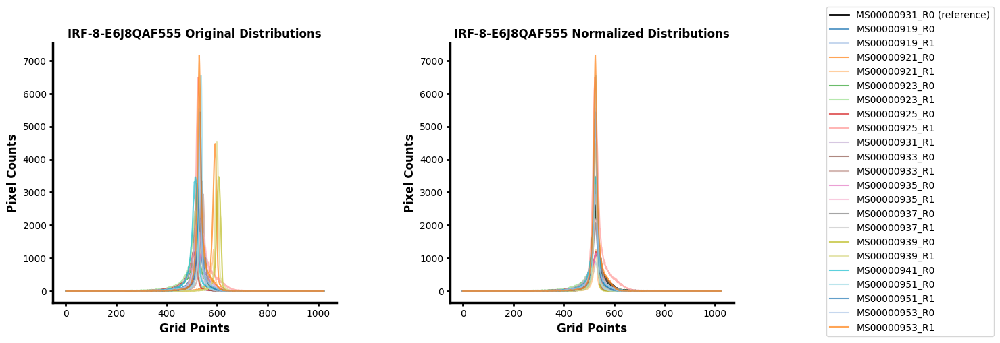


-------------------- Processing marker 'IL-1beta-3A6AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [-7, -15, 113, 102, -5, -5, -11, -1, -14, 0, 39, 38, 29, 23, 10, 11, 124, 112, -12, 19, 15, 2, 8]
✨ Auto-computed reference landmark for 'IL-1beta-3A6AF647' on 'MS00000931_R1': 516
✨ Implied landmark positions for 'IL-1beta-3A6AF647': [509, 501, 629, 618, 511, 511, 505, 515, 502, 516, 555, 554, 545, 539, 526, 527, 640, 628, 504, 535, 531, 518, 524]


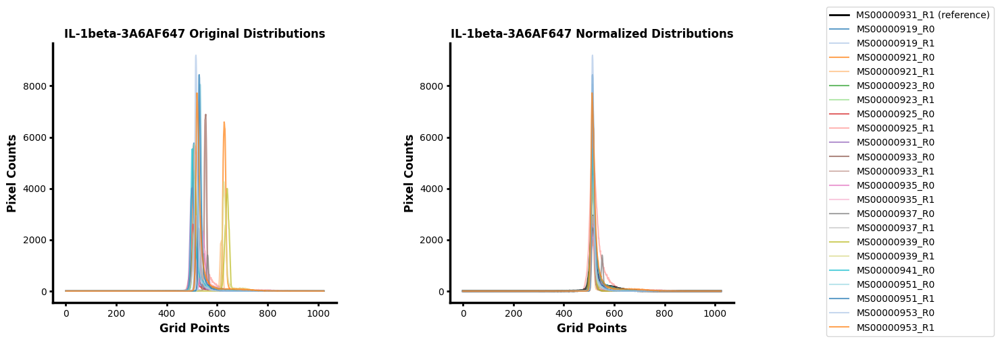


-------------------- Processing marker 'CD103-3904RAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000937_R0' by histogram proximity 

✨ Computed shifts: [-16, -24, 159, 143, 21, 19, -31, -32, -13, -19, 79, 76, 90, 83, 0, -7, 184, 166, -8, 32, 21, 8, -3]
✨ Auto-computed reference landmark for 'CD103-3904RAF750' on 'MS00000937_R0': 443
✨ Implied landmark positions for 'CD103-3904RAF750': [427, 419, 602, 586, 464, 462, 412, 411, 430, 424, 522, 519, 533, 526, 443, 436, 627, 609, 435, 475, 464, 451, 440]


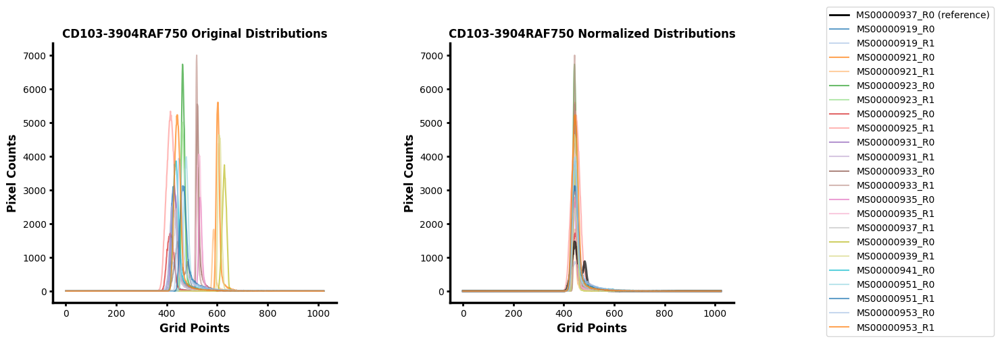


-------------------- Processing marker 'SOD2-D3X8FAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-71, -99, -52, -19, 60, -32, -78, 34, 37, -61, 0, -1, -29, 32, -133, -54, -77, 74, 58, -23, -21, -11, 17]
✨ Auto-computed reference landmark for 'SOD2-D3X8FAF488' on 'MS00000933_R0': 513
✨ Implied landmark positions for 'SOD2-D3X8FAF488': [442, 414, 461, 494, 573, 481, 435, 547, 550, 452, 513, 512, 484, 545, 380, 459, 436, 587, 571, 490, 492, 502, 530]


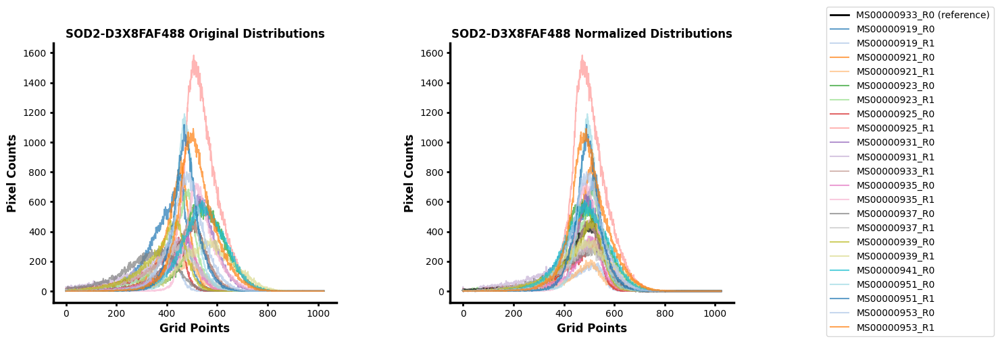


-------------------- Processing marker 'p-p38MAPK-D3F9AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000923_R1' by histogram proximity 

✨ Computed shifts: [7, 0, 1, -2, -1, 0, -3, -5, -1, 3, 2, 2, 11, 7, -8, -6, -1, -4, 7, -3, -2, 0, -2]
✨ Auto-computed reference landmark for 'p-p38MAPK-D3F9AF647' on 'MS00000923_R1': 477
✨ Implied landmark positions for 'p-p38MAPK-D3F9AF647': [484, 477, 478, 475, 476, 477, 474, 472, 476, 480, 479, 479, 488, 484, 469, 471, 476, 473, 484, 474, 475, 477, 475]


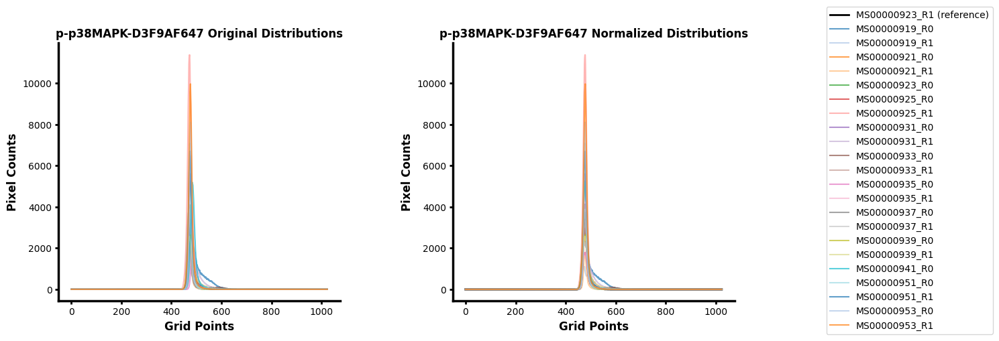


-------------------- Processing marker 'PU1-2146AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [18, 17, 3, -3, 9, 5, 0, -8, 38, 35, -30, -28, 10, -1, -20, -29, 0, -8, 22, -39, -49, 7, 1]
✨ Auto-computed reference landmark for 'PU1-2146AF750' on 'MS00000925_R0': 327
✨ Implied landmark positions for 'PU1-2146AF750': [345, 344, 330, 324, 336, 332, 327, 319, 365, 362, 297, 299, 337, 326, 307, 298, 327, 319, 349, 288, 278, 334, 328]


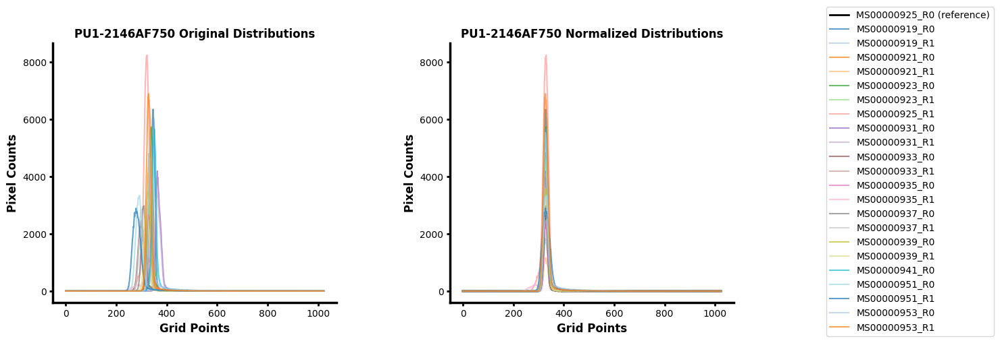


-------------------- Processing marker 'S100A12-OTI1D1AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [23, 11, 17, 35, -69, -105, -63, 16, 43, 0, -85, -31, 15, 63, -128, -151, -154, -144, -89, 4, -27, -27, 25]
✨ Auto-computed reference landmark for 'S100A12-OTI1D1AF488' on 'MS00000931_R1': 399
✨ Implied landmark positions for 'S100A12-OTI1D1AF488': [422, 410, 416, 434, 330, 294, 336, 415, 442, 399, 314, 368, 414, 462, 271, 248, 245, 255, 310, 403, 372, 372, 424]


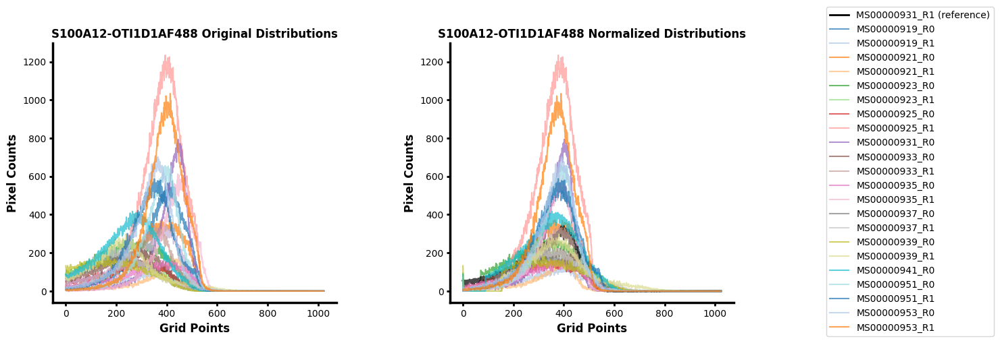


-------------------- Processing marker 'MMP-9-D6O3HAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-1, -4, -2, 2, -6, -19, -11, 25, 12, -11, 0, 16, 2, 24, -15, -3, -16, 1, -13, 1, 2, 1, 18]
✨ Auto-computed reference landmark for 'MMP-9-D6O3HAF555' on 'MS00000933_R0': 455
✨ Implied landmark positions for 'MMP-9-D6O3HAF555': [454, 451, 453, 457, 449, 436, 444, 480, 467, 444, 455, 471, 457, 479, 440, 452, 439, 456, 442, 456, 457, 456, 473]


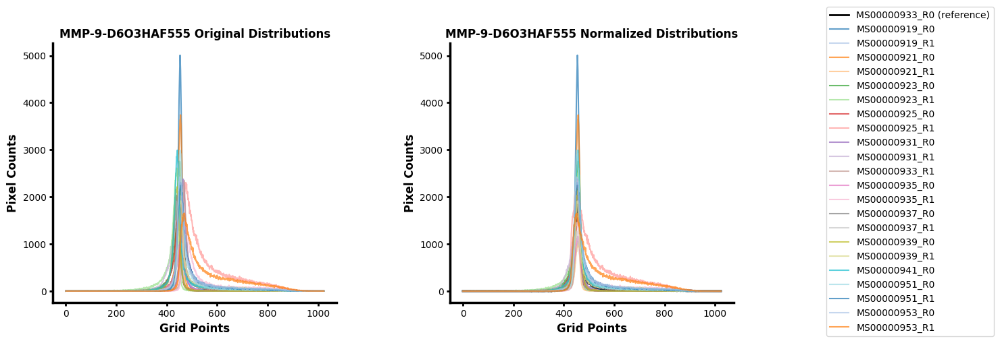


-------------------- Processing marker 'CD11c-D3V1EAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-2, -2, -8, -6, -5, -7, 6, 9, -6, -10, -2, 0, 2, 3, -1, 1, -4, 0, -9, 7, 6, -46, -30]
✨ Auto-computed reference landmark for 'CD11c-D3V1EAF647' on 'MS00000939_R1': 496
✨ Implied landmark positions for 'CD11c-D3V1EAF647': [494, 494, 488, 490, 491, 489, 502, 505, 490, 486, 494, 496, 498, 499, 495, 497, 492, 496, 487, 503, 502, 450, 466]


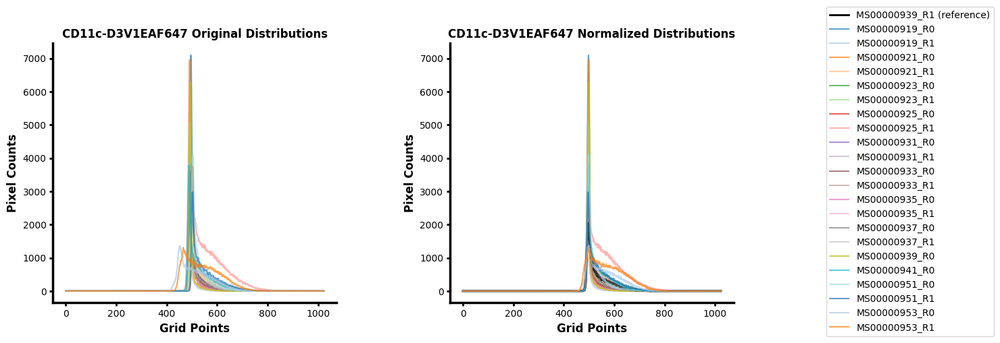


-------------------- Processing marker 'PD-1-D4W2JAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [11, 8, -4, -7, 32, 32, 16, 16, 0, -14, 15, 16, 9, 4, -15, -22, 4, 0, -4, 21, 10, -5, -6]
✨ Auto-computed reference landmark for 'PD-1-D4W2JAF750' on 'MS00000931_R0': 407
✨ Implied landmark positions for 'PD-1-D4W2JAF750': [418, 415, 403, 400, 439, 439, 423, 423, 407, 393, 422, 423, 416, 411, 392, 385, 411, 407, 403, 428, 417, 402, 401]


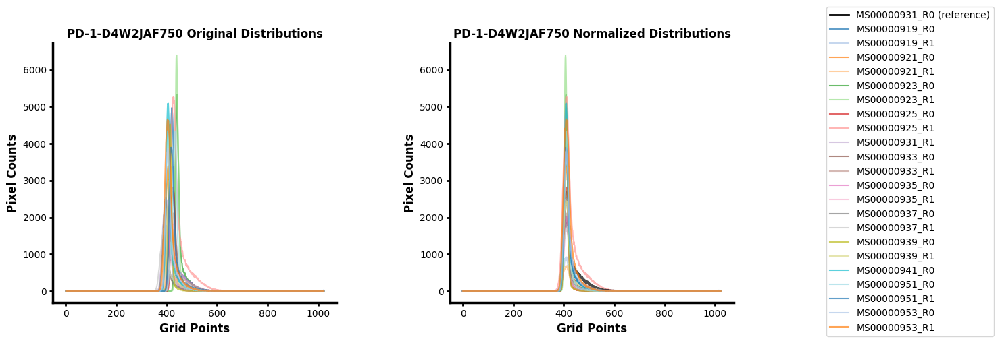


-------------------- Processing marker 'IDO-D5J4EAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [-4, -21, 0, 14, -69, -111, 69, 138, 27, -52, -98, -46, -43, 18, -14, -3, 36, 64, -6, 86, 98, -52, -2]
✨ Auto-computed reference landmark for 'IDO-D5J4EAF488' on 'MS00000921_R0': 337
✨ Implied landmark positions for 'IDO-D5J4EAF488': [333, 316, 337, 351, 268, 226, 406, 475, 364, 285, 239, 291, 294, 355, 323, 334, 373, 401, 331, 423, 435, 285, 335]


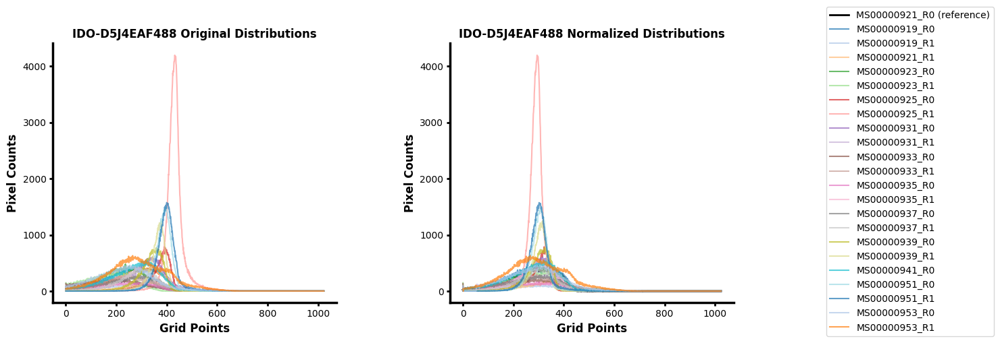


-------------------- Processing marker 'YKL-40-E2L1MAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-5, -9, -3, 3, 3, -6, 7, 34, 10, -5, -5, 0, -16, 36, 40, 62, 3, 18, 10, 29, 27, 18, 29]
✨ Auto-computed reference landmark for 'YKL-40-E2L1MAF555' on 'MS00000933_R1': 527
✨ Implied landmark positions for 'YKL-40-E2L1MAF555': [522, 518, 524, 530, 530, 521, 534, 561, 537, 522, 522, 527, 511, 563, 567, 589, 530, 545, 537, 556, 554, 545, 556]


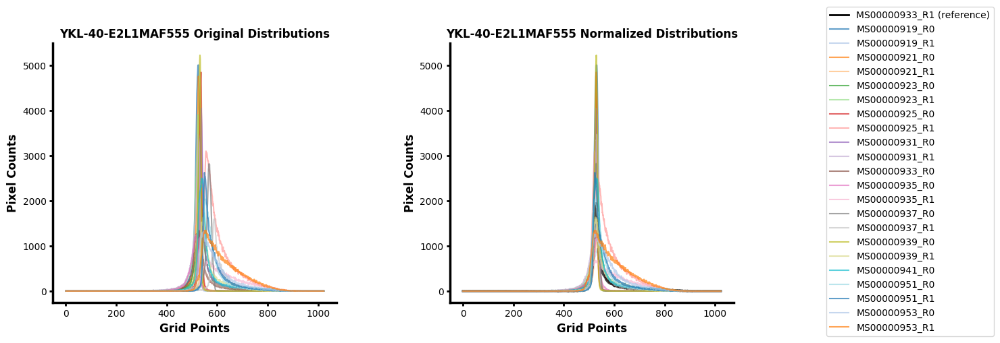


-------------------- Processing marker 'IRF-1-D5E4AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R0' by histogram proximity 

✨ Computed shifts: [-13, -20, -22, -17, -5, -7, -17, 3, 0, -9, 9, 14, -11, -8, 28, 38, -21, -21, 7, 5, 8, -4, 1]
✨ Auto-computed reference landmark for 'IRF-1-D5E4AF647' on 'MS00000931_R0': 488
✨ Implied landmark positions for 'IRF-1-D5E4AF647': [475, 468, 466, 471, 483, 481, 471, 491, 488, 479, 497, 502, 477, 480, 516, 526, 467, 467, 495, 493, 496, 484, 489]


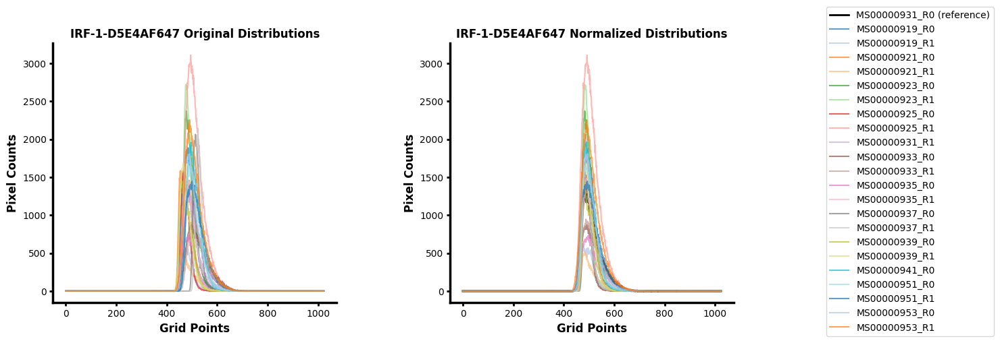


-------------------- Processing marker 'IFITM3-D8E8GAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-23, -24, -3, 4, -27, -53, -51, -23, 17, 22, 9, 0, 1, -24, 9, 26, -33, -17, 24, 9, 12, 7, 7]
✨ Auto-computed reference landmark for 'IFITM3-D8E8GAF750' on 'MS00000933_R1': 463
✨ Implied landmark positions for 'IFITM3-D8E8GAF750': [440, 439, 460, 467, 436, 410, 412, 440, 480, 485, 472, 463, 464, 439, 472, 489, 430, 446, 487, 472, 475, 470, 470]


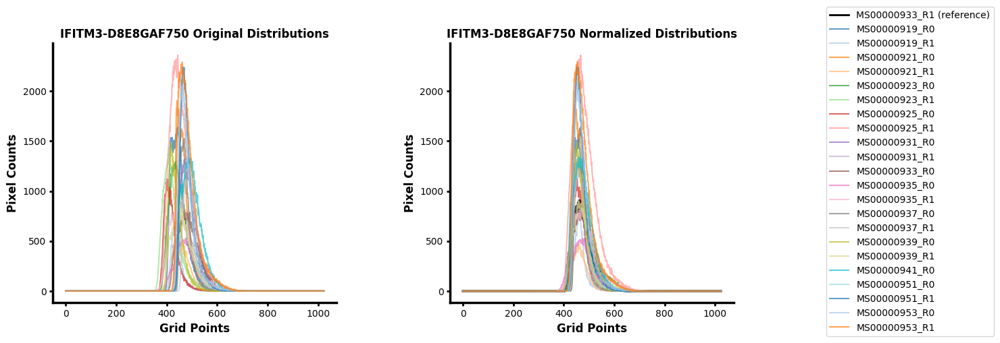


-------------------- Processing marker 'CD7-E4G1QAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R0' by histogram proximity 

✨ Computed shifts: [-23, -3, -43, -19, 52, 9, -63, 30, 20, -40, -54, 53, -16, 32, -127, -66, 0, 53, -159, -14, -14, -136, -89]
✨ Auto-computed reference landmark for 'CD7-E4G1QAF488' on 'MS00000939_R0': 429
✨ Implied landmark positions for 'CD7-E4G1QAF488': [406, 426, 386, 410, 481, 438, 366, 459, 449, 389, 375, 482, 413, 461, 302, 363, 429, 482, 270, 415, 415, 293, 340]


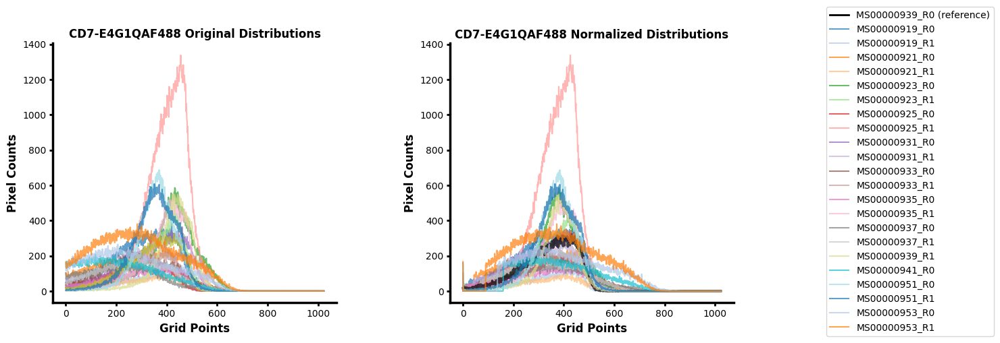


-------------------- Processing marker 'GITR-D5V7PAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-2, 6, -11, -1, 29, 23, 4, 16, 11, 8, -11, 0, -2, 14, -20, -9, 18, 31, -19, 12, 10, -11, -8]
✨ Auto-computed reference landmark for 'GITR-D5V7PAF555' on 'MS00000933_R1': 467
✨ Implied landmark positions for 'GITR-D5V7PAF555': [465, 473, 456, 466, 496, 490, 471, 483, 478, 475, 456, 467, 465, 481, 447, 458, 485, 498, 448, 479, 477, 456, 459]


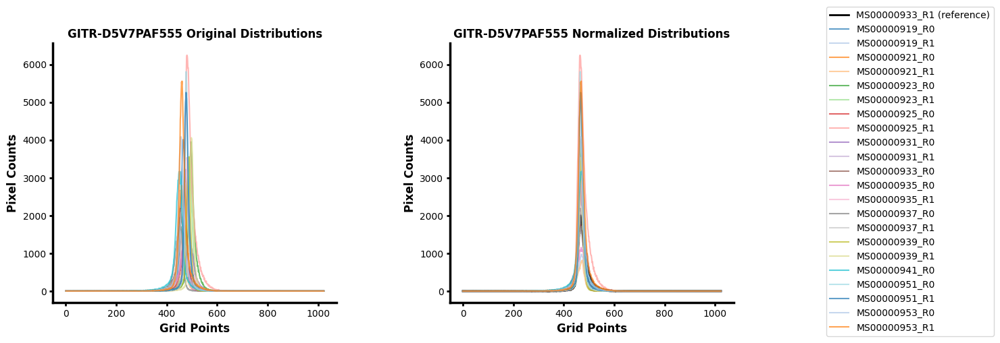


-------------------- Processing marker 'pSTAT1Ty70158D6AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-16, -3, -10, 2, 85, 79, 17, 30, 9, 3, -5, 0, -2, 11, -17, -5, 56, 70, -4, 33, 33, -2, 3]
✨ Auto-computed reference landmark for 'pSTAT1Ty70158D6AF647' on 'MS00000933_R1': 472
✨ Implied landmark positions for 'pSTAT1Ty70158D6AF647': [456, 469, 462, 474, 557, 551, 489, 502, 481, 475, 467, 472, 470, 483, 455, 467, 528, 542, 468, 505, 505, 470, 475]


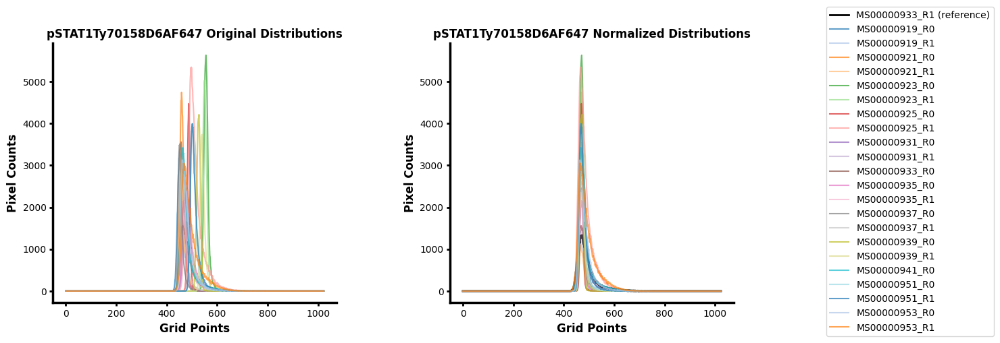


-------------------- Processing marker 'IRF-4-E8H3SAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [18, 42, 25, 35, 160, 157, 64, 69, 43, 57, -8, 0, 37, 48, 13, 27, 117, 135, 31, 82, 78, -2, -2]
✨ Auto-computed reference landmark for 'IRF-4-E8H3SAF750' on 'MS00000933_R1': 239
✨ Implied landmark positions for 'IRF-4-E8H3SAF750': [257, 281, 264, 274, 399, 396, 303, 308, 282, 296, 231, 239, 276, 287, 252, 266, 356, 374, 270, 321, 317, 237, 237]


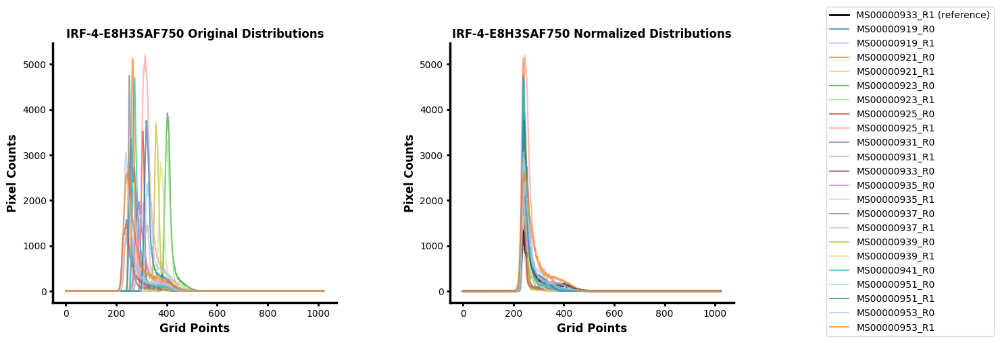


-------------------- Processing marker 'CD14-D7A2TAF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000931_R1' by histogram proximity 

✨ Computed shifts: [0, 16, -40, 6, 1, -42, -55, 43, 21, 0, -2, -32, 6, 39, -30, 27, -89, -4, 81, 58, 78, 100, 75]
✨ Auto-computed reference landmark for 'CD14-D7A2TAF488' on 'MS00000931_R1': 510
✨ Implied landmark positions for 'CD14-D7A2TAF488': [510, 526, 470, 516, 511, 468, 455, 553, 531, 510, 508, 478, 516, 549, 480, 537, 421, 506, 591, 568, 588, 610, 585]


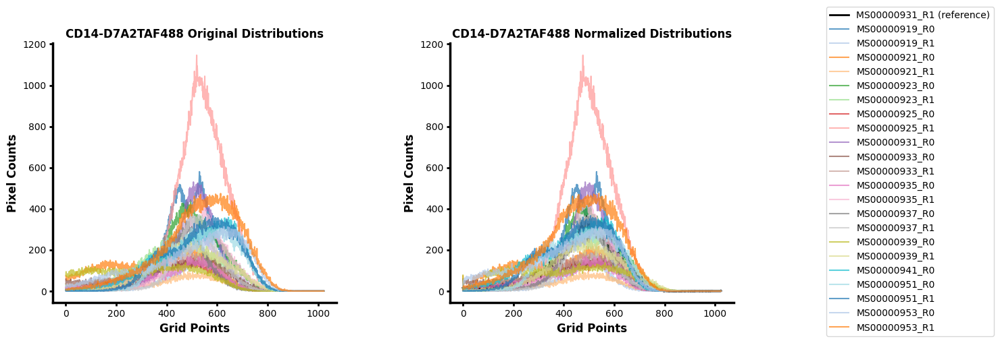


-------------------- Processing marker 'T-bet-E4I2KAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [10, 14, -12, -2, 1, -6, -10, 7, 28, 24, -12, 0, 98, 107, 7, 16, -11, 2, -3, -2, -2, 2, 8]
✨ Auto-computed reference landmark for 'T-bet-E4I2KAF555' on 'MS00000933_R1': 542
✨ Implied landmark positions for 'T-bet-E4I2KAF555': [552, 556, 530, 540, 543, 536, 532, 549, 570, 566, 530, 542, 640, 649, 549, 558, 531, 544, 539, 540, 540, 544, 550]


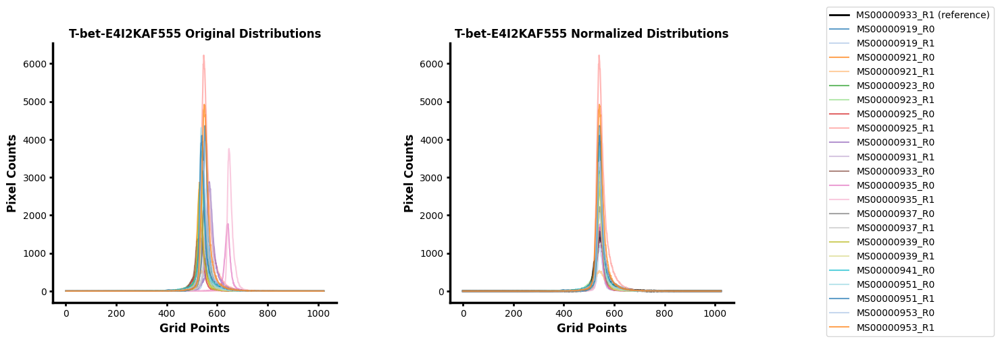


-------------------- Processing marker 'pSTAT1s727-D3B7AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [3, -5, 1, 9, 11, 5, -3, 4, 74, 66, 48, 55, 100, 100, 1, 4, -4, 0, 5, 41, 60, 41, 41]
✨ Auto-computed reference landmark for 'pSTAT1s727-D3B7AF647' on 'MS00000939_R1': 457
✨ Implied landmark positions for 'pSTAT1s727-D3B7AF647': [460, 452, 458, 466, 468, 462, 454, 461, 531, 523, 505, 512, 557, 557, 458, 461, 453, 457, 462, 498, 517, 498, 498]


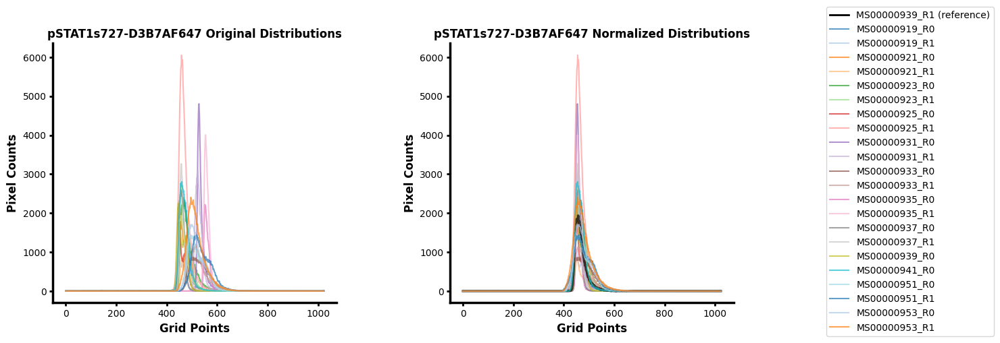


-------------------- Processing marker 'ClvCasp-3-58A1EAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [27, 24, -30, -46, 3, 2, 0, -2, 91, 95, 36, 41, 27, 19, -21, -23, -14, -35, 4, 14, 11, 19, 28]
✨ Auto-computed reference landmark for 'ClvCasp-3-58A1EAF750' on 'MS00000925_R0': 540
✨ Implied landmark positions for 'ClvCasp-3-58A1EAF750': [567, 564, 510, 494, 543, 542, 540, 538, 631, 635, 576, 581, 567, 559, 519, 517, 526, 505, 544, 554, 551, 559, 568]


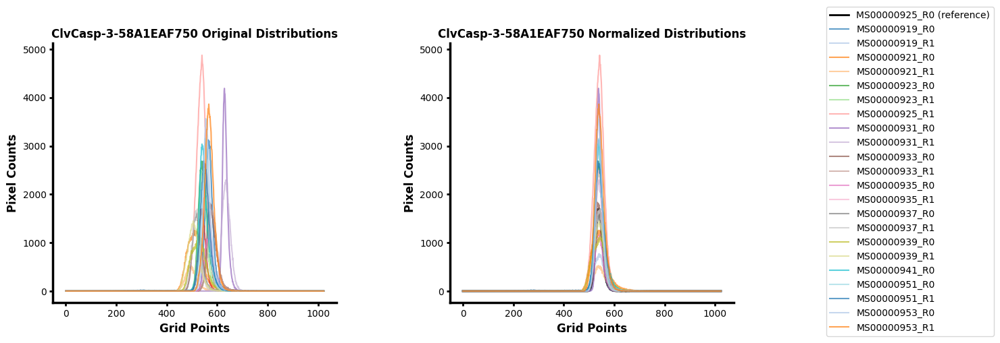


-------------------- Processing marker 'SMA-1A4AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [-1, 4, 0, -10, 10, 51, 40, 57, -131, -18, 80, 132, 63, 41, -22, 8, -2, 4, 3, 44, 37, -49, -11]
✨ Auto-computed reference landmark for 'SMA-1A4AF488' on 'MS00000921_R0': 346
✨ Implied landmark positions for 'SMA-1A4AF488': [345, 350, 346, 336, 356, 397, 386, 403, 215, 328, 426, 478, 409, 387, 324, 354, 344, 350, 349, 390, 383, 297, 335]


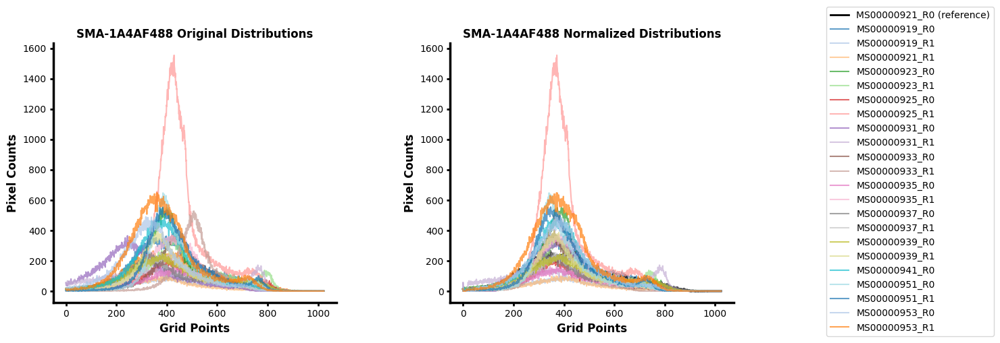


-------------------- Processing marker 'NAkATPaseEP1845Y555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000937_R1' by histogram proximity 

✨ Computed shifts: [-13, -36, -8, -10, -4, -14, -30, 4, -54, -53, 30, 31, -55, -44, -25, 0, -4, 17, -17, 22, 15, -8, 2]
✨ Auto-computed reference landmark for 'NAkATPaseEP1845Y555' on 'MS00000937_R1': 551
✨ Implied landmark positions for 'NAkATPaseEP1845Y555': [538, 515, 543, 541, 547, 537, 521, 555, 497, 498, 581, 582, 496, 507, 526, 551, 547, 568, 534, 573, 566, 543, 553]


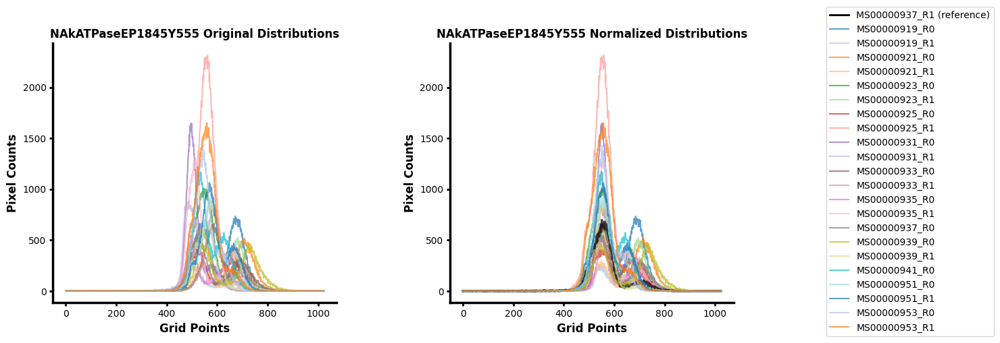


-------------------- Processing marker 'HLADR-LN3AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000951_R0' by histogram proximity 

✨ Computed shifts: [-7, -7, 2, 1, 1, -4, 0, 0, -13, -16, 5, 4, 10, 14, -9, -8, -2, -3, -4, 0, 3, 3, 2]
✨ Auto-computed reference landmark for 'HLADR-LN3AF647' on 'MS00000951_R0': 498
✨ Implied landmark positions for 'HLADR-LN3AF647': [491, 491, 500, 499, 499, 494, 498, 498, 485, 482, 503, 502, 508, 512, 489, 490, 496, 495, 494, 498, 501, 501, 500]


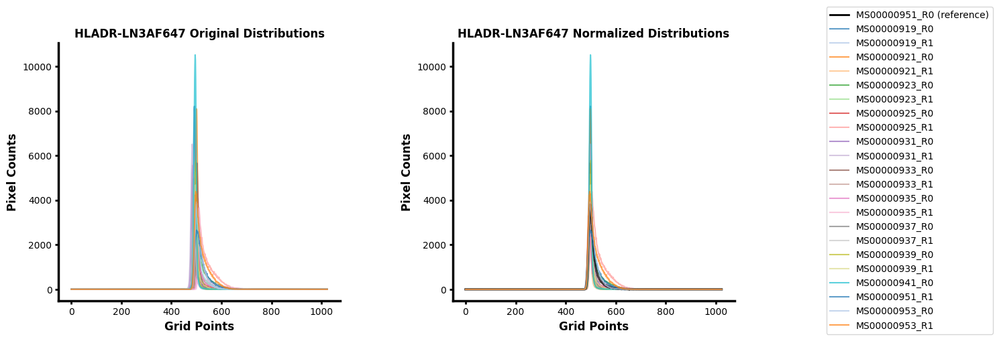


-------------------- Processing marker 'CD452B11PD726AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-23, -25, -6, -2, 3, -2, 26, 26, 17, -1, 55, 63, 130, 129, 0, 0, -9, 0, -1, -14, -8, 10, 16]
✨ Auto-computed reference landmark for 'CD452B11PD726AF750' on 'MS00000939_R1': 460
✨ Implied landmark positions for 'CD452B11PD726AF750': [437, 435, 454, 458, 463, 458, 486, 486, 477, 459, 515, 523, 590, 589, 460, 460, 451, 460, 459, 446, 452, 470, 476]


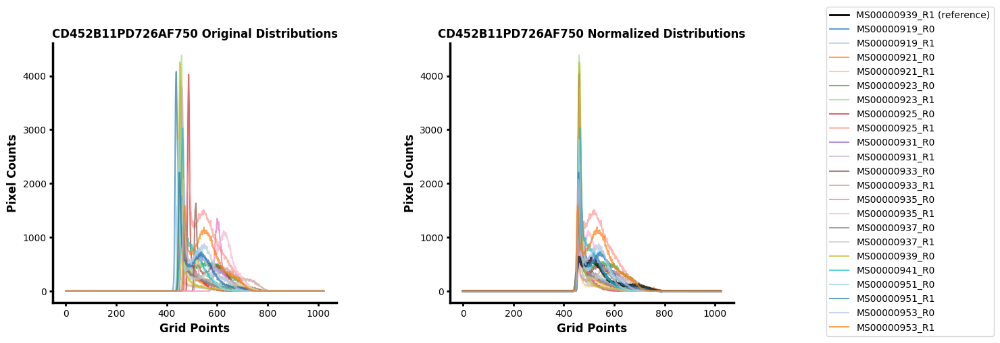


-------------------- Processing marker 'CD4EPR6855AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000939_R1' by histogram proximity 

✨ Computed shifts: [-3, 10, -48, -30, 6, 3, -28, -9, 4, -10, -21, 9, -11, 1, -14, -6, -16, 0, -16, -16, -17, 11, 16]
✨ Auto-computed reference landmark for 'CD4EPR6855AF555' on 'MS00000939_R1': 442
✨ Implied landmark positions for 'CD4EPR6855AF555': [439, 452, 394, 412, 448, 445, 414, 433, 446, 432, 421, 451, 431, 443, 428, 436, 426, 442, 426, 426, 425, 453, 458]


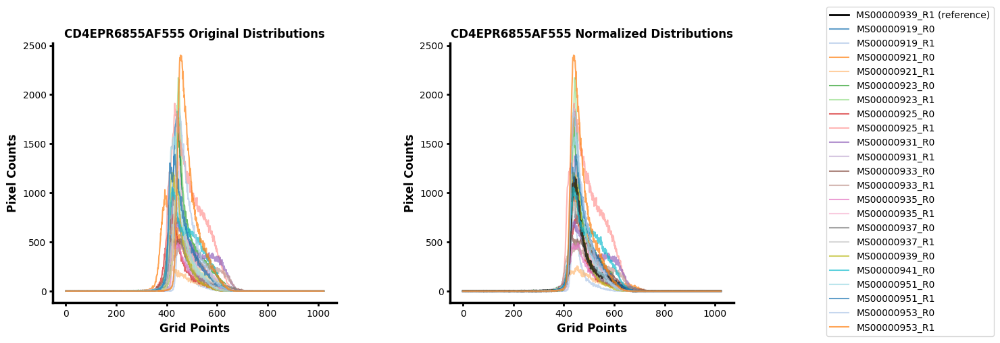


-------------------- Processing marker 'CD20-E7B7TAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-1, -1, -3, -1, 3, -2, 1, 6, 9, 3, 0, 11, 0, 3, 3, 7, 0, 5, -4, -7, -5, 2, 5]
✨ Auto-computed reference landmark for 'CD20-E7B7TAF647' on 'MS00000933_R0': 425
✨ Implied landmark positions for 'CD20-E7B7TAF647': [424, 424, 422, 424, 428, 423, 426, 431, 434, 428, 425, 436, 425, 428, 428, 432, 425, 430, 421, 418, 420, 427, 430]


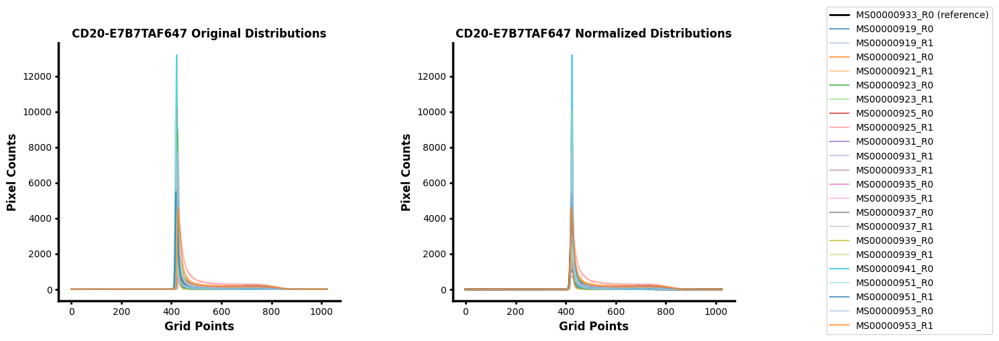


-------------------- Processing marker 'CD16-DJ130cAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-28, -39, -24, -28, 14, 9, -28, -15, 9, -11, 0, -1, -5, -5, 102, 103, 38, 38, 13, -26, -27, -42, -41]
✨ Auto-computed reference landmark for 'CD16-DJ130cAF750' on 'MS00000933_R0': 491
✨ Implied landmark positions for 'CD16-DJ130cAF750': [463, 452, 467, 463, 505, 500, 463, 476, 500, 480, 491, 490, 486, 486, 593, 594, 529, 529, 504, 465, 464, 449, 450]


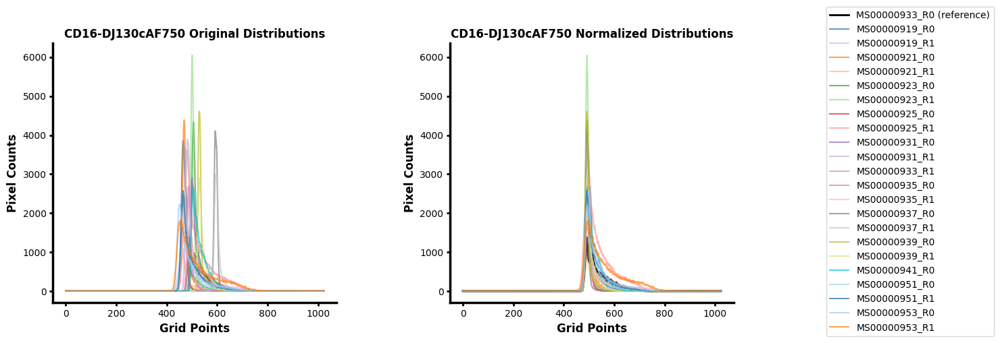


-------------------- Processing marker 'CD27-EPR8569AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [-4, -8, -45, -26, -10, -30, 7, 17, 17, 8, 0, 9, -18, 12, 3, 16, 16, 24, 8, 29, 28, -2, 3]
✨ Auto-computed reference landmark for 'CD27-EPR8569AF555' on 'MS00000933_R0': 436
✨ Implied landmark positions for 'CD27-EPR8569AF555': [432, 428, 391, 410, 426, 406, 443, 453, 453, 444, 436, 445, 418, 448, 439, 452, 452, 460, 444, 465, 464, 434, 439]


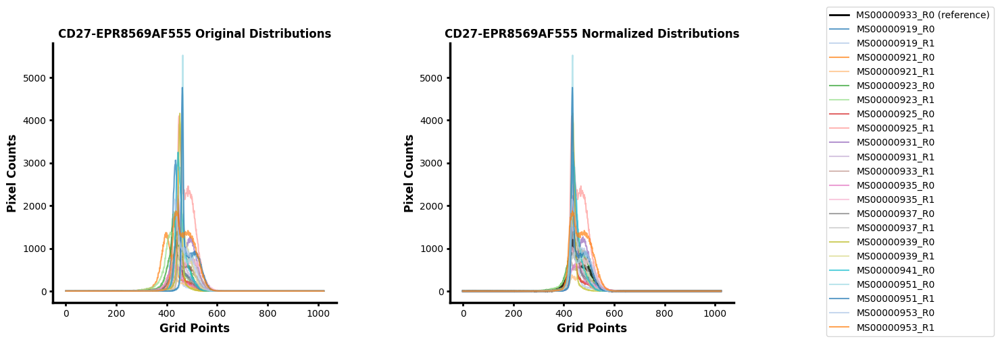


-------------------- Processing marker 'CD3d-EP4426AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [5, -3, 13, 6, 0, 1, -8, -6, -1, -6, 0, 10, 42, 18, -17, -14, -6, -5, -5, -4, -4, 15, 15]
✨ Auto-computed reference landmark for 'CD3d-EP4426AF647' on 'MS00000933_R0': 448
✨ Implied landmark positions for 'CD3d-EP4426AF647': [453, 445, 461, 454, 448, 449, 440, 442, 447, 442, 448, 458, 490, 466, 431, 434, 442, 443, 443, 444, 444, 463, 463]


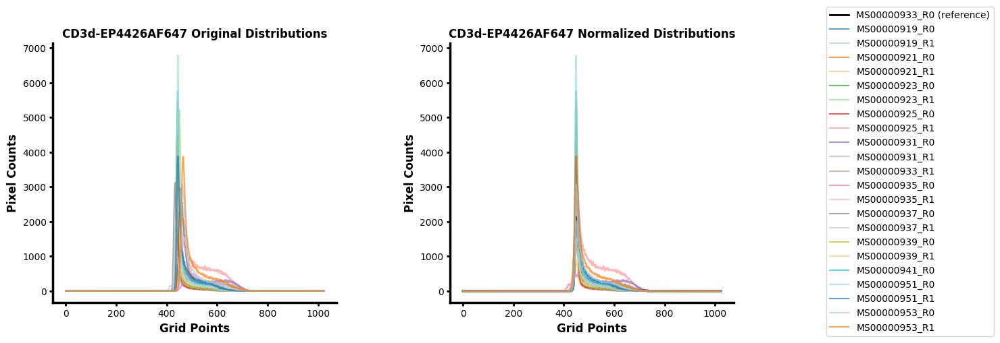


-------------------- Processing marker 'CD8a-c8144BAF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-10, -9, -20, -25, 7, 4, 5, 8, 3, 0, -4, 0, 37, 35, -8, -2, 12, 11, -24, 0, 0, 11, 13]
✨ Auto-computed reference landmark for 'CD8a-c8144BAF750' on 'MS00000933_R1': 480
✨ Implied landmark positions for 'CD8a-c8144BAF750': [470, 471, 460, 455, 487, 484, 485, 488, 483, 480, 476, 480, 517, 515, 472, 478, 492, 491, 456, 480, 480, 491, 493]


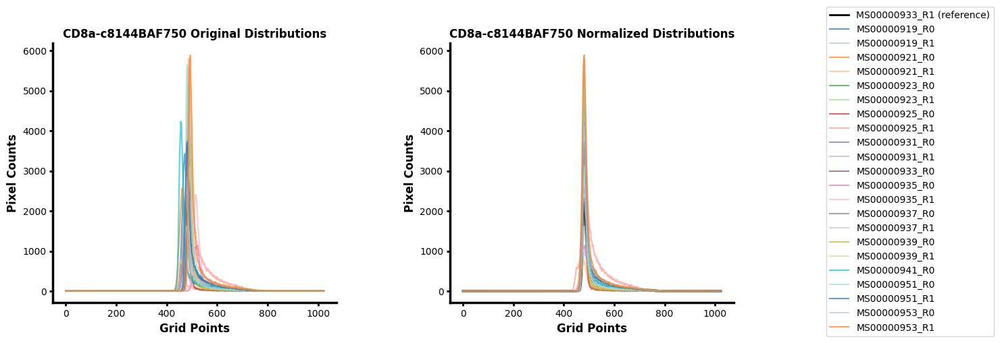


-------------------- Processing marker 'CD68-KP1AF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000941_R0' by histogram proximity 

✨ Computed shifts: [-4, -3, 5, 9, 25, 28, 3, 11, 0, -3, -30, -19, 2, 20, -13, -6, -5, 8, 0, 12, 18, -6, -2]
✨ Auto-computed reference landmark for 'CD68-KP1AF555' on 'MS00000941_R0': 475
✨ Implied landmark positions for 'CD68-KP1AF555': [471, 472, 480, 484, 500, 503, 478, 486, 475, 472, 445, 456, 477, 495, 462, 469, 470, 483, 475, 487, 493, 469, 473]


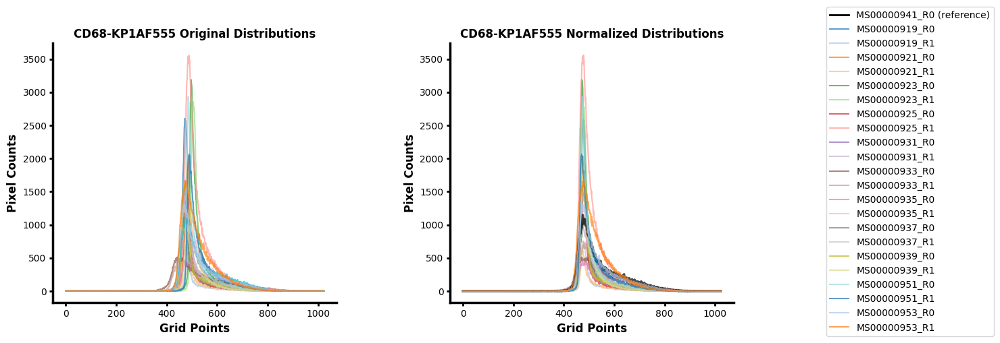


-------------------- Processing marker 'TCR-delta-E2E9TAF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000921_R0' by histogram proximity 

✨ Computed shifts: [0, -2, 0, -2, 1, 2, -1, -5, -1, 3, -5, -1, -4, -6, 6, 4, 2, -3, -1, -1, 1, 5, 8]
✨ Auto-computed reference landmark for 'TCR-delta-E2E9TAF647' on 'MS00000921_R0': 485
✨ Implied landmark positions for 'TCR-delta-E2E9TAF647': [485, 483, 485, 483, 486, 487, 484, 480, 484, 488, 480, 484, 481, 479, 491, 489, 487, 482, 484, 484, 486, 490, 493]


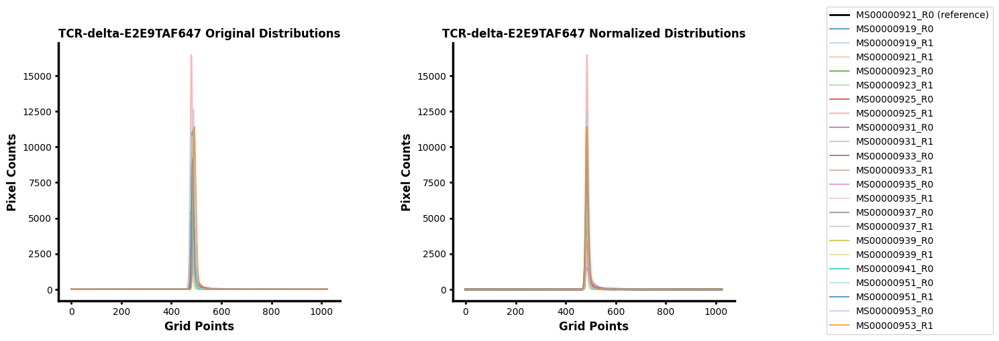


-------------------- Processing marker 'CD15-MC480AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [10, 4, -9, -24, -4, -4, 9, 2, 8, 15, 0, -2, 30, 9, 4, -5, 24, 8, 10, -6, 2, -7, 3]
✨ Auto-computed reference landmark for 'CD15-MC480AF750' on 'MS00000933_R0': 474
✨ Implied landmark positions for 'CD15-MC480AF750': [484, 478, 465, 450, 470, 470, 483, 476, 482, 489, 474, 472, 504, 483, 478, 469, 498, 482, 484, 468, 476, 467, 477]


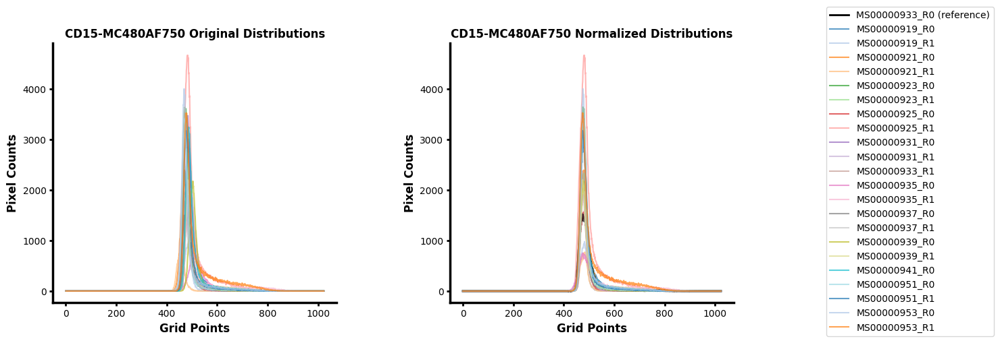


-------------------- Processing marker 'ECadherin-24E10AF488' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R0' by histogram proximity 

✨ Computed shifts: [21, 26, 13, 5, -22, 15, 42, 27, -22, 48, 0, 5, 12, -112, 302, -124, 4, -33, 4, 74, 75, -137, -141]
✨ Auto-computed reference landmark for 'ECadherin-24E10AF488' on 'MS00000933_R0': 654
✨ Implied landmark positions for 'ECadherin-24E10AF488': [675, 680, 667, 659, 632, 669, 696, 681, 632, 702, 654, 659, 666, 542, 956, 530, 658, 621, 658, 728, 729, 517, 513]


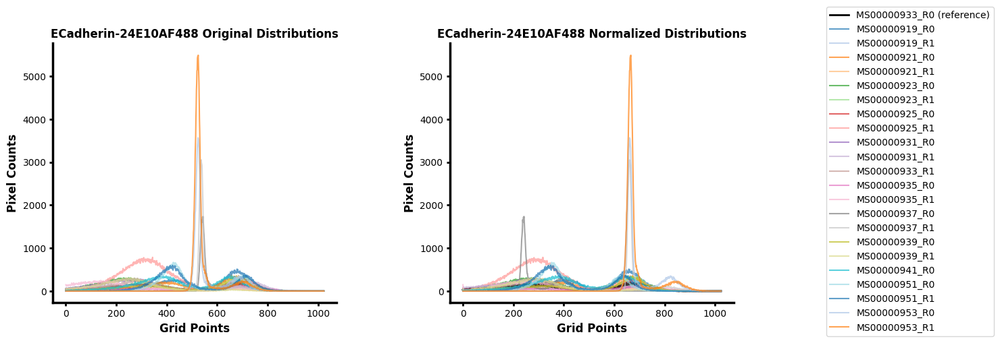


-------------------- Processing marker 'TIM-3-D5D5RAF555' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000933_R1' by histogram proximity 

✨ Computed shifts: [-14, -22, -14, -2, -10, -22, -13, -4, -9, 20, -4, 0, -10, -23, 8, 13, -32, -23, -2, -15, 3, 12, 11]
✨ Auto-computed reference landmark for 'TIM-3-D5D5RAF555' on 'MS00000933_R1': 594
✨ Implied landmark positions for 'TIM-3-D5D5RAF555': [580, 572, 580, 592, 584, 572, 581, 590, 585, 614, 590, 594, 584, 571, 602, 607, 562, 571, 592, 579, 597, 606, 605]


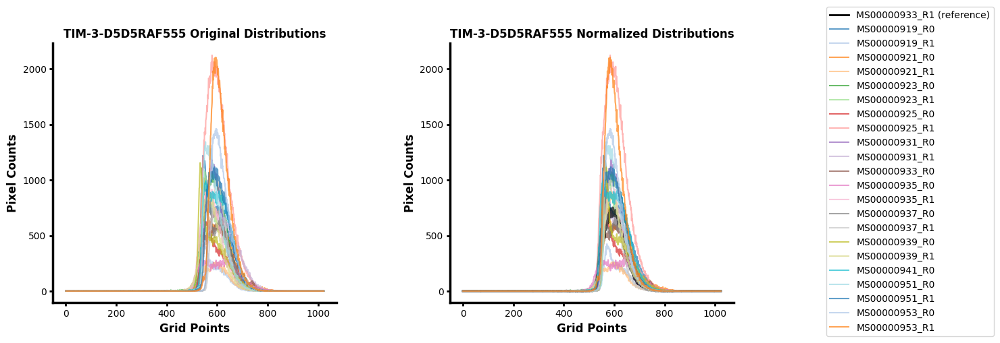


-------------------- Processing marker 'MUC2-CCP58AF647' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000935_R1' by histogram proximity 

✨ Computed shifts: [0, 13, -10, 6, 13, 18, 13, 7, 0, 12, -1, -5, 0, 0, 28, 17, -14, -6, 7, 13, 18, -11, -8]
✨ Auto-computed reference landmark for 'MUC2-CCP58AF647' on 'MS00000935_R1': 518
✨ Implied landmark positions for 'MUC2-CCP58AF647': [518, 531, 508, 524, 531, 536, 531, 525, 518, 530, 517, 513, 518, 518, 546, 535, 504, 512, 525, 531, 536, 507, 510]


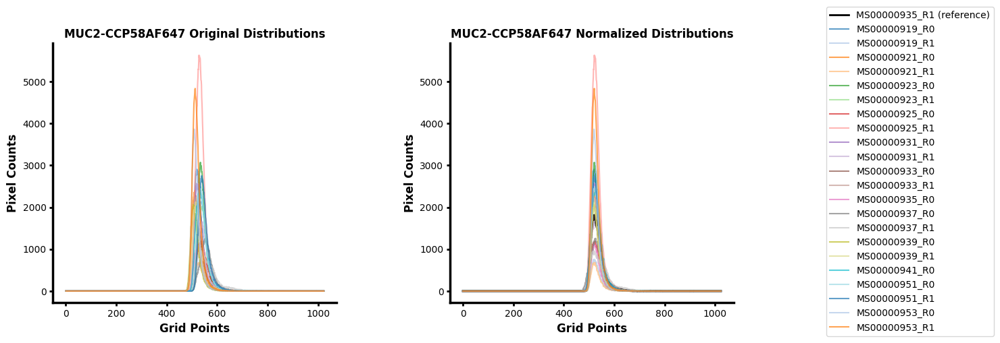


-------------------- Processing marker 'CD56-NCAM1-795-AF750' --------------------
☑️ No reference provided → will select by proximity
☑️ No landmarks → automatic alignment to mean, selecting 'MS00000925_R0' by histogram proximity 

✨ Computed shifts: [59, 60, -6, -5, 8, 3, 0, -4, 55, 59, 28, 27, 15, 4, 44, 45, -11, -19, 56, 19, 14, 42, 42]
✨ Auto-computed reference landmark for 'CD56-NCAM1-795-AF750' on 'MS00000925_R0': 555
✨ Implied landmark positions for 'CD56-NCAM1-795-AF750': [614, 615, 549, 550, 563, 558, 555, 551, 610, 614, 583, 582, 570, 559, 599, 600, 544, 536, 611, 574, 569, 597, 597]


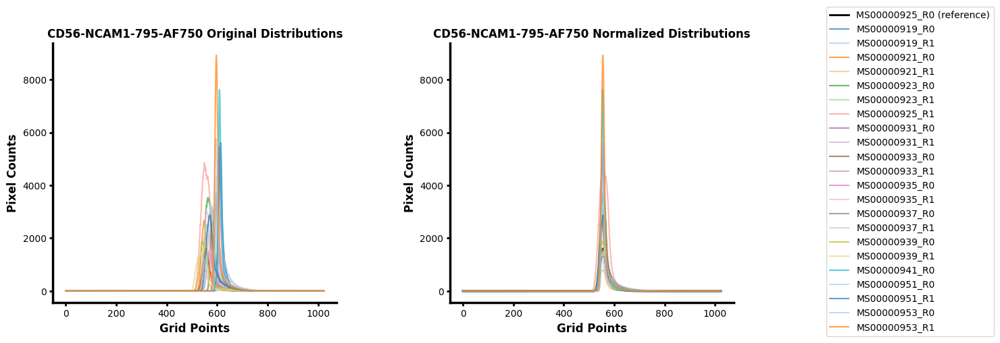

In [53]:
shifts_map, chosen_references, implied_landmarks_map = automatic_registration(
    histogram_data      = histograms,
    all_markers         = adata.var['marker_name'].tolist(),
    selected_markers    = adata.var['marker_name'].tolist(),
    sample_ids          = adata.obs['sample_id'].unique().tolist(),
    reference_samples   = None,
    landmark_map        = landmark,
    num_bins            = 1024,
    dpi                 = 100,
    x_limits            = None
)

# 7. Generate the normalized data using the finetuned scale factors

In [54]:
generate_normalized_feature(
    feature_input            = adata,
    sample_ids               = None,
    markers                  = None,
    intensity_ranges         = intensity_ranges,
    shifts_map               = shifts_map,
    chosen_references        = chosen_references,
    num_bins                 = 1024, 
    dpi                      = 100,
    plot_dist                = False, 
    plot_single_cell_corr    = False, 
    gmm_analysis             = False,
    save_normalized_features = True
)

##############################Performing feature normalization##############################



Samples:  17%|█▋        | 4/23 [00:00<00:00, 37.16it/s]

******************************  Normalizing MS00000919_R0 ******************************
⏳ PanCytokAE1AE3AF488 ...
⏳ Normalizing PanCytokAE1AE3AF488 | reference=MS00000925_R0 | scale factor=1.7159078311755362
⏳ p-c-Jun-D47G9AF555 ...
⏳ Normalizing p-c-Jun-D47G9AF555 | reference=MS00000923_R1 | scale factor=0.9680693315159968
⏳ CD207-7430AF647 ...
⏳ Normalizing CD207-7430AF647 | reference=MS00000931_R1 | scale factor=1.126561084799835
⏳ CD1c-OTI2F4AF750 ...
⏳ Normalizing CD1c-OTI2F4AF750 | reference=MS00000935_R1 | scale factor=1.0
⏳ PDPN-LpMab-12AF488 ...
⏳ Normalizing PDPN-LpMab-12AF488 | reference=MS00000939_R1 | scale factor=1.207085606872926
⏳ pmTORS2448-49F9AF555 ...
⏳ Normalizing pmTORS2448-49F9AF555 | reference=MS00000933_R0 | scale factor=0.8002330549264514
⏳ FoxP3-D2W8EAF647 ...
⏳ Normalizing FoxP3-D2W8EAF647 | reference=MS00000931_R1 | scale factor=0.649015590055836
⏳ EphB2-D2X2IAF750 ...
⏳ Normalizing EphB2-D2X2IAF750 | reference=MS00000939_R0 | scale factor=0.60549495897850

Samples:  35%|███▍      | 8/23 [00:00<00:00, 25.23it/s]

⏳ Normalizing MUC2-CCP58AF647 | reference=MS00000935_R1 | scale factor=0.8793780877723817
⏳ CD56-NCAM1-795-AF750 ...
⏳ Normalizing CD56-NCAM1-795-AF750 | reference=MS00000925_R0 | scale factor=1.0
******************************  Normalizing MS00000925_R1 ******************************
⏳ PanCytokAE1AE3AF488 ...
⏳ Normalizing PanCytokAE1AE3AF488 | reference=MS00000925_R0 | scale factor=1.3498155289370564
⏳ p-c-Jun-D47G9AF555 ...
⏳ Normalizing p-c-Jun-D47G9AF555 | reference=MS00000923_R1 | scale factor=0.8878174841823682
⏳ CD207-7430AF647 ...
⏳ Normalizing CD207-7430AF647 | reference=MS00000931_R1 | scale factor=1.0671607927959164
⏳ CD1c-OTI2F4AF750 ...
⏳ Normalizing CD1c-OTI2F4AF750 | reference=MS00000935_R1 | scale factor=0.9642407518032
⏳ PDPN-LpMab-12AF488 ...
⏳ Normalizing PDPN-LpMab-12AF488 | reference=MS00000939_R1 | scale factor=0.5589269514252166
⏳ pmTORS2448-49F9AF555 ...
⏳ Normalizing pmTORS2448-49F9AF555 | reference=MS00000933_R0 | scale factor=0.9100245927448762
⏳ FoxP3-D2W8E

Samples:  70%|██████▉   | 16/23 [00:00<00:00, 30.09it/s]

******************************  Normalizing MS00000933_R0 ******************************
⏳ PanCytokAE1AE3AF488 ...
⏳ Normalizing PanCytokAE1AE3AF488 | reference=MS00000925_R0 | scale factor=0.990050891852896
⏳ p-c-Jun-D47G9AF555 ...
⏳ Normalizing p-c-Jun-D47G9AF555 | reference=MS00000923_R1 | scale factor=0.9473506769430793
⏳ CD207-7430AF647 ...
⏳ Normalizing CD207-7430AF647 | reference=MS00000931_R1 | scale factor=1.0
⏳ CD1c-OTI2F4AF750 ...
⏳ Normalizing CD1c-OTI2F4AF750 | reference=MS00000935_R1 | scale factor=0.8803374707261024
⏳ PDPN-LpMab-12AF488 ...
⏳ Normalizing PDPN-LpMab-12AF488 | reference=MS00000939_R1 | scale factor=1.156541542470232
⏳ pmTORS2448-49F9AF555 ...
⏳ Normalizing pmTORS2448-49F9AF555 | reference=MS00000933_R0 | scale factor=1.0
⏳ FoxP3-D2W8EAF647 ...
⏳ Normalizing FoxP3-D2W8EAF647 | reference=MS00000931_R1 | scale factor=0.8359004629237324
⏳ EphB2-D2X2IAF750 ...
⏳ Normalizing EphB2-D2X2IAF750 | reference=MS00000939_R0 | scale factor=0.813356248093239
⏳ Periostin-

Samples:  87%|████████▋ | 20/23 [00:00<00:00, 31.56it/s]

******************************  Normalizing MS00000941_R0 ******************************
⏳ PanCytokAE1AE3AF488 ...
⏳ Normalizing PanCytokAE1AE3AF488 | reference=MS00000925_R0 | scale factor=0.990050891852896
⏳ p-c-Jun-D47G9AF555 ...
⏳ Normalizing p-c-Jun-D47G9AF555 | reference=MS00000923_R1 | scale factor=0.9072341418427884
⏳ CD207-7430AF647 ...
⏳ Normalizing CD207-7430AF647 | reference=MS00000931_R1 | scale factor=1.0330347490747427
⏳ CD1c-OTI2F4AF750 ...
⏳ Normalizing CD1c-OTI2F4AF750 | reference=MS00000935_R1 | scale factor=1.146316231352975
⏳ PDPN-LpMab-12AF488 ...
⏳ Normalizing PDPN-LpMab-12AF488 | reference=MS00000939_R1 | scale factor=0.9024343075245116
⏳ pmTORS2448-49F9AF555 ...
⏳ Normalizing pmTORS2448-49F9AF555 | reference=MS00000933_R0 | scale factor=0.8869227614363457
⏳ FoxP3-D2W8EAF647 ...
⏳ Normalizing FoxP3-D2W8EAF647 | reference=MS00000931_R1 | scale factor=1.1963146862035414
⏳ EphB2-D2X2IAF750 ...
⏳ Normalizing EphB2-D2X2IAF750 | reference=MS00000939_R0 | scale factor=

Samples: 100%|██████████| 23/23 [00:00<00:00, 27.05it/s]


✅ Saved normalized data to adata.layers['normalized'].
✅ Wrote AnnData to 'Anndata_Normalized.h5ad'.
🎉 Feature normalization complete!


# 8. A sanity check on the normalized data

In [ ]:
import scanpy as sc

In [ ]:
adata = ad.read_h5ad('/home/workspace/private/Anndata_Normalized.h5ad')

In [ ]:
adata

Markers:   0%|          | 0/52 [00:00<?, ?it/s]

✅ Processing MS00000915_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000915_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000917_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000917_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000919_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000919_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000921_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000921_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000923_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000923_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000925_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000925_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000927_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000927_R1 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000929_R0 for marker PanCytokAE1AE3AF488......
✅ Processing MS00000929_R1 for marker Pa

Markers:   2%|▏         | 1/52 [00:06<05:41,  6.70s/it]

✅ Processing MS00000915_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000915_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000917_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000917_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000919_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000919_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000921_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000921_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000923_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000923_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000925_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000925_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000927_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000927_R1 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000929_R0 for marker p-c-Jun-D47G9AF555......
✅ Processing MS00000929_R1 for marker p-c-Jun-D47G9AF55

Markers:   4%|▍         | 2/52 [00:19<08:29, 10.20s/it]

✅ Processing MS00000915_R0 for marker CD207-7430AF647......
✅ Processing MS00000915_R1 for marker CD207-7430AF647......
✅ Processing MS00000917_R0 for marker CD207-7430AF647......
✅ Processing MS00000917_R1 for marker CD207-7430AF647......
✅ Processing MS00000919_R0 for marker CD207-7430AF647......
✅ Processing MS00000919_R1 for marker CD207-7430AF647......
✅ Processing MS00000921_R0 for marker CD207-7430AF647......
✅ Processing MS00000921_R1 for marker CD207-7430AF647......
✅ Processing MS00000923_R0 for marker CD207-7430AF647......
✅ Processing MS00000923_R1 for marker CD207-7430AF647......
✅ Processing MS00000925_R0 for marker CD207-7430AF647......
✅ Processing MS00000925_R1 for marker CD207-7430AF647......
✅ Processing MS00000927_R0 for marker CD207-7430AF647......
✅ Processing MS00000927_R1 for marker CD207-7430AF647......
✅ Processing MS00000929_R0 for marker CD207-7430AF647......
✅ Processing MS00000929_R1 for marker CD207-7430AF647......
✅ Processing MS00000931_R0 for marker CD

Markers:   6%|▌         | 3/52 [00:31<09:08, 11.19s/it]

✅ Processing MS00000915_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000915_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000917_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000917_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000919_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000919_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000921_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000921_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000923_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000923_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000925_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000925_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000927_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000927_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000929_R0 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000929_R1 for marker CD1c-OTI2F4AF750......
✅ Processing MS00000931_

Markers:   8%|▊         | 4/52 [00:41<08:21, 10.44s/it]

✅ Processing MS00000915_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000915_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000917_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000917_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000919_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000919_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000921_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000921_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000923_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000923_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000925_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000925_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000927_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000927_R1 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000929_R0 for marker PDPN-LpMab-12AF488......
✅ Processing MS00000929_R1 for marker PDPN-LpMab-12AF48

Markers:  10%|▉         | 5/52 [00:50<07:55, 10.11s/it]

✅ Processing MS00000915_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000915_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000917_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000917_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000919_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000919_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000921_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000921_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000923_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000923_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000925_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000925_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000927_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000927_R1 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000929_R0 for marker pmTORS2448-49F9AF555......
✅ Processing MS00000929_R

Markers:  12%|█▏        | 6/52 [01:03<08:25, 10.99s/it]

✅ Processing MS00000915_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000915_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000917_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000917_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000919_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000919_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000921_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000921_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000923_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000923_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000925_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000925_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000927_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000927_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000929_R0 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000929_R1 for marker FoxP3-D2W8EAF647......
✅ Processing MS00000931_

Markers:  13%|█▎        | 7/52 [01:15<08:30, 11.35s/it]

✅ Processing MS00000915_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000915_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000917_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000917_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000919_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000919_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000921_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000921_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000923_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000923_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000925_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000925_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000927_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000927_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000929_R0 for marker EphB2-D2X2IAF750......
✅ Processing MS00000929_R1 for marker EphB2-D2X2IAF750......
✅ Processing MS00000931_

Markers:  15%|█▌        | 8/52 [01:26<08:12, 11.19s/it]

✅ Processing MS00000915_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000915_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000917_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000917_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000919_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000919_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000921_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000921_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000923_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000923_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000925_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000925_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000927_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000927_R1 for marker Periostin-E5F2SAF488......
✅ Processing MS00000929_R0 for marker Periostin-E5F2SAF488......
✅ Processing MS00000929_R

Markers:  17%|█▋        | 9/52 [01:34<07:15, 10.14s/it]

✅ Processing MS00000915_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000915_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000917_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000917_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000919_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000919_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000921_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000921_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000923_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000923_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000925_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000925_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000927_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000927_R1 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000929_R0 for marker p-NF-kB-178F3AF555......
✅ Processing MS00000929_R1 for marker p-NF-kB-178F3AF55

Markers:  19%|█▉        | 10/52 [01:45<07:18, 10.44s/it]

✅ Processing MS00000915_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000915_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000917_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000917_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000919_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000919_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000921_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000921_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000923_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000923_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000925_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000925_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000927_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000927_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000929_R0 for marker Ki67-D2H10AF647......
✅ Processing MS00000929_R1 for marker Ki67-D2H10AF647......
✅ Processing MS00000931_R0 for marker Ki

Markers:  21%|██        | 11/52 [01:53<06:41,  9.79s/it]

✅ Processing MS00000915_R0 for marker CD209-1781AF750......
✅ Processing MS00000915_R1 for marker CD209-1781AF750......
✅ Processing MS00000917_R0 for marker CD209-1781AF750......
✅ Processing MS00000917_R1 for marker CD209-1781AF750......
✅ Processing MS00000919_R0 for marker CD209-1781AF750......
✅ Processing MS00000919_R1 for marker CD209-1781AF750......
✅ Processing MS00000921_R0 for marker CD209-1781AF750......
✅ Processing MS00000921_R1 for marker CD209-1781AF750......
✅ Processing MS00000923_R0 for marker CD209-1781AF750......
✅ Processing MS00000923_R1 for marker CD209-1781AF750......
✅ Processing MS00000925_R0 for marker CD209-1781AF750......
✅ Processing MS00000925_R1 for marker CD209-1781AF750......
✅ Processing MS00000927_R0 for marker CD209-1781AF750......
✅ Processing MS00000927_R1 for marker CD209-1781AF750......
✅ Processing MS00000929_R0 for marker CD209-1781AF750......
✅ Processing MS00000929_R1 for marker CD209-1781AF750......
✅ Processing MS00000931_R0 for marker CD

Markers:  23%|██▎       | 12/52 [02:02<06:25,  9.63s/it]

✅ Processing MS00000915_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000915_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000917_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000917_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000919_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000919_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000921_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000921_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000923_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000923_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000925_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000925_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000927_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000927_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000929_R0 for marker CD90-E3V8AAF488......
✅ Processing MS00000929_R1 for marker CD90-E3V8AAF488......
✅ Processing MS00000931_R0 for marker CD

Markers:  25%|██▌       | 13/52 [02:10<05:56,  9.13s/it]

✅ Processing MS00000915_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000915_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000917_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000917_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000919_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000919_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000921_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000921_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000923_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000923_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000925_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000925_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000927_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000927_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000929_R0 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000929_R1 for marker IRF-8-E6J8QAF555......
✅ Processing MS00000931_

Markers:  27%|██▋       | 14/52 [02:21<06:01,  9.52s/it]

✅ Processing MS00000915_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000915_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000917_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000917_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000919_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000919_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000921_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000921_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000923_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000923_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000925_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000925_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000927_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000927_R1 for marker IL-1beta-3A6AF647......
✅ Processing MS00000929_R0 for marker IL-1beta-3A6AF647......
✅ Processing MS00000929_R1 for marker IL-1beta-3A6AF647......
✅ Proces

Markers:  29%|██▉       | 15/52 [02:31<06:05,  9.87s/it]

✅ Processing MS00000915_R0 for marker CD103-3904RAF750......
✅ Processing MS00000915_R1 for marker CD103-3904RAF750......
✅ Processing MS00000917_R0 for marker CD103-3904RAF750......
✅ Processing MS00000917_R1 for marker CD103-3904RAF750......
✅ Processing MS00000919_R0 for marker CD103-3904RAF750......
✅ Processing MS00000919_R1 for marker CD103-3904RAF750......
✅ Processing MS00000921_R0 for marker CD103-3904RAF750......
✅ Processing MS00000921_R1 for marker CD103-3904RAF750......
✅ Processing MS00000923_R0 for marker CD103-3904RAF750......
✅ Processing MS00000923_R1 for marker CD103-3904RAF750......
✅ Processing MS00000925_R0 for marker CD103-3904RAF750......
✅ Processing MS00000925_R1 for marker CD103-3904RAF750......
✅ Processing MS00000927_R0 for marker CD103-3904RAF750......
✅ Processing MS00000927_R1 for marker CD103-3904RAF750......
✅ Processing MS00000929_R0 for marker CD103-3904RAF750......
✅ Processing MS00000929_R1 for marker CD103-3904RAF750......
✅ Processing MS00000931_

Markers:  31%|███       | 16/52 [02:43<06:19, 10.55s/it]

✅ Processing MS00000915_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000915_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000917_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000917_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000919_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000919_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000921_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000921_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000923_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000923_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000925_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000925_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000927_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000927_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000929_R0 for marker SOD2-D3X8FAF488......
✅ Processing MS00000929_R1 for marker SOD2-D3X8FAF488......
✅ Processing MS00000931_R0 for marker SO

Markers:  33%|███▎      | 17/52 [02:53<05:55, 10.16s/it]

✅ Processing MS00000915_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000915_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000917_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000917_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000919_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000919_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000921_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000921_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000923_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000923_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000925_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000925_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000927_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000927_R1 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000929_R0 for marker p-p38MAPK-D3F9AF647......
✅ Processing MS00000929_R1 for marker p-

Markers:  35%|███▍      | 18/52 [03:07<06:30, 11.47s/it]

✅ Processing MS00000915_R0 for marker PU1-2146AF750......
✅ Processing MS00000915_R1 for marker PU1-2146AF750......
✅ Processing MS00000917_R0 for marker PU1-2146AF750......
✅ Processing MS00000917_R1 for marker PU1-2146AF750......
✅ Processing MS00000919_R0 for marker PU1-2146AF750......
✅ Processing MS00000919_R1 for marker PU1-2146AF750......
✅ Processing MS00000921_R0 for marker PU1-2146AF750......
✅ Processing MS00000921_R1 for marker PU1-2146AF750......
✅ Processing MS00000923_R0 for marker PU1-2146AF750......
✅ Processing MS00000923_R1 for marker PU1-2146AF750......
✅ Processing MS00000925_R0 for marker PU1-2146AF750......
✅ Processing MS00000925_R1 for marker PU1-2146AF750......
✅ Processing MS00000927_R0 for marker PU1-2146AF750......
✅ Processing MS00000927_R1 for marker PU1-2146AF750......
✅ Processing MS00000929_R0 for marker PU1-2146AF750......
✅ Processing MS00000929_R1 for marker PU1-2146AF750......
✅ Processing MS00000931_R0 for marker PU1-2146AF750......
✅ Processing M

Markers:  37%|███▋      | 19/52 [03:17<06:05, 11.09s/it]

✅ Processing MS00000915_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000915_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000917_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000917_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000919_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000919_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000921_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000921_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000923_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000923_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000925_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000925_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000927_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000927_R1 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000929_R0 for marker S100A12-OTI1D1AF488......
✅ Processing MS00000929_R1 for marker S1

Markers:  38%|███▊      | 20/52 [03:29<05:59, 11.24s/it]

✅ Processing MS00000915_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000915_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000917_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000917_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000919_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000919_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000921_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000921_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000923_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000923_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000925_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000925_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000927_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000927_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000929_R0 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000929_R1 for marker MMP-9-D6O3HAF555......
✅ Processing MS00000931_

Markers:  40%|████      | 21/52 [03:40<05:45, 11.15s/it]

✅ Processing MS00000915_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000915_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000917_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000917_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000919_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000919_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000921_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000921_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000923_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000923_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000925_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000925_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000927_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000927_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000929_R0 for marker CD11c-D3V1EAF647......
✅ Processing MS00000929_R1 for marker CD11c-D3V1EAF647......
✅ Processing MS00000931_

Markers:  42%|████▏     | 22/52 [03:52<05:40, 11.33s/it]

✅ Processing MS00000915_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000915_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000917_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000917_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000919_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000919_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000921_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000921_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000923_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000923_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000925_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000925_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000927_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000927_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000929_R0 for marker PD-1-D4W2JAF750......
✅ Processing MS00000929_R1 for marker PD-1-D4W2JAF750......
✅ Processing MS00000931_R0 for marker PD

Markers:  44%|████▍     | 23/52 [04:04<05:40, 11.75s/it]

✅ Processing MS00000915_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000915_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000917_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000917_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000919_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000919_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000921_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000921_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000923_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000923_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000925_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000925_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000927_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000927_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000929_R0 for marker IDO-D5J4EAF488......
✅ Processing MS00000929_R1 for marker IDO-D5J4EAF488......
✅ Processing MS00000931_R0 for marker IDO-D5J4EAF488....

Markers:  46%|████▌     | 24/52 [04:14<05:13, 11.20s/it]

✅ Processing MS00000915_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000915_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000917_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000917_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000919_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000919_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000921_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000921_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000923_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000923_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000925_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000925_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000927_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000927_R1 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000929_R0 for marker YKL-40-E2L1MAF555......
✅ Processing MS00000929_R1 for marker YKL-40-E2L1MAF555......
✅ Proces

Markers:  48%|████▊     | 25/52 [04:27<05:12, 11.58s/it]

✅ Processing MS00000915_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000915_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000917_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000917_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000919_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000919_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000921_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000921_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000923_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000923_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000925_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000925_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000927_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000927_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000929_R0 for marker IRF-1-D5E4AF647......
✅ Processing MS00000929_R1 for marker IRF-1-D5E4AF647......
✅ Processing MS00000931_R0 for marker IR

Markers:  50%|█████     | 26/52 [04:34<04:27, 10.27s/it]

✅ Processing MS00000915_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000915_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000917_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000917_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000919_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000919_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000921_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000921_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000923_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000923_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000925_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000925_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000927_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000927_R1 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000929_R0 for marker IFITM3-D8E8GAF750......
✅ Processing MS00000929_R1 for marker IFITM3-D8E8GAF750......
✅ Proces

Markers:  52%|█████▏    | 27/52 [04:42<03:56,  9.46s/it]

✅ Processing MS00000915_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000915_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000917_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000917_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000919_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000919_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000921_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000921_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000923_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000923_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000925_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000925_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000927_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000927_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000929_R0 for marker CD7-E4G1QAF488......
✅ Processing MS00000929_R1 for marker CD7-E4G1QAF488......
✅ Processing MS00000931_R0 for marker CD7-E4G1QAF488....

Markers:  54%|█████▍    | 28/52 [04:51<03:45,  9.41s/it]

✅ Processing MS00000915_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000915_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000917_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000917_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000919_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000919_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000921_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000921_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000923_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000923_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000925_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000925_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000927_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000927_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000929_R0 for marker GITR-D5V7PAF555......
✅ Processing MS00000929_R1 for marker GITR-D5V7PAF555......
✅ Processing MS00000931_R0 for marker GI

Markers:  56%|█████▌    | 29/52 [05:02<03:44,  9.78s/it]

✅ Processing MS00000915_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000915_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000917_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000917_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000919_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000919_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000921_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000921_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000923_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000923_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000925_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000925_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000927_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000927_R1 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000929_R0 for marker pSTAT1Ty70158D6AF647......
✅ Processing MS00000929_R

Markers:  58%|█████▊    | 30/52 [05:14<03:51, 10.53s/it]

✅ Processing MS00000915_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000915_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000917_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000917_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000919_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000919_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000921_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000921_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000923_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000923_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000925_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000925_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000927_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000927_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000929_R0 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000929_R1 for marker IRF-4-E8H3SAF750......
✅ Processing MS00000931_

Markers:  60%|█████▉    | 31/52 [05:23<03:30, 10.01s/it]

✅ Processing MS00000915_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000915_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000917_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000917_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000919_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000919_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000921_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000921_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000923_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000923_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000925_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000925_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000927_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000927_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000929_R0 for marker CD14-D7A2TAF488......
✅ Processing MS00000929_R1 for marker CD14-D7A2TAF488......
✅ Processing MS00000931_R0 for marker CD

Markers:  62%|██████▏   | 32/52 [05:31<03:09,  9.46s/it]

✅ Processing MS00000915_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000915_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000917_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000917_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000919_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000919_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000921_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000921_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000923_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000923_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000925_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000925_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000927_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000927_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000929_R0 for marker T-bet-E4I2KAF555......
✅ Processing MS00000929_R1 for marker T-bet-E4I2KAF555......
✅ Processing MS00000931_

Markers:  63%|██████▎   | 33/52 [05:41<03:05,  9.74s/it]

✅ Processing MS00000915_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000915_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000917_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000917_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000919_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000919_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000921_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000921_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000923_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000923_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000925_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000925_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000927_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000927_R1 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000929_R0 for marker pSTAT1s727-D3B7AF647......
✅ Processing MS00000929_R

Markers:  65%|██████▌   | 34/52 [05:52<03:02, 10.16s/it]

✅ Processing MS00000915_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000915_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000917_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000917_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000919_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000919_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000921_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000921_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000923_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000923_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000925_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000925_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000927_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000927_R1 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000929_R0 for marker ClvCasp-3-58A1EAF750......
✅ Processing MS00000929_R

Markers:  67%|██████▋   | 35/52 [06:01<02:47,  9.83s/it]

✅ Processing MS00000915_R0 for marker SMA-1A4AF488......
✅ Processing MS00000915_R1 for marker SMA-1A4AF488......
✅ Processing MS00000917_R0 for marker SMA-1A4AF488......
✅ Processing MS00000917_R1 for marker SMA-1A4AF488......
✅ Processing MS00000919_R0 for marker SMA-1A4AF488......
✅ Processing MS00000919_R1 for marker SMA-1A4AF488......
✅ Processing MS00000921_R0 for marker SMA-1A4AF488......
✅ Processing MS00000921_R1 for marker SMA-1A4AF488......
✅ Processing MS00000923_R0 for marker SMA-1A4AF488......
✅ Processing MS00000923_R1 for marker SMA-1A4AF488......
✅ Processing MS00000925_R0 for marker SMA-1A4AF488......
✅ Processing MS00000925_R1 for marker SMA-1A4AF488......
✅ Processing MS00000927_R0 for marker SMA-1A4AF488......
✅ Processing MS00000927_R1 for marker SMA-1A4AF488......
✅ Processing MS00000929_R0 for marker SMA-1A4AF488......
✅ Processing MS00000929_R1 for marker SMA-1A4AF488......
✅ Processing MS00000931_R0 for marker SMA-1A4AF488......
✅ Processing MS00000931_R1 for 

Markers:  69%|██████▉   | 36/52 [06:13<02:47, 10.46s/it]

✅ Processing MS00000915_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000915_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000917_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000917_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000919_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000919_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000921_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000921_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000923_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000923_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000925_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000925_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000927_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000927_R1 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000929_R0 for marker NAkATPaseEP1845Y555......
✅ Processing MS00000929_R1 for marker NA

Markers:  71%|███████   | 37/52 [06:22<02:28,  9.93s/it]

✅ Processing MS00000915_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000915_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000917_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000917_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000919_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000919_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000921_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000921_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000923_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000923_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000925_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000925_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000927_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000927_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000929_R0 for marker HLADR-LN3AF647......
✅ Processing MS00000929_R1 for marker HLADR-LN3AF647......
✅ Processing MS00000931_R0 for marker HLADR-LN3AF647....

Markers:  73%|███████▎  | 38/52 [06:33<02:25, 10.38s/it]

✅ Processing MS00000915_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000915_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000917_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000917_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000919_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000919_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000921_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000921_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000923_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000923_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000925_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000925_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000927_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000927_R1 for marker CD452B11PD726AF750......
✅ Processing MS00000929_R0 for marker CD452B11PD726AF750......
✅ Processing MS00000929_R1 for marker CD452B11PD726AF75

Markers:  75%|███████▌  | 39/52 [06:47<02:27, 11.32s/it]

✅ Processing MS00000915_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000915_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000917_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000917_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000919_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000919_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000921_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000921_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000923_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000923_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000925_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000925_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000927_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000927_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000929_R0 for marker CD4EPR6855AF555......
✅ Processing MS00000929_R1 for marker CD4EPR6855AF555......
✅ Processing MS00000931_R0 for marker CD

Markers:  77%|███████▋  | 40/52 [06:58<02:14, 11.19s/it]

✅ Processing MS00000915_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000915_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000917_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000917_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000919_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000919_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000921_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000921_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000923_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000923_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000925_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000925_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000927_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000927_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000929_R0 for marker CD20-E7B7TAF647......
✅ Processing MS00000929_R1 for marker CD20-E7B7TAF647......
✅ Processing MS00000931_R0 for marker CD

Markers:  79%|███████▉  | 41/52 [07:08<01:58, 10.80s/it]

✅ Processing MS00000915_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000915_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000917_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000917_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000919_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000919_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000921_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000921_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000923_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000923_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000925_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000925_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000927_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000927_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000929_R0 for marker CD16-DJ130cAF750......
✅ Processing MS00000929_R1 for marker CD16-DJ130cAF750......
✅ Processing MS00000931_

Markers:  81%|████████  | 42/52 [07:20<01:52, 11.30s/it]

✅ Processing MS00000915_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000915_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000917_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000917_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000919_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000919_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000921_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000921_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000923_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000923_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000925_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000925_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000927_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000927_R1 for marker CD27-EPR8569AF555......
✅ Processing MS00000929_R0 for marker CD27-EPR8569AF555......
✅ Processing MS00000929_R1 for marker CD27-EPR8569AF555......
✅ Proces

Markers:  83%|████████▎ | 43/52 [07:31<01:39, 11.05s/it]

✅ Processing MS00000915_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000915_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000917_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000917_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000919_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000919_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000921_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000921_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000923_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000923_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000925_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000925_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000927_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000927_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000929_R0 for marker CD3d-EP4426AF647......
✅ Processing MS00000929_R1 for marker CD3d-EP4426AF647......
✅ Processing MS00000931_

Markers:  85%|████████▍ | 44/52 [07:42<01:30, 11.26s/it]

✅ Processing MS00000915_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000915_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000917_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000917_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000919_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000919_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000921_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000921_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000923_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000923_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000925_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000925_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000927_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000927_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000929_R0 for marker CD8a-c8144BAF750......
✅ Processing MS00000929_R1 for marker CD8a-c8144BAF750......
✅ Processing MS00000931_

Markers:  87%|████████▋ | 45/52 [07:53<01:17, 11.06s/it]

✅ Processing MS00000915_R0 for marker CD68-KP1AF555......
✅ Processing MS00000915_R1 for marker CD68-KP1AF555......
✅ Processing MS00000917_R0 for marker CD68-KP1AF555......
✅ Processing MS00000917_R1 for marker CD68-KP1AF555......
✅ Processing MS00000919_R0 for marker CD68-KP1AF555......
✅ Processing MS00000919_R1 for marker CD68-KP1AF555......
✅ Processing MS00000921_R0 for marker CD68-KP1AF555......
✅ Processing MS00000921_R1 for marker CD68-KP1AF555......
✅ Processing MS00000923_R0 for marker CD68-KP1AF555......
✅ Processing MS00000923_R1 for marker CD68-KP1AF555......
✅ Processing MS00000925_R0 for marker CD68-KP1AF555......
✅ Processing MS00000925_R1 for marker CD68-KP1AF555......
✅ Processing MS00000927_R0 for marker CD68-KP1AF555......
✅ Processing MS00000927_R1 for marker CD68-KP1AF555......
✅ Processing MS00000929_R0 for marker CD68-KP1AF555......
✅ Processing MS00000929_R1 for marker CD68-KP1AF555......
✅ Processing MS00000931_R0 for marker CD68-KP1AF555......
✅ Processing M

Markers:  88%|████████▊ | 46/52 [08:02<01:02, 10.47s/it]

✅ Processing MS00000915_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000915_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000917_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000917_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000919_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000919_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000921_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000921_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000923_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000923_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000925_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000925_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000927_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000927_R1 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000929_R0 for marker TCR-delta-E2E9TAF647......
✅ Processing MS00000929_R

Markers:  90%|█████████ | 47/52 [08:14<00:54, 10.99s/it]

✅ Processing MS00000915_R0 for marker CD15-MC480AF750......
✅ Processing MS00000915_R1 for marker CD15-MC480AF750......
✅ Processing MS00000917_R0 for marker CD15-MC480AF750......
✅ Processing MS00000917_R1 for marker CD15-MC480AF750......
✅ Processing MS00000919_R0 for marker CD15-MC480AF750......
✅ Processing MS00000919_R1 for marker CD15-MC480AF750......
✅ Processing MS00000921_R0 for marker CD15-MC480AF750......
✅ Processing MS00000921_R1 for marker CD15-MC480AF750......
✅ Processing MS00000923_R0 for marker CD15-MC480AF750......
✅ Processing MS00000923_R1 for marker CD15-MC480AF750......
✅ Processing MS00000925_R0 for marker CD15-MC480AF750......
✅ Processing MS00000925_R1 for marker CD15-MC480AF750......
✅ Processing MS00000927_R0 for marker CD15-MC480AF750......
✅ Processing MS00000927_R1 for marker CD15-MC480AF750......
✅ Processing MS00000929_R0 for marker CD15-MC480AF750......
✅ Processing MS00000929_R1 for marker CD15-MC480AF750......
✅ Processing MS00000931_R0 for marker CD

Markers:  92%|█████████▏| 48/52 [08:31<00:51, 12.75s/it]

✅ Processing MS00000915_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000915_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000917_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000917_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000919_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000919_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000921_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000921_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000923_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000923_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000925_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000925_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000927_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000927_R1 for marker ECadherin-24E10AF488......
✅ Processing MS00000929_R0 for marker ECadherin-24E10AF488......
✅ Processing MS00000929_R

Markers:  94%|█████████▍| 49/52 [08:41<00:36, 12.03s/it]

✅ Processing MS00000915_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000915_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000917_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000917_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000919_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000919_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000921_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000921_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000923_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000923_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000925_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000925_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000927_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000927_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000929_R0 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000929_R1 for marker TIM-3-D5D5RAF555......
✅ Processing MS00000931_

Markers:  96%|█████████▌| 50/52 [08:50<00:21, 10.90s/it]

✅ Processing MS00000915_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000915_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000917_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000917_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000919_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000919_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000921_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000921_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000923_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000923_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000925_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000925_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000927_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000927_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000929_R0 for marker MUC2-CCP58AF647......
✅ Processing MS00000929_R1 for marker MUC2-CCP58AF647......
✅ Processing MS00000931_R0 for marker MU

Markers:  98%|█████████▊| 51/52 [08:59<00:10, 10.47s/it]

✅ Processing MS00000915_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000915_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000917_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000917_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000919_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000919_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000921_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000921_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000923_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000923_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000925_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000925_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000927_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000927_R1 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000929_R0 for marker CD56-NCAM1-795-AF750......
✅ Processing MS00000929_R

Markers: 100%|██████████| 52/52 [09:11<00:00, 10.61s/it]


✅ Saved summary figure to: adata_feature_distributions_normalized.png


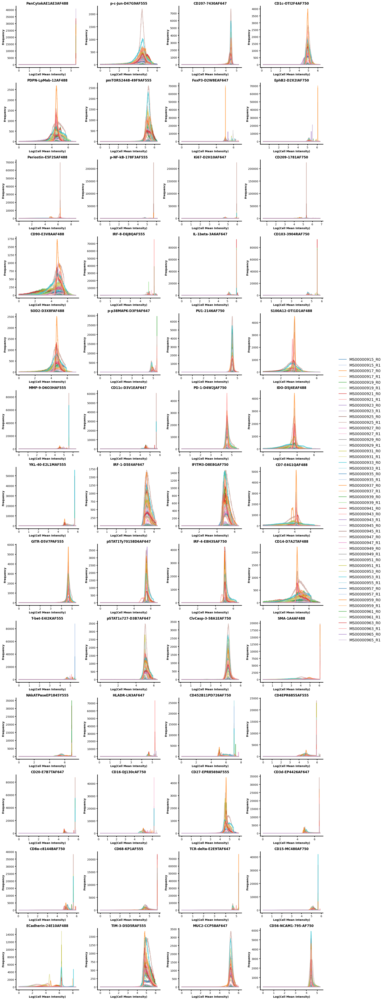

In [12]:
intensity_ranges, histograms, gmm_models = process_sample_distributions(
    feature_input       = adata,
    use_normalized      = True,
    num_bins            = 1024,
    plots_per_row       = 4,
    dpi                 = 100,
    xlims               = None,
    ylims               = None,
    output_figure_path  = "adata_feature_distributions_normalized.png",
    verbose=True
)

# check the normalized data

In [10]:
import pandas as pd

In [11]:
# extract as a dataframe
df_norm = pd.DataFrame(
    adata.layers["normalized"], 
    index=adata.obs_names, 
    columns=adata.var_names
)
print(df_norm.shape)

(3205629, 52)
